# 1. Data Exploration
for this study we will be using **AMOS dataset 2022**, which is downloaded from [here](https://zenodo.org/record/7155725#.Y0OOCOxBztM) and stored locally on the system.

The dataset which contains 500 CT and 100 MRI scans. The data is already split to train, validation and test set. Images with id less than 500 belongs to CT, else are MRI. The data used in this project will be CT scans only, and have been *manually separated* from the MRI scans.

After the manual work, we have **200 training data** and **100 validation data**. The data comes in *original* scans and **labeled** scans as this is originally intended for segmentation tasks.

In [1]:
import patoolib
import os
import nibabel as nib
import matplotlib.pyplot as plt
import sys
import numpy as np

In [2]:
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")
print(os.getcwd())
# os.listdir()

C:\Users\jsl3a\Desktop\MSc Project Dataset\nnUNet_raw\Dataset001_amosCT


## 1.1 Import and have a close look at the .nii.gz files
to have a first look at the scans

### 1.11 Using nibabel to show the slices of *training images*

In [3]:
#function to read nifti image files, for easy inspecting
# https://stackoverflow.com/questions/61833375/loading-a-nifti-through-nibabel-and-using-the-shape-function
def getScan(path):
    img = nib.load(path)
    nii_data = img.get_fdata()
    nii_aff  = img.affine
    nii_hdr  = img.header
#     print(nii_aff,'\n ------------------------------------\n',nii_hdr)
    return img, nii_data

In [4]:
#function to print slice, for inspecting nifti images
def printSlice(niidt):
    #the data we have is 3D
    if(len(niidt.shape)==3):
        for slice_Number in range(niidt.shape[2]):
            print("Slice number: ", slice_Number)
            plt.imshow(niidt[:,:,slice_Number ])
            plt.show()

In [8]:
img0001t, ndt0001t = getScan('imagesTr/amos_0001.nii.gz')
img0024t, ndt0024t = getScan('labelsTr/amos_0024.nii.gz')

In [9]:
print(ndt0001t.shape)
print(ndt0024t.shape)

(768, 768, 90)
(512, 512, 85)


the images are of varying shape `(768, 768, 90)` & `(512, 512, 85)`, with the last dimension being the thickness/number of slices in the each of the scan.

Slice number:  0


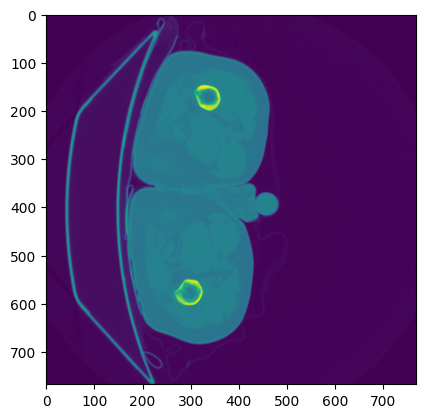

Slice number:  1


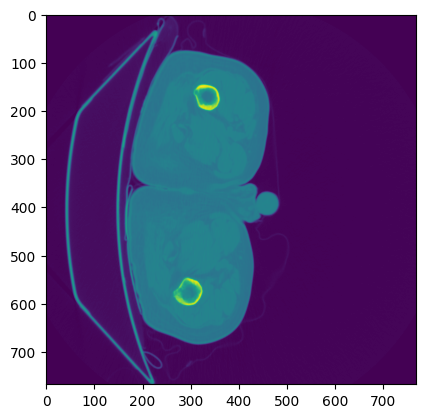

Slice number:  2


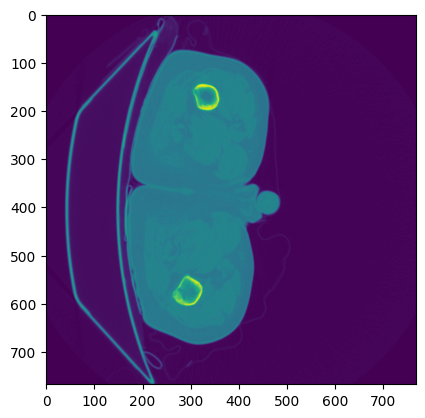

Slice number:  3


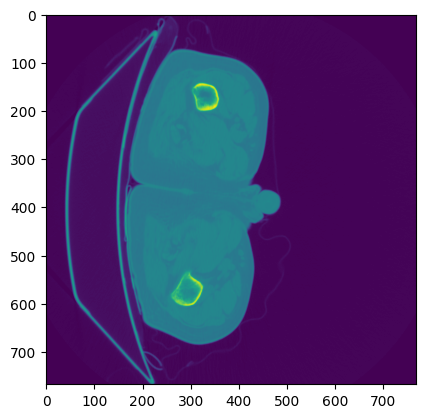

Slice number:  4


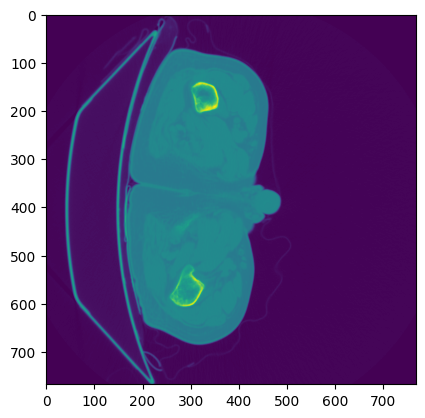

Slice number:  5


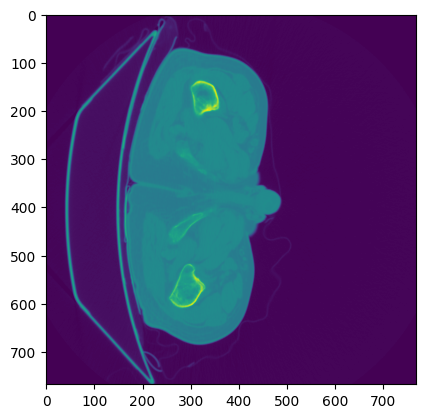

Slice number:  6


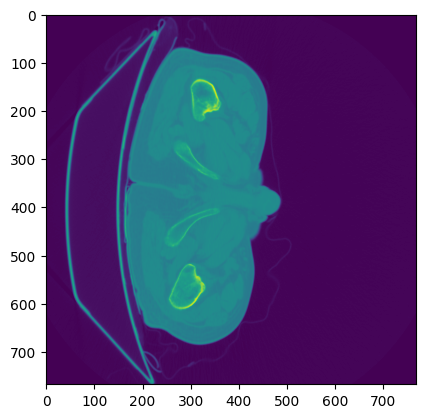

Slice number:  7


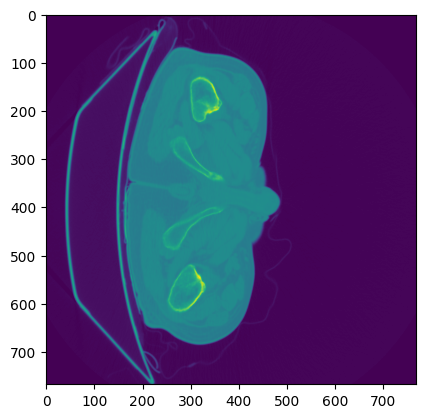

Slice number:  8


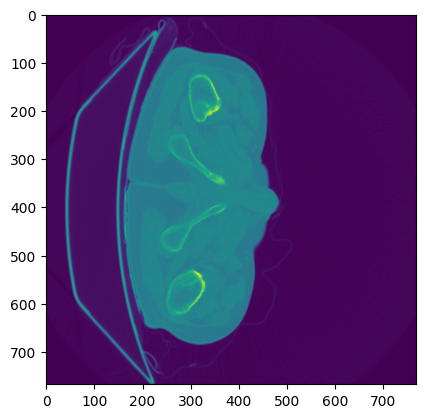

Slice number:  9


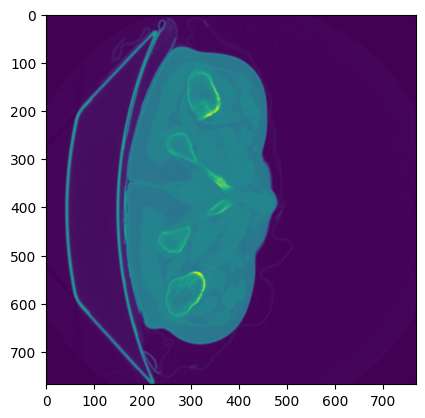

Slice number:  10


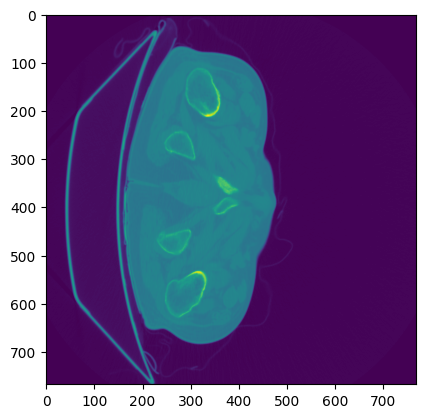

Slice number:  11


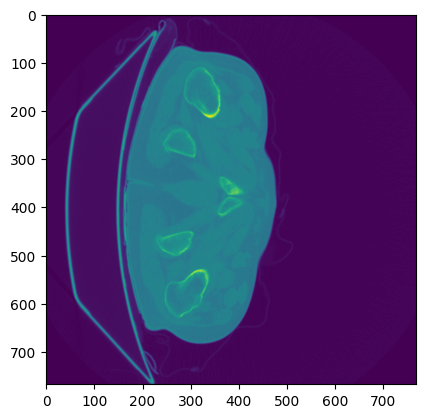

Slice number:  12


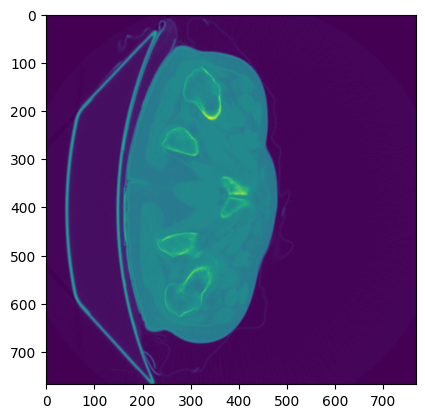

Slice number:  13


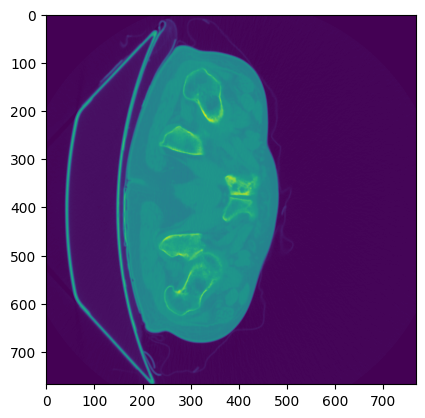

Slice number:  14


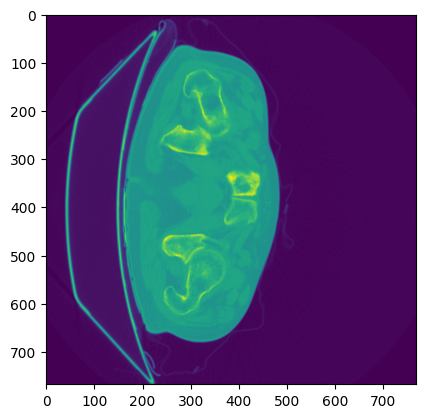

Slice number:  15


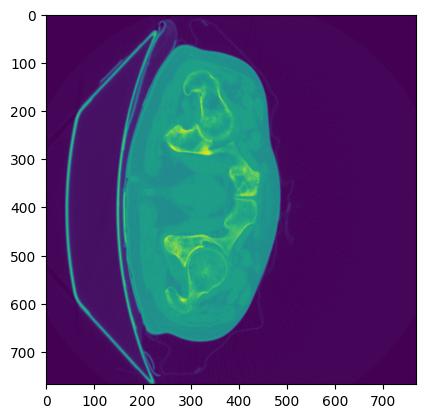

Slice number:  16


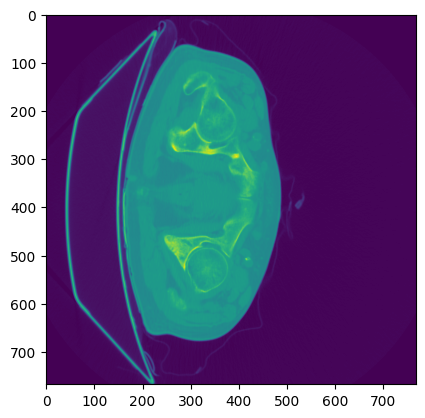

Slice number:  17


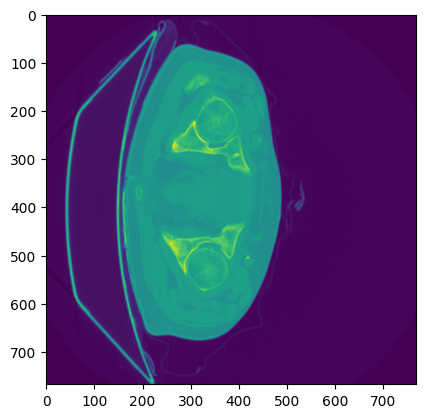

Slice number:  18


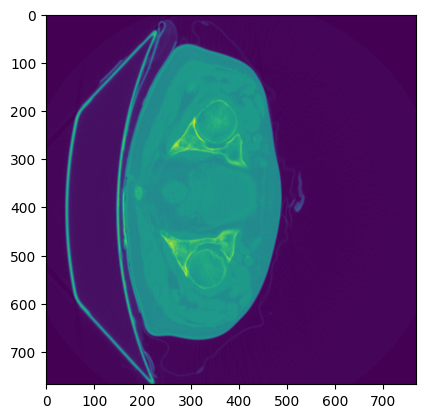

Slice number:  19


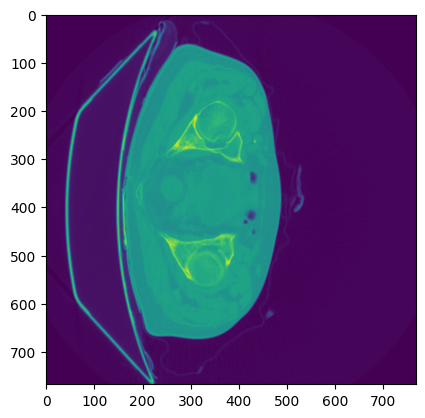

Slice number:  20


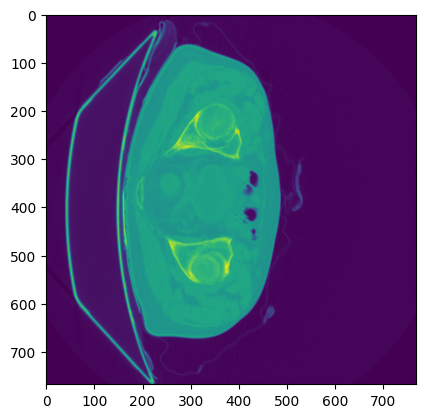

Slice number:  21


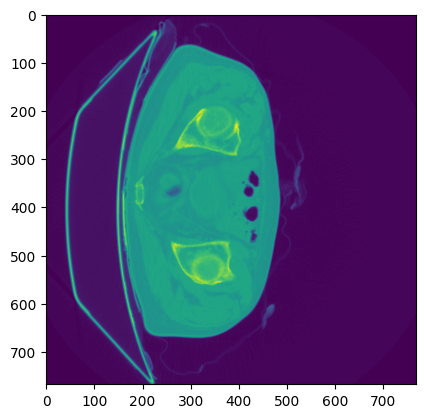

Slice number:  22


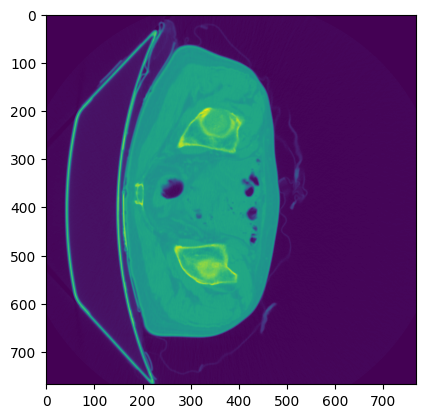

Slice number:  23


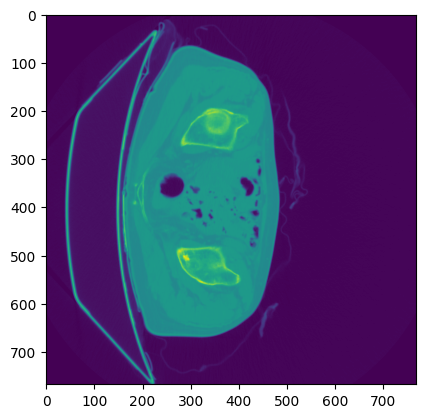

Slice number:  24


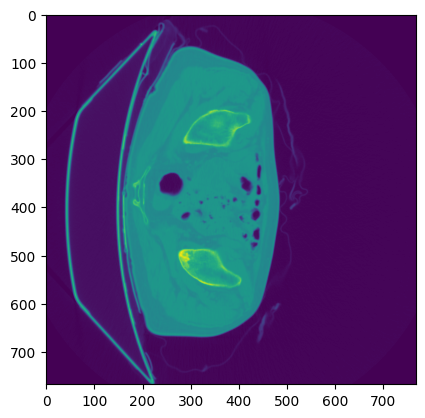

Slice number:  25


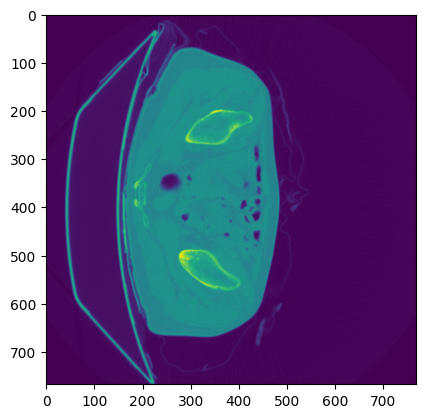

Slice number:  26


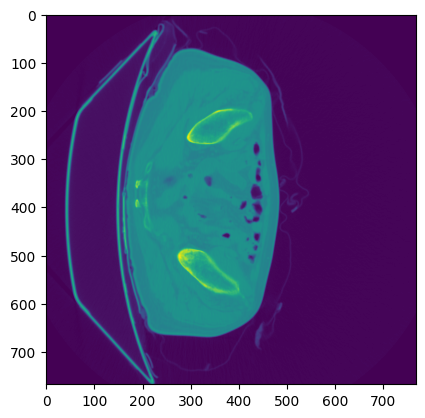

Slice number:  27


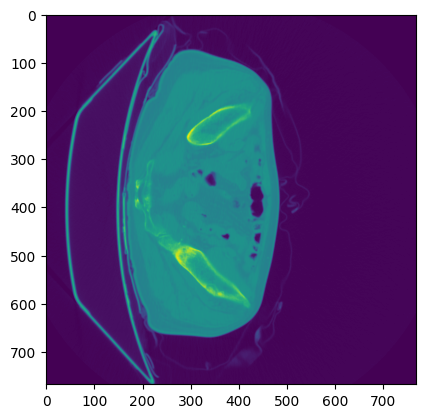

Slice number:  28


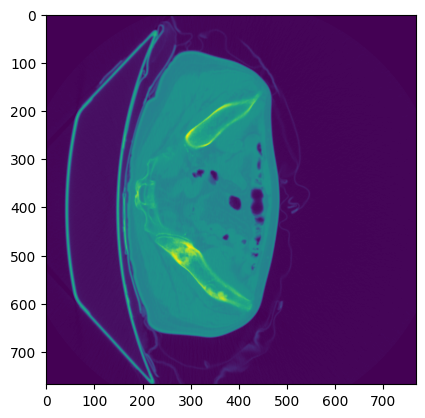

Slice number:  29


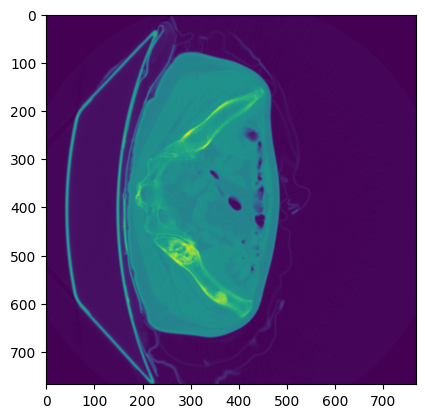

Slice number:  30


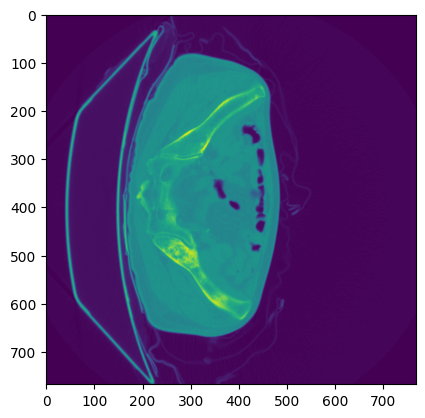

Slice number:  31


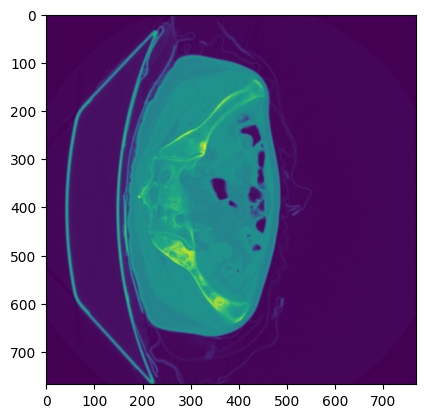

Slice number:  32


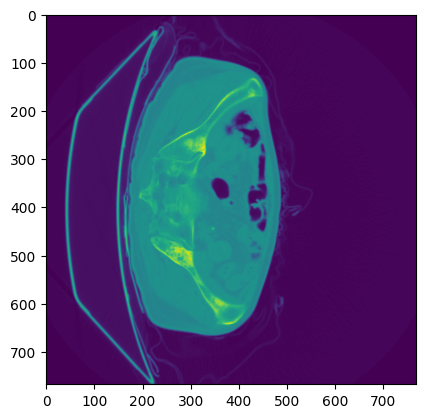

Slice number:  33


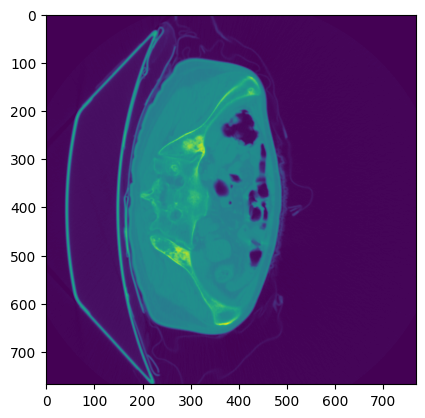

Slice number:  34


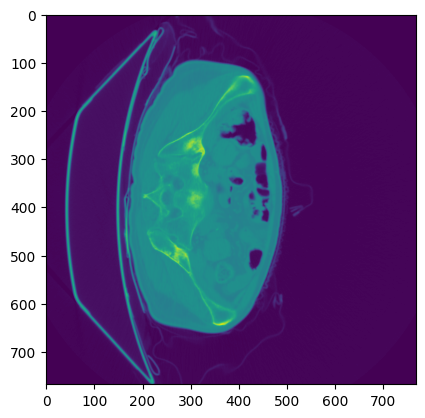

Slice number:  35


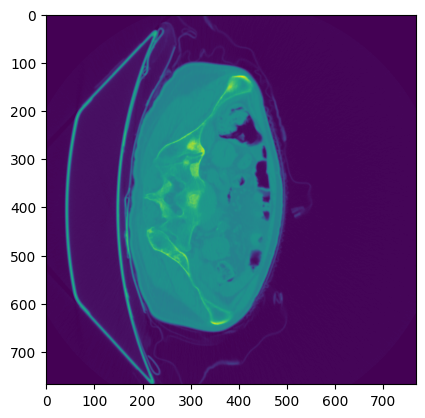

Slice number:  36


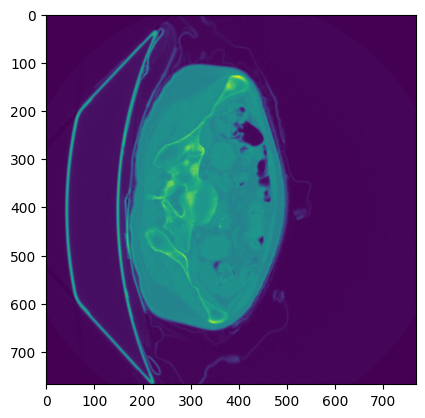

Slice number:  37


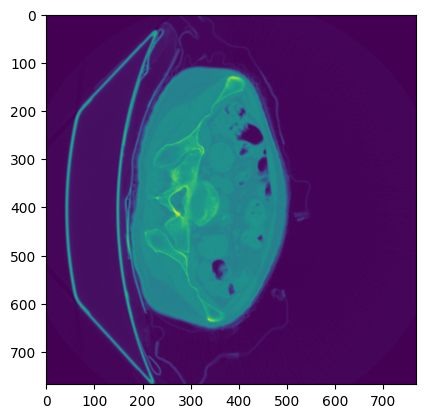

Slice number:  38


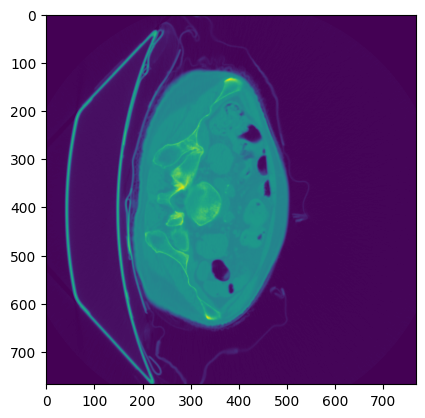

Slice number:  39


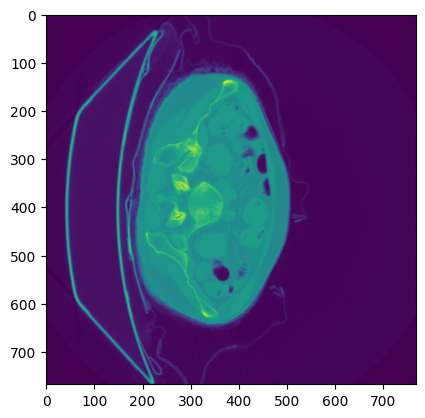

Slice number:  40


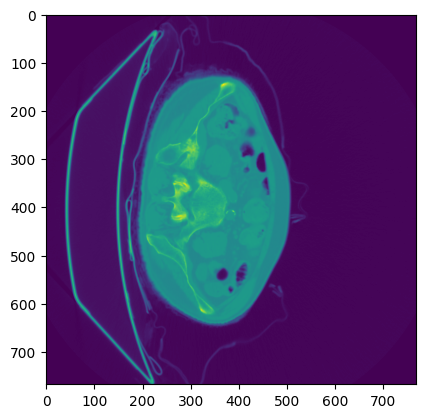

Slice number:  41


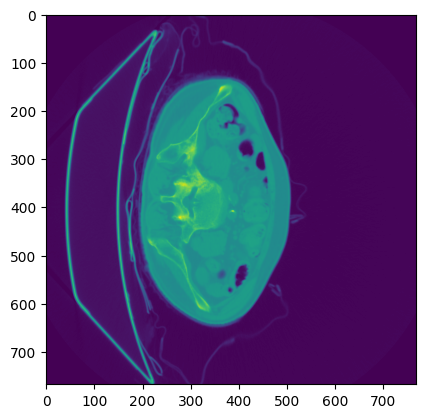

Slice number:  42


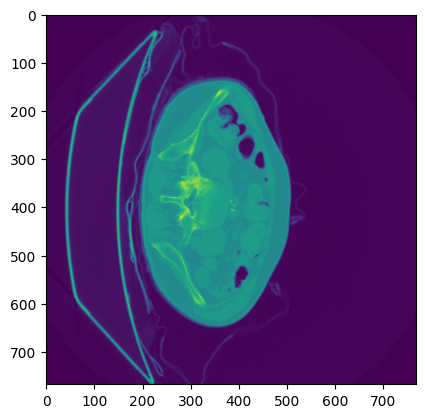

Slice number:  43


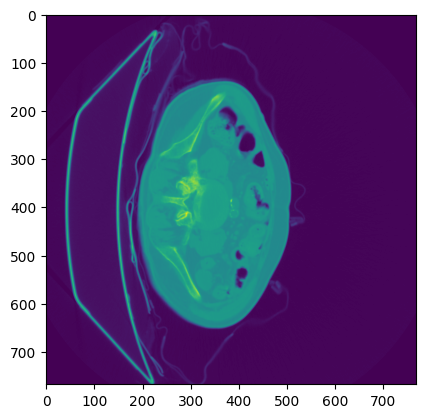

Slice number:  44


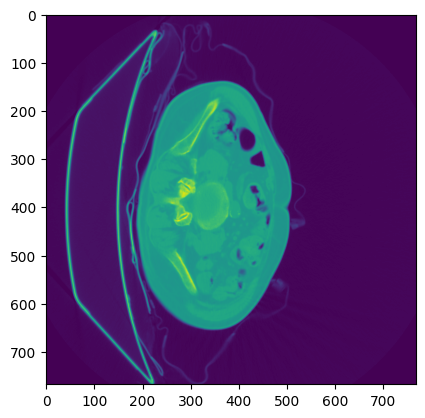

Slice number:  45


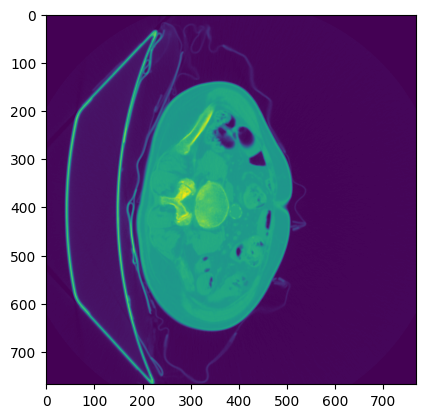

Slice number:  46


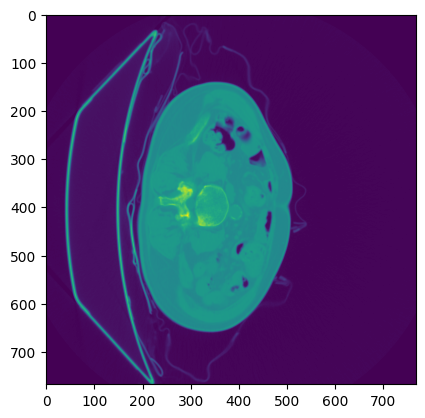

Slice number:  47


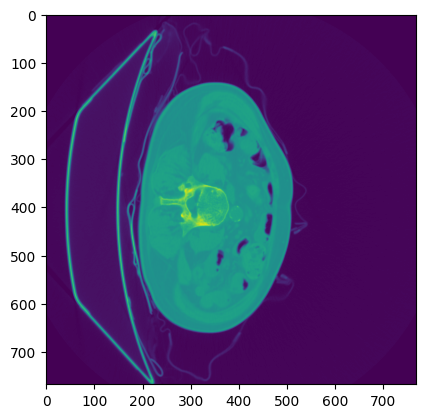

Slice number:  48


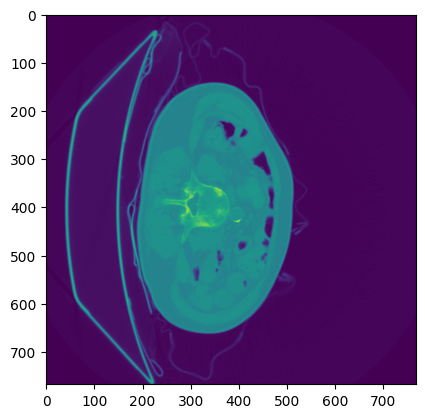

Slice number:  49


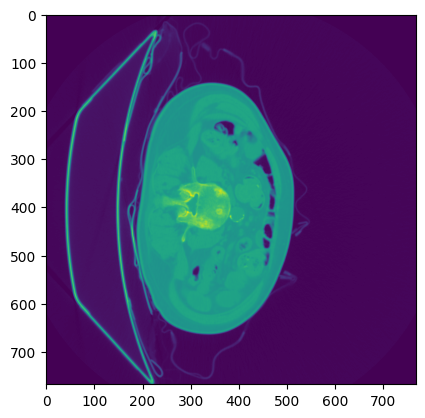

Slice number:  50


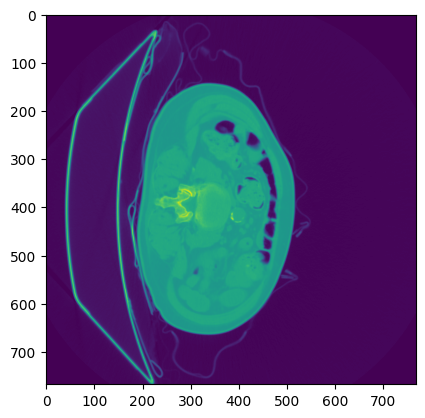

Slice number:  51


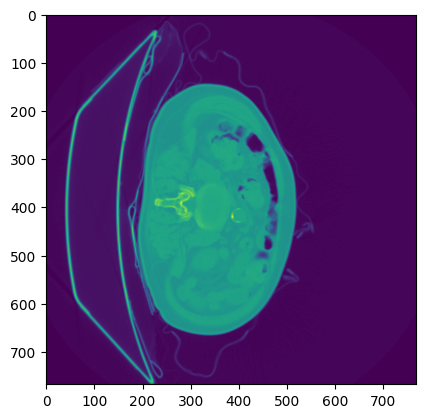

Slice number:  52


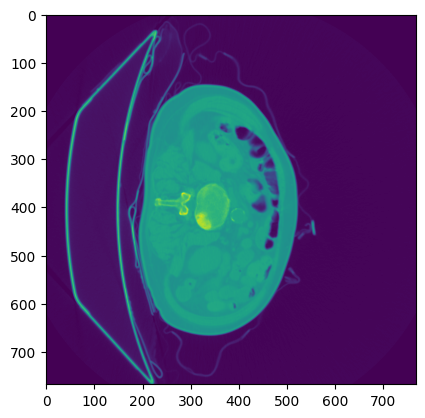

Slice number:  53


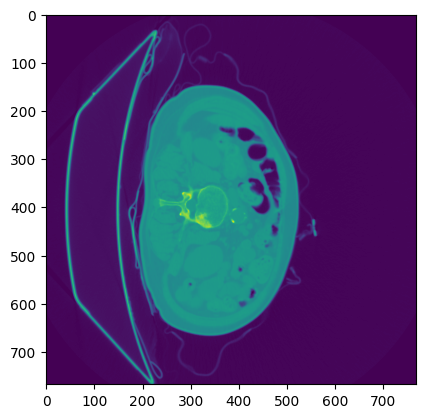

Slice number:  54


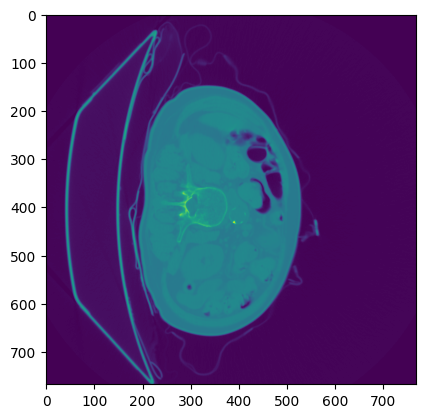

Slice number:  55


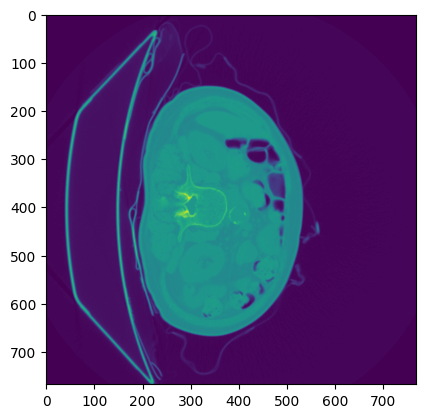

Slice number:  56


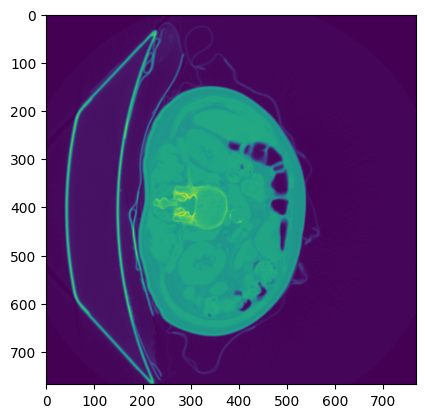

Slice number:  57


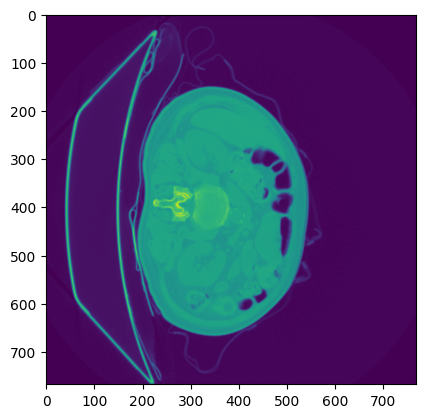

Slice number:  58


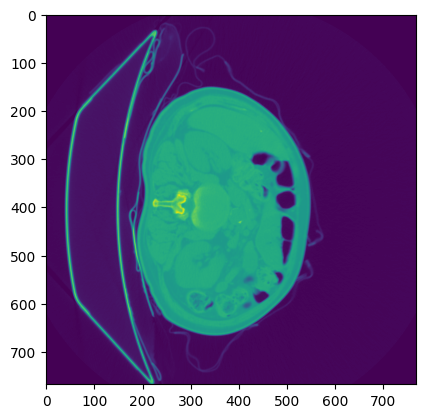

Slice number:  59


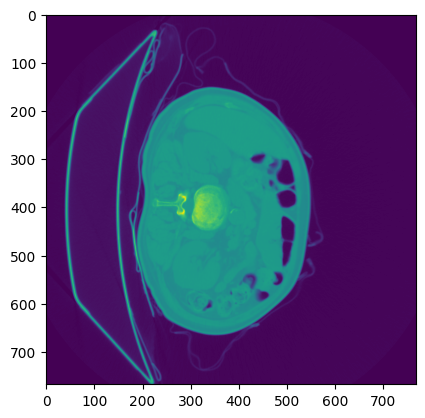

Slice number:  60


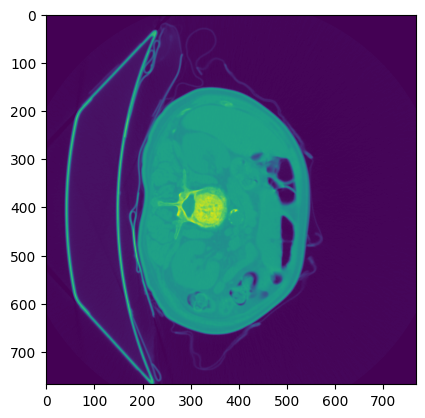

Slice number:  61


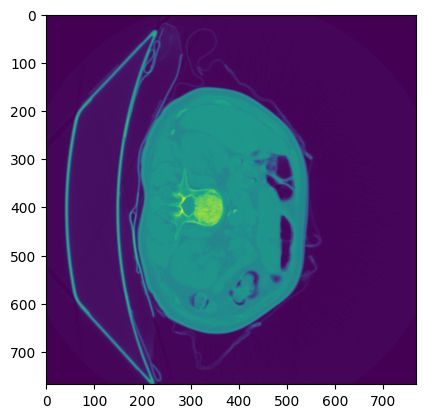

Slice number:  62


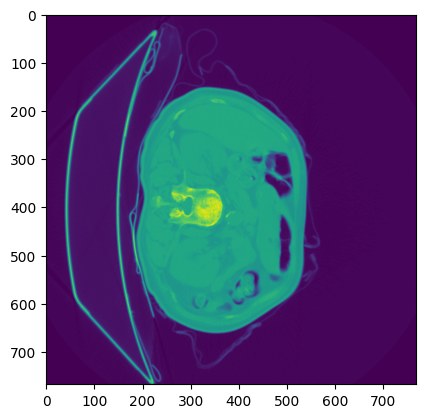

Slice number:  63


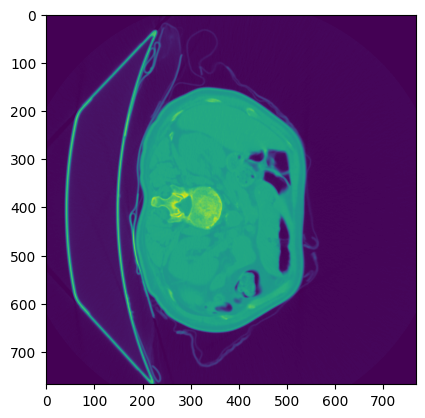

Slice number:  64


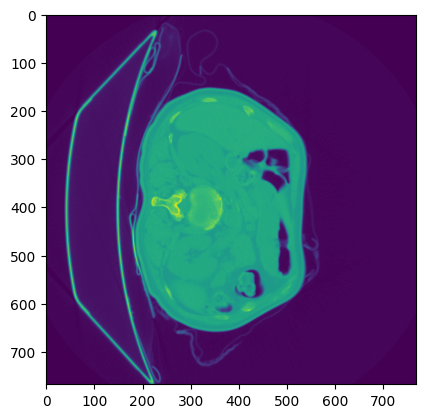

Slice number:  65


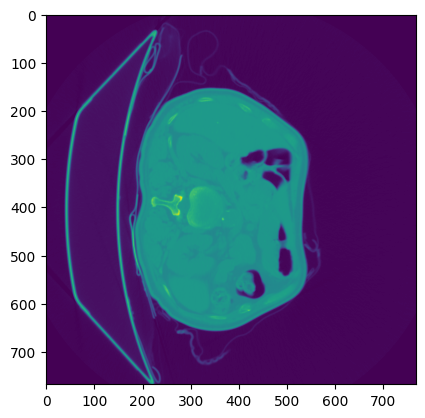

Slice number:  66


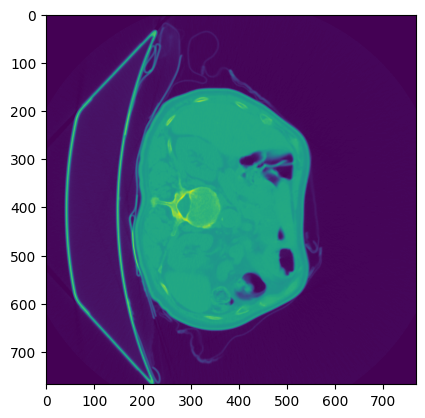

Slice number:  67


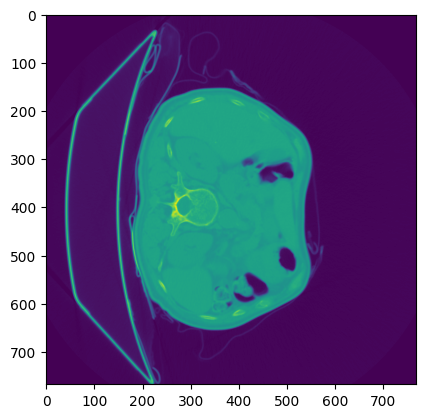

Slice number:  68


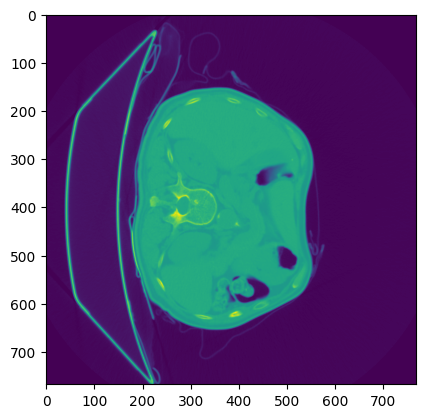

Slice number:  69


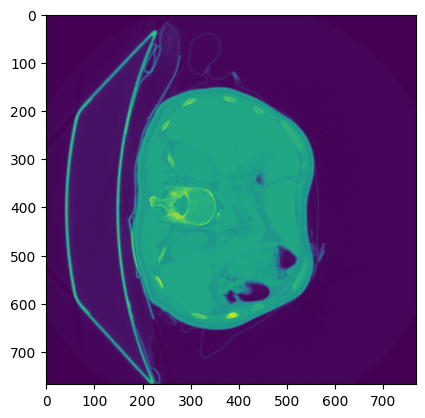

Slice number:  70


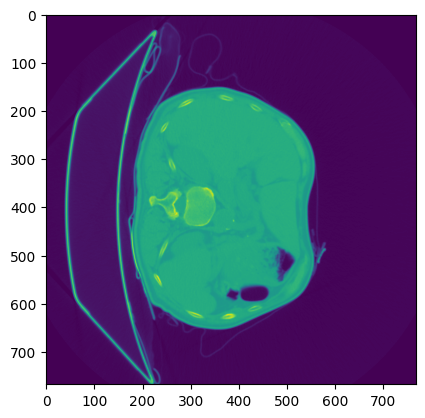

Slice number:  71


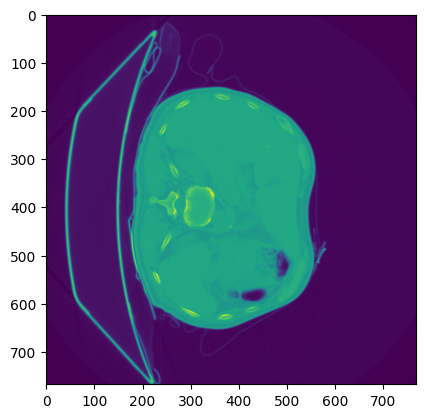

Slice number:  72


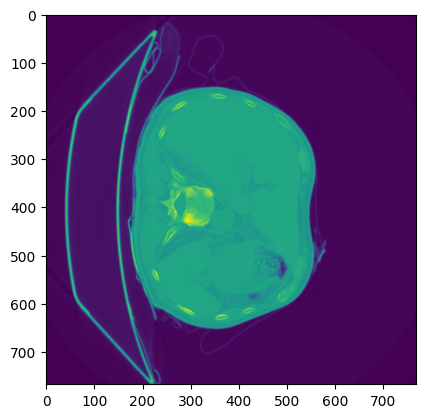

Slice number:  73


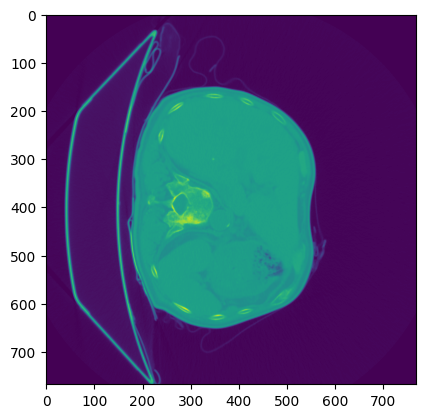

Slice number:  74


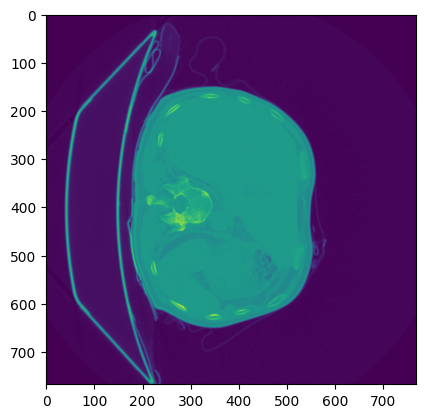

Slice number:  75


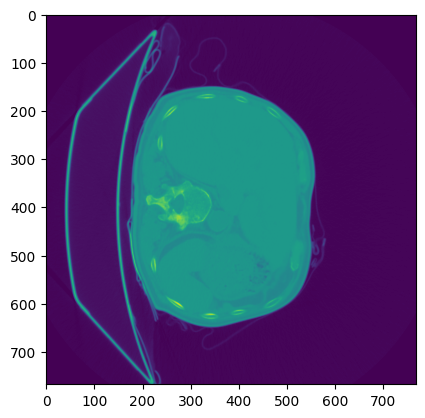

Slice number:  76


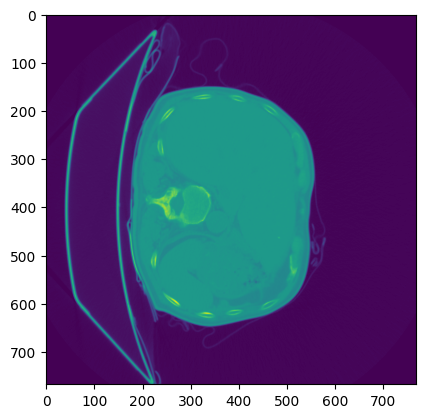

Slice number:  77


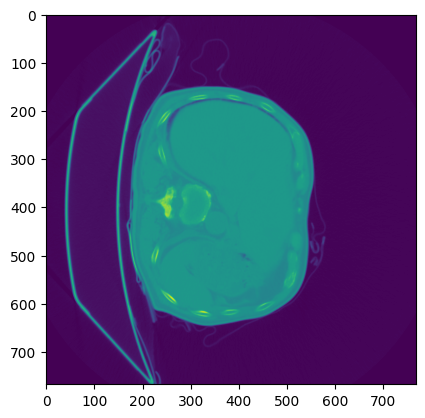

Slice number:  78


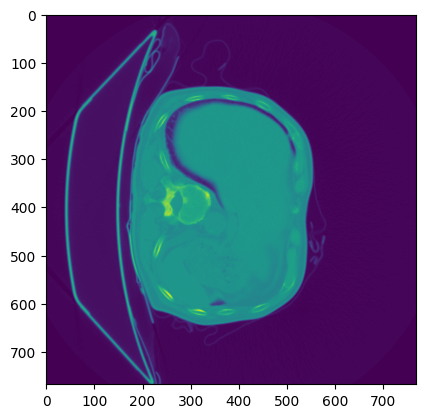

Slice number:  79


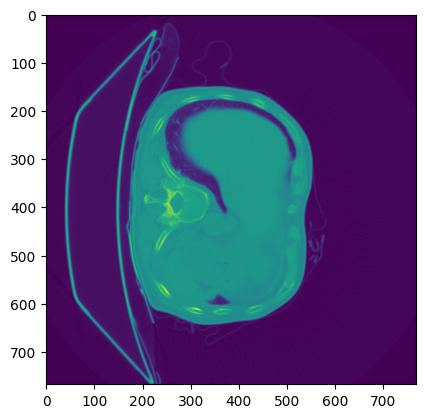

Slice number:  80


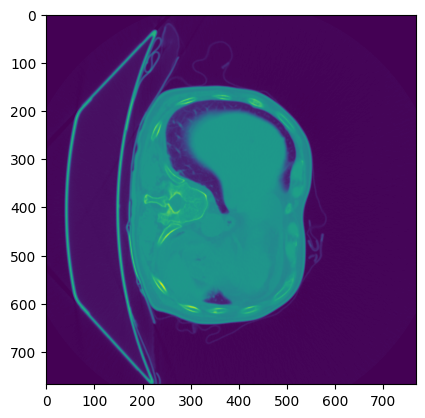

Slice number:  81


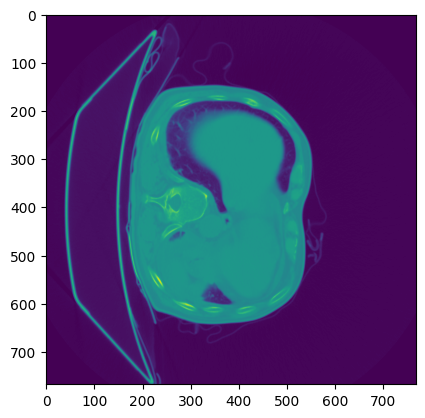

Slice number:  82


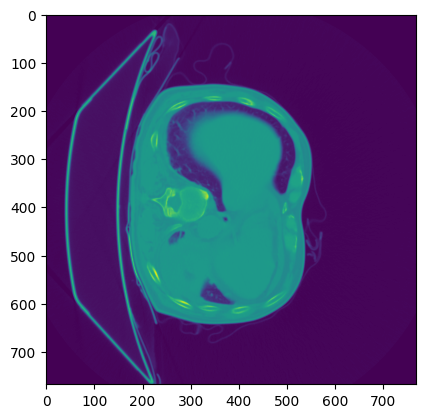

Slice number:  83


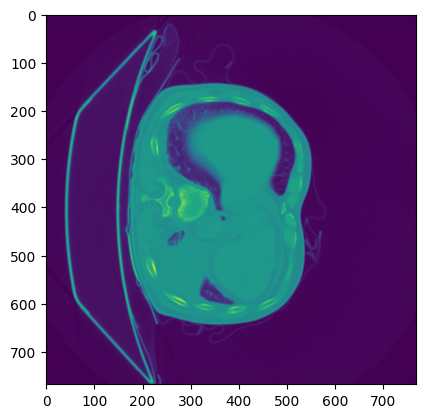

Slice number:  84


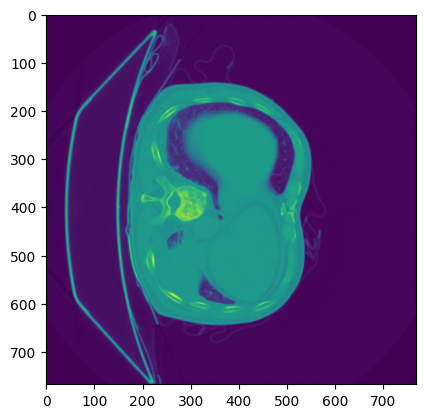

Slice number:  85


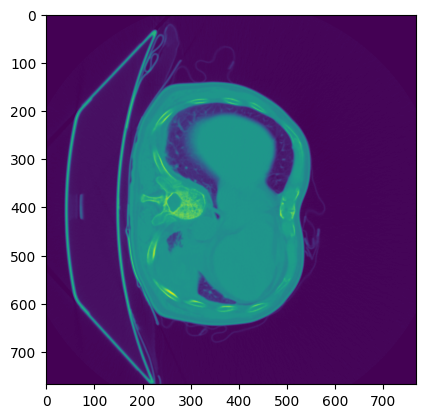

Slice number:  86


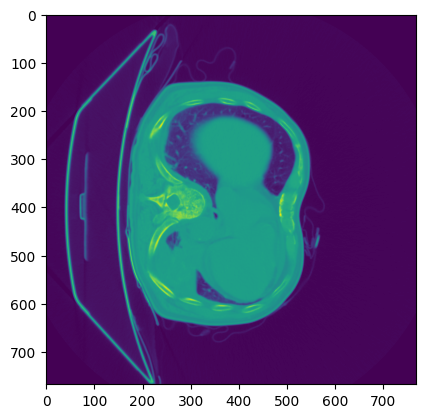

Slice number:  87


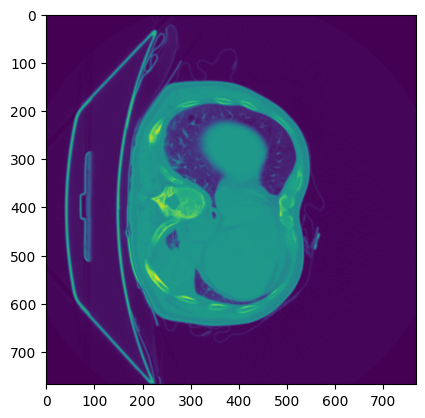

Slice number:  88


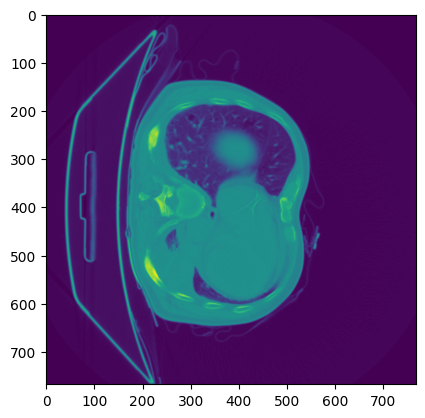

Slice number:  89


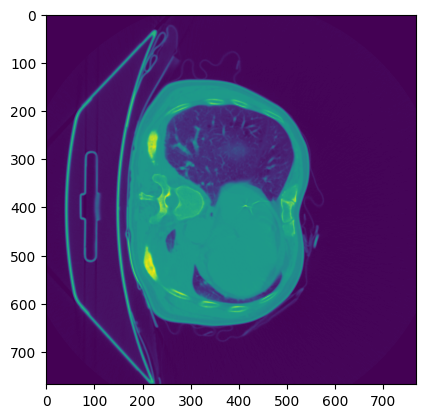

In [9]:
printSlice(ndt0001t)

CT scans shows bones more than organs, but luckily the images came **labeled**. we can view the segmented organs in different color from the labeled images below:

### 1.12 Using nibabel to show the slices of *training label*

lets see shapes of all the nifti images:

In [10]:
img0001l, ndt0001l = getScan('labelsTr/amos_0001.nii.gz')
img0024l, ndt0024l = getScan('labelsTr/amos_0024.nii.gz')

Slice number:  0


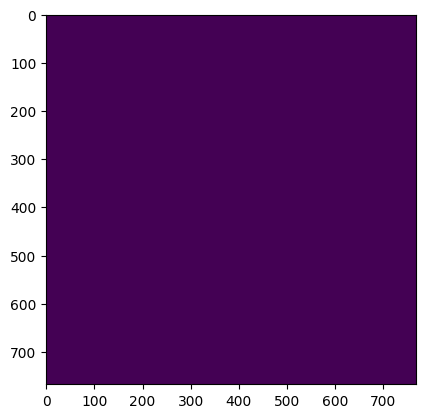

Slice number:  1


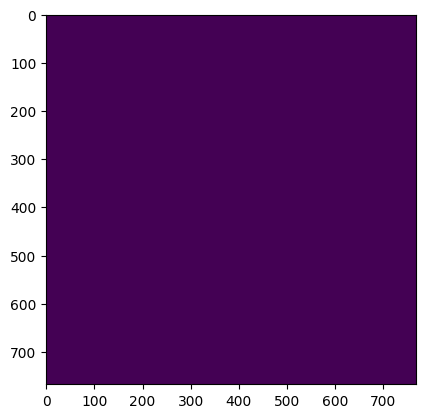

Slice number:  2


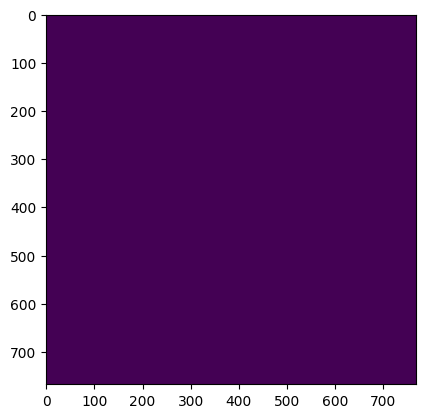

Slice number:  3


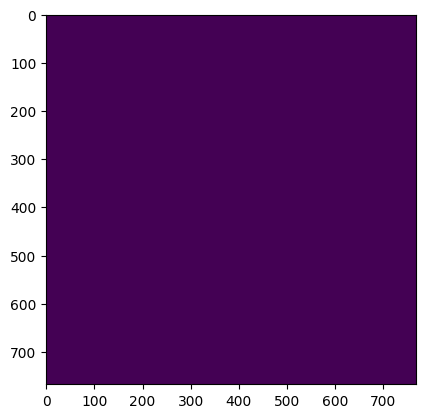

Slice number:  4


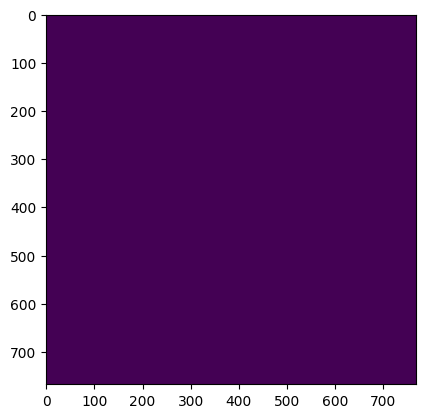

Slice number:  5


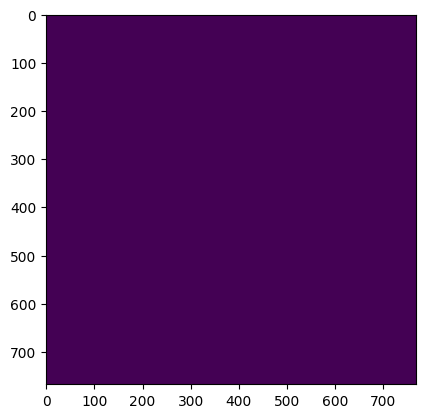

Slice number:  6


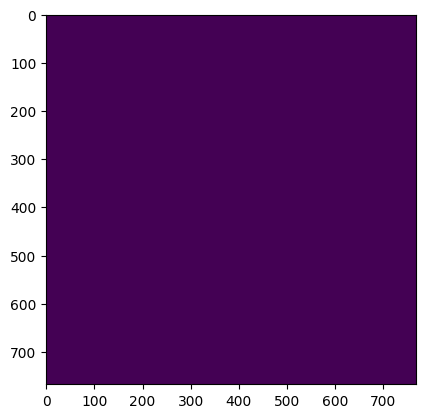

Slice number:  7


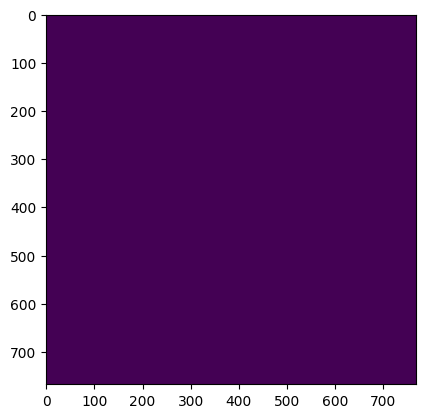

Slice number:  8


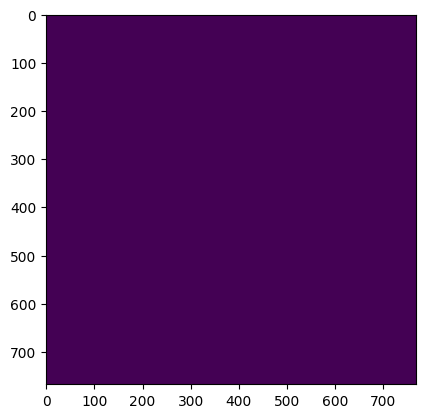

Slice number:  9


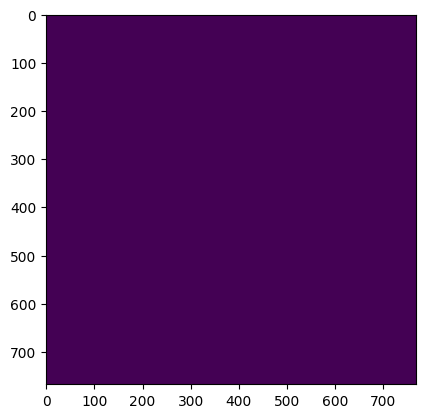

Slice number:  10


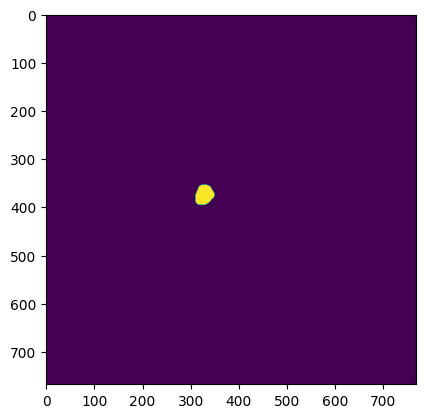

Slice number:  11


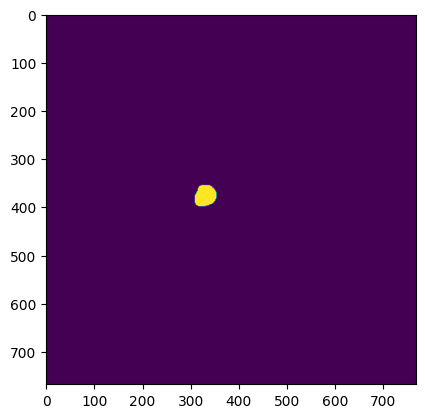

Slice number:  12


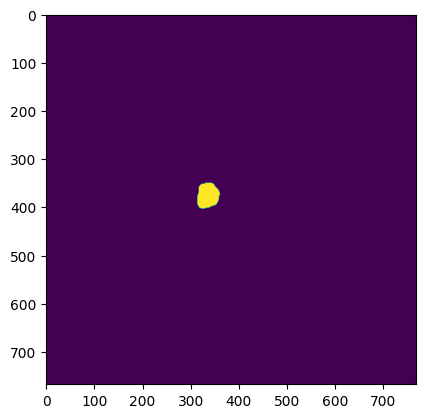

Slice number:  13


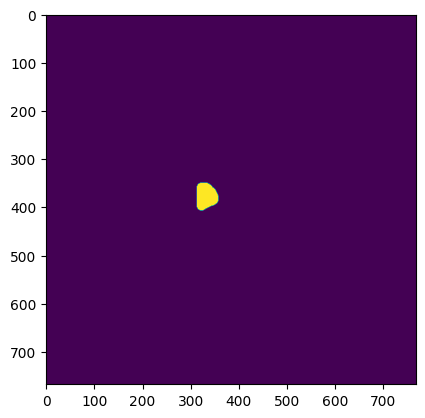

Slice number:  14


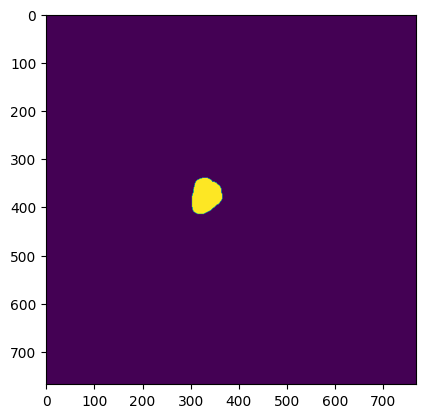

Slice number:  15


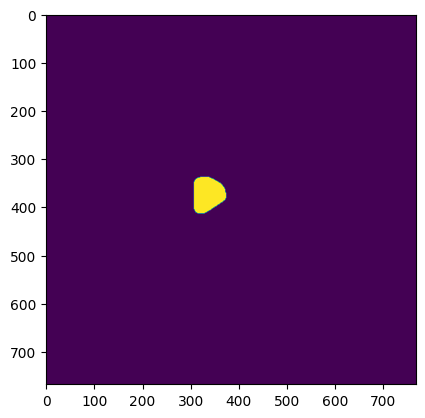

Slice number:  16


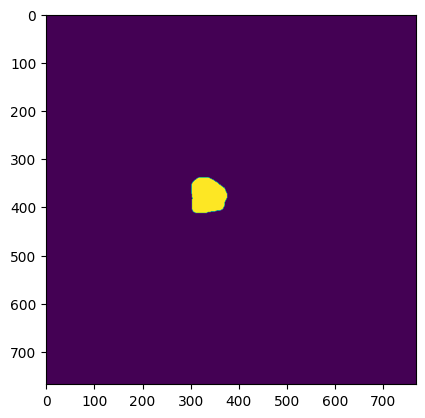

Slice number:  17


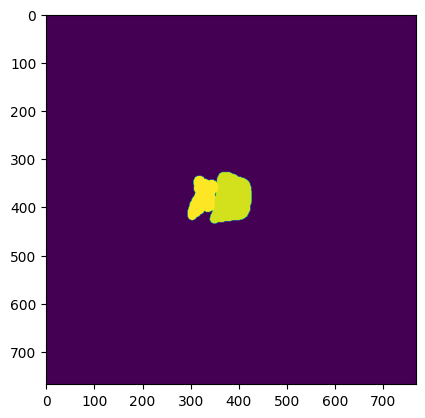

Slice number:  18


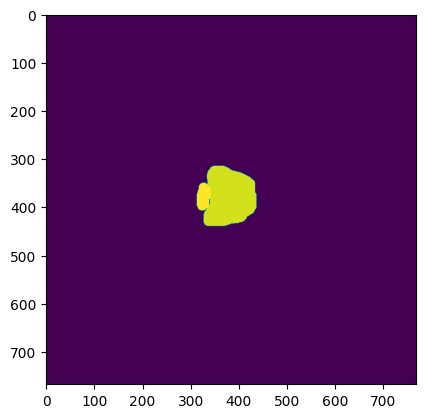

Slice number:  19


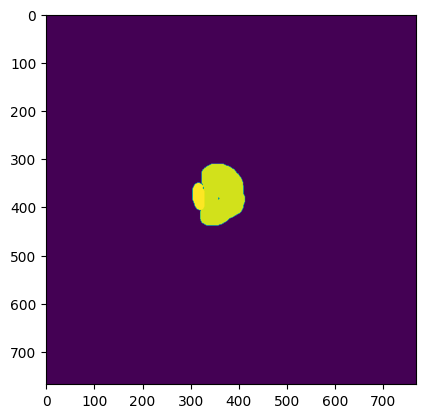

Slice number:  20


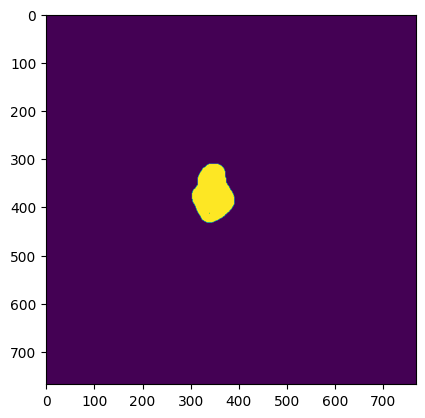

Slice number:  21


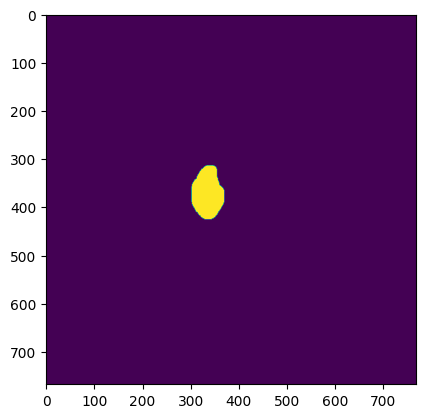

Slice number:  22


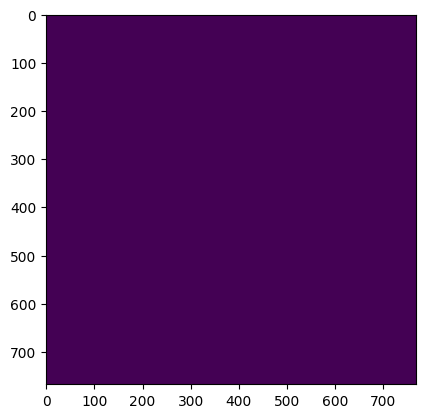

Slice number:  23


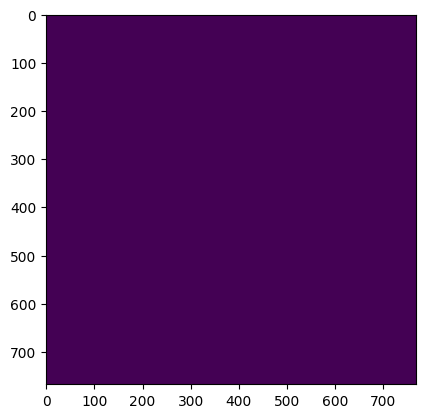

Slice number:  24


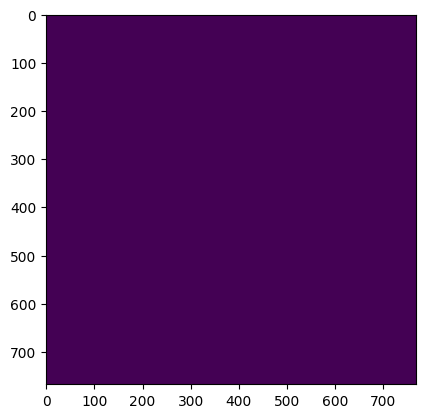

Slice number:  25


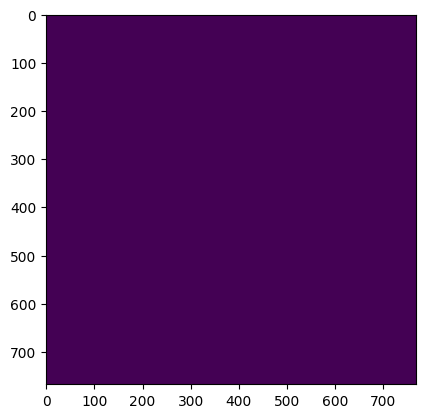

Slice number:  26


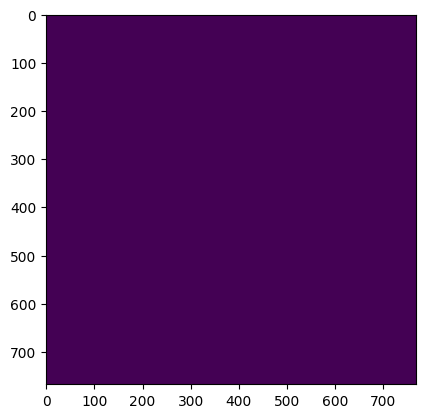

Slice number:  27


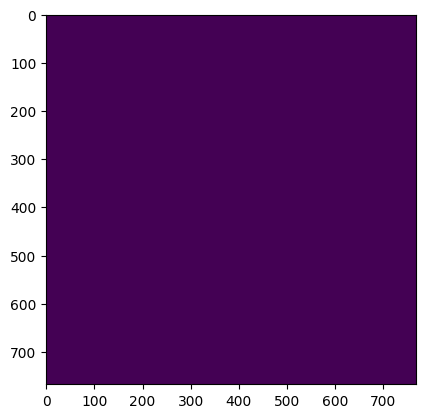

Slice number:  28


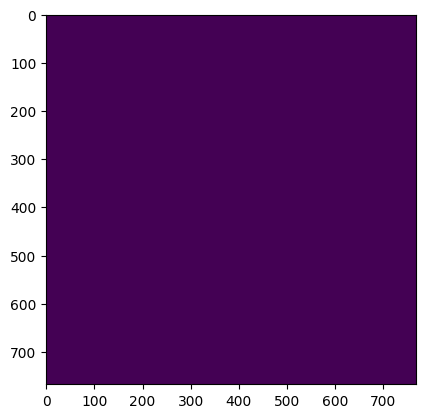

Slice number:  29


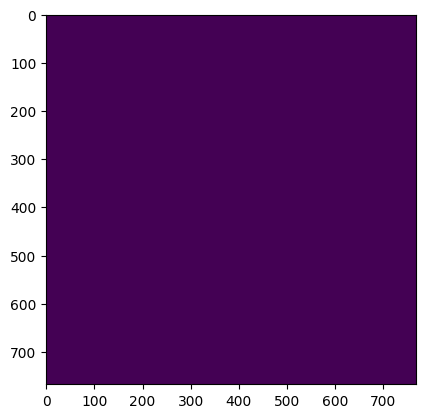

Slice number:  30


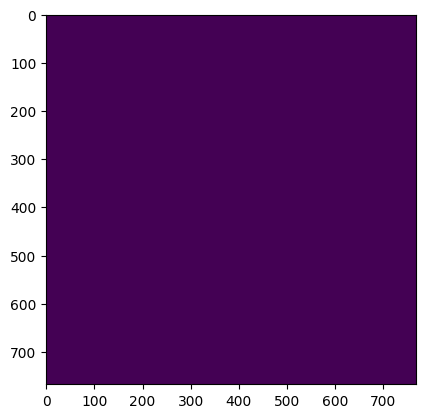

Slice number:  31


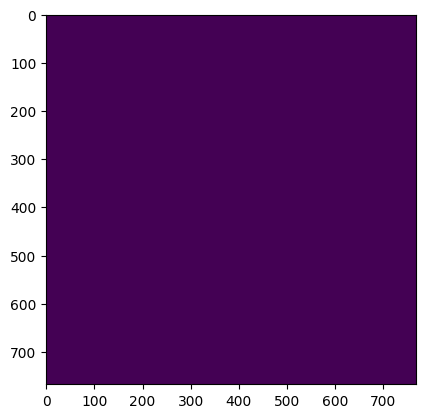

Slice number:  32


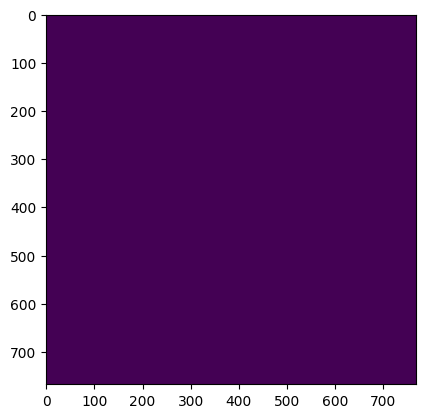

Slice number:  33


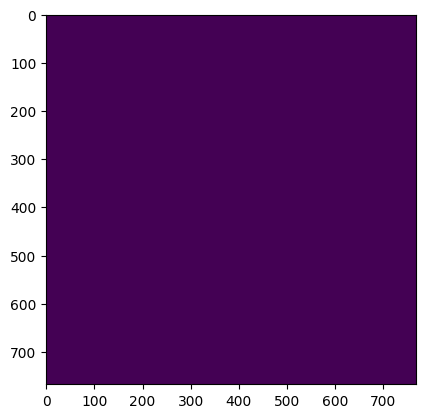

Slice number:  34


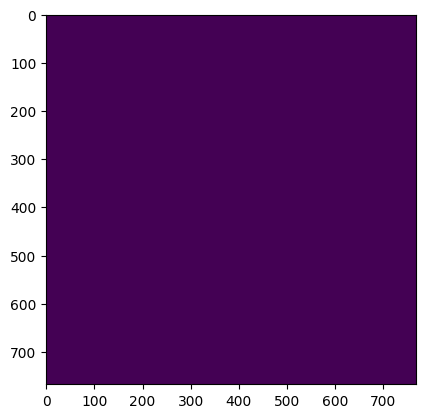

Slice number:  35


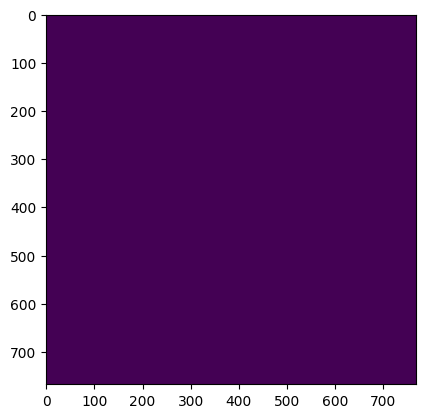

Slice number:  36


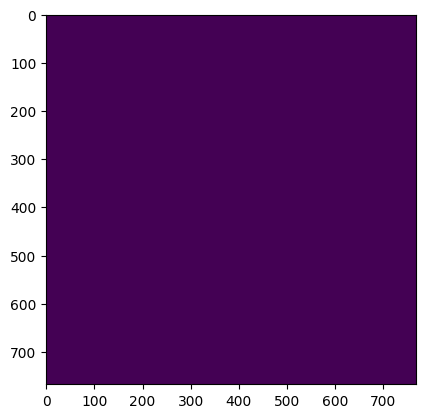

Slice number:  37


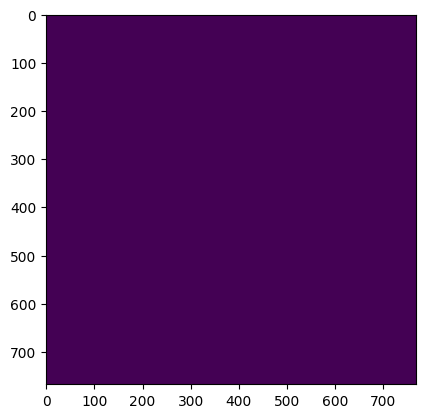

Slice number:  38


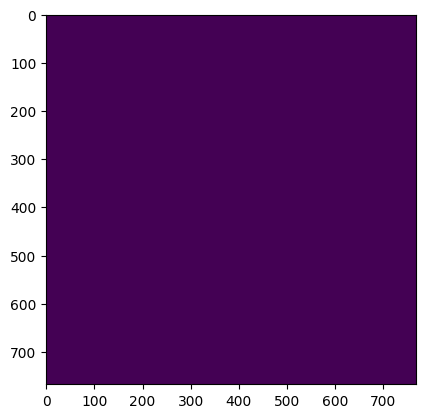

Slice number:  39


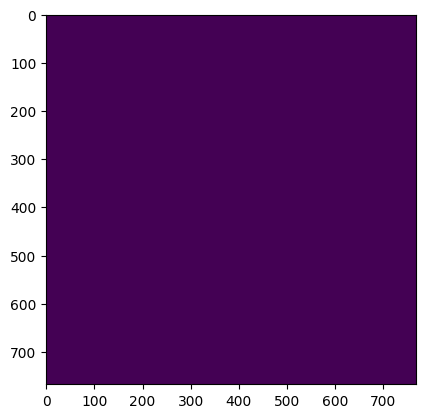

Slice number:  40


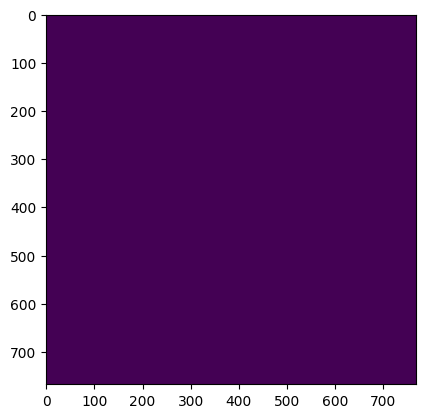

Slice number:  41


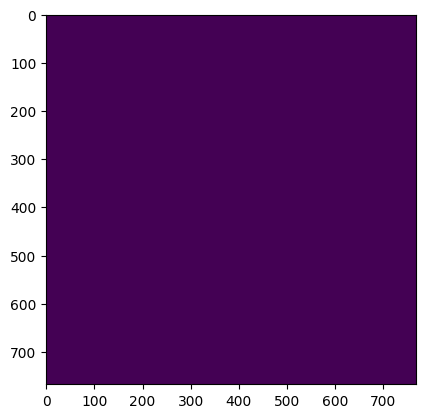

Slice number:  42


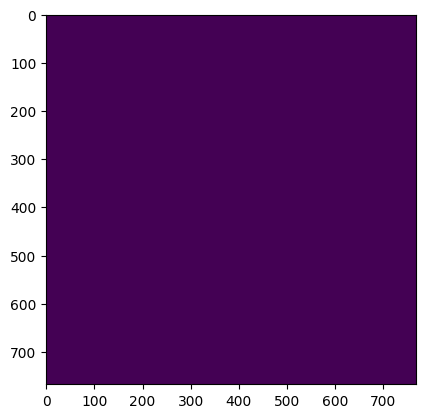

Slice number:  43


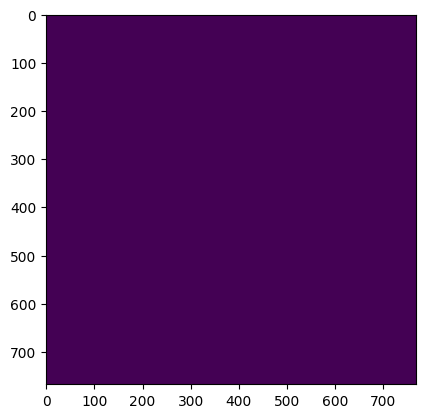

Slice number:  44


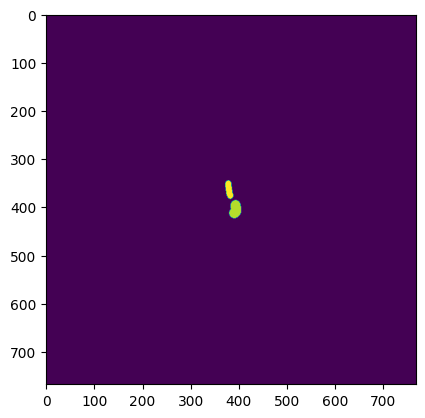

Slice number:  45


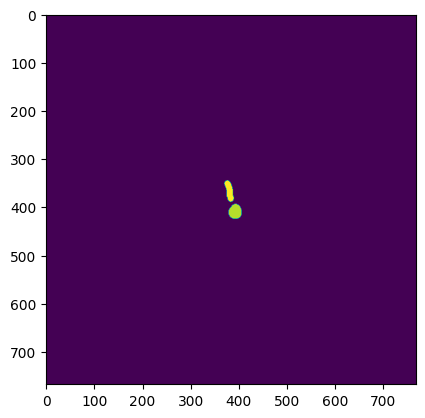

Slice number:  46


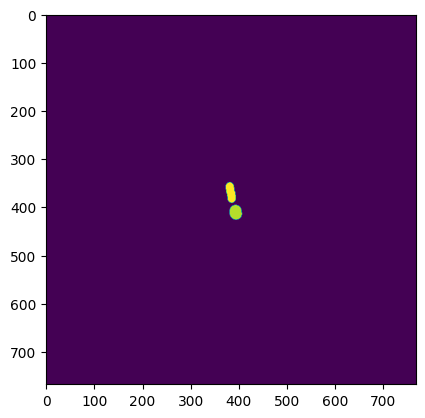

Slice number:  47


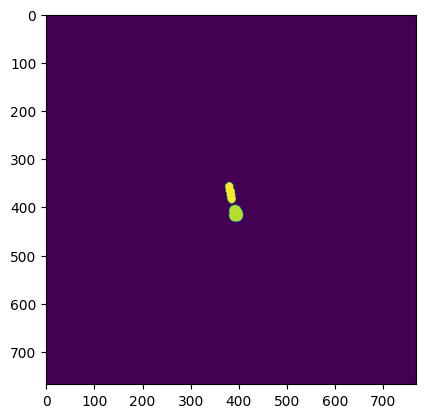

Slice number:  48


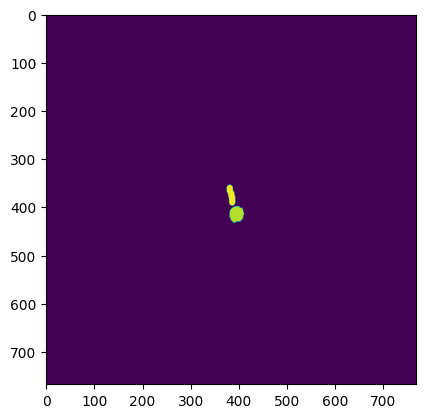

Slice number:  49


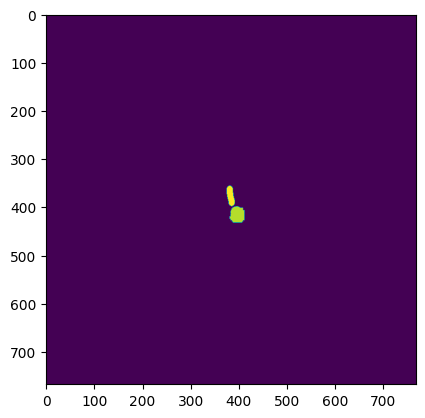

Slice number:  50


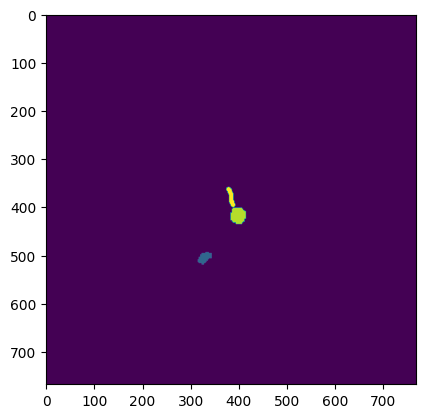

Slice number:  51


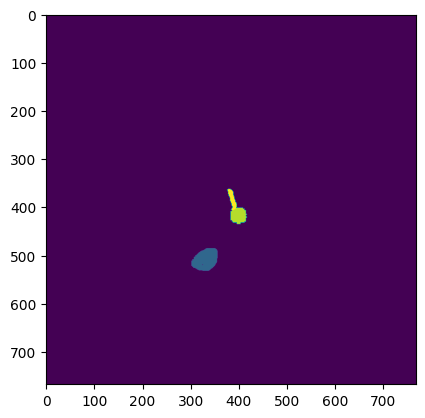

Slice number:  52


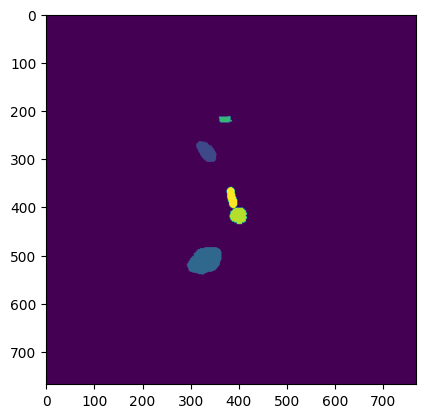

Slice number:  53


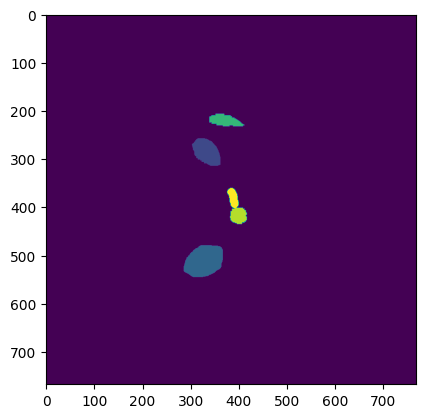

Slice number:  54


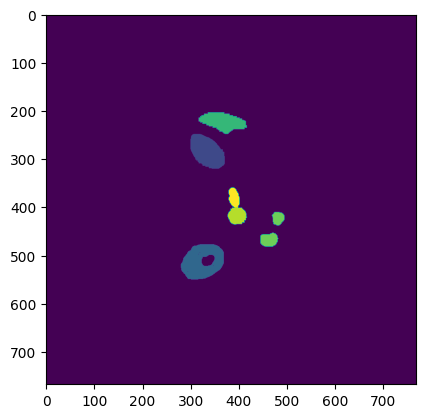

Slice number:  55


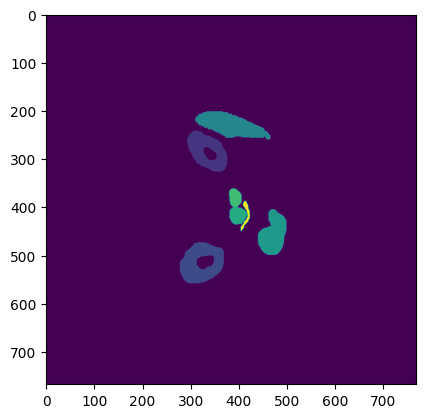

Slice number:  56


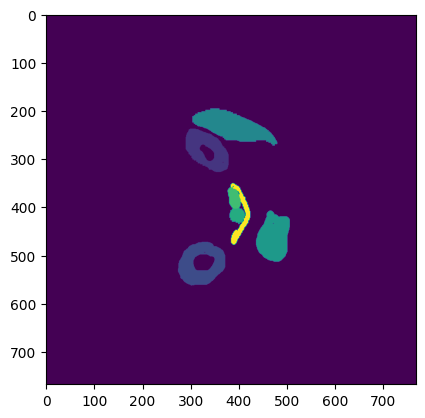

Slice number:  57


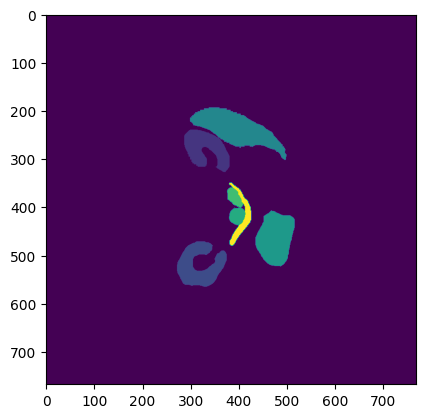

Slice number:  58


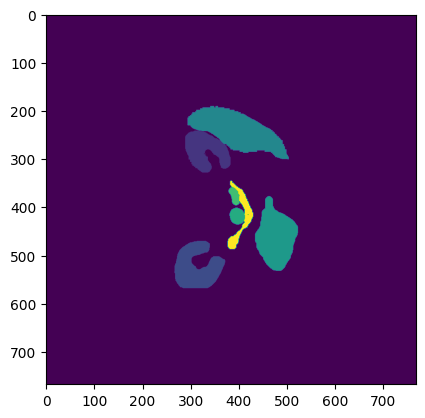

Slice number:  59


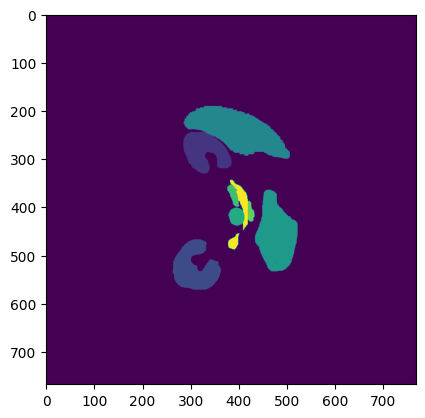

Slice number:  60


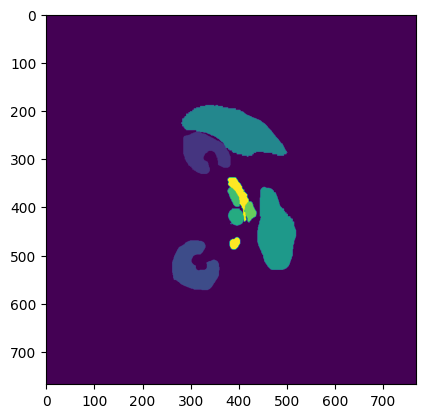

Slice number:  61


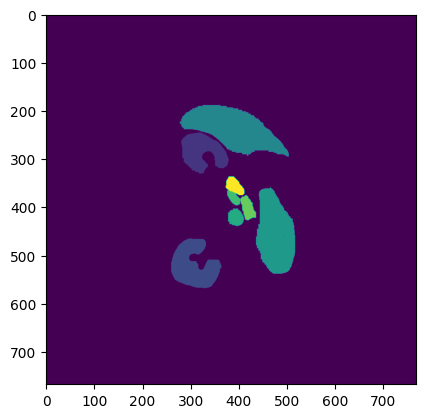

Slice number:  62


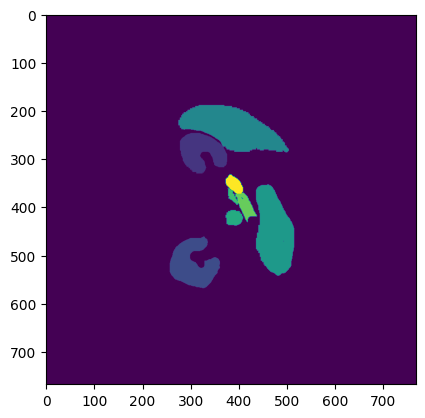

Slice number:  63


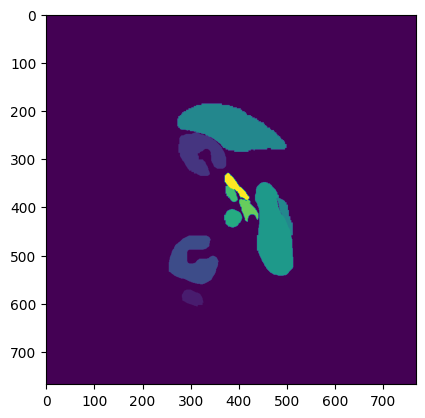

Slice number:  64


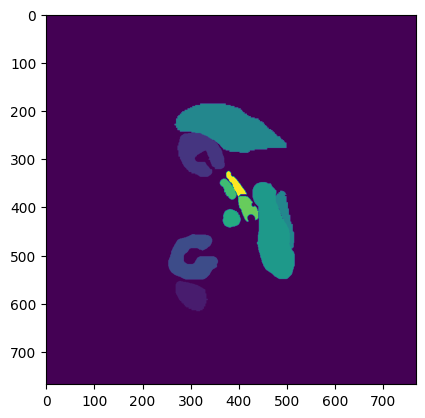

Slice number:  65


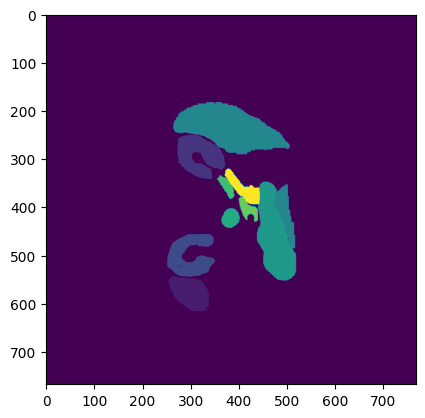

Slice number:  66


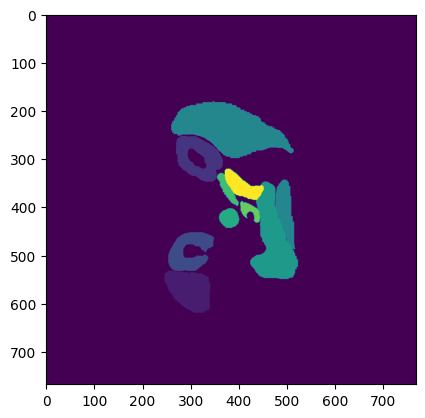

Slice number:  67


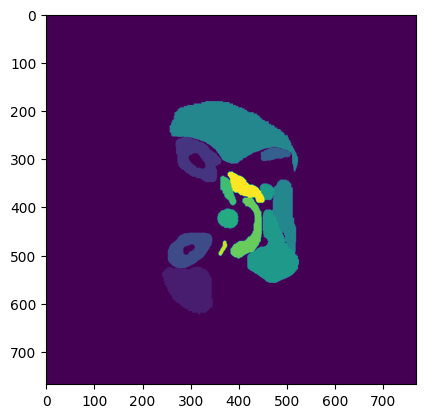

Slice number:  68


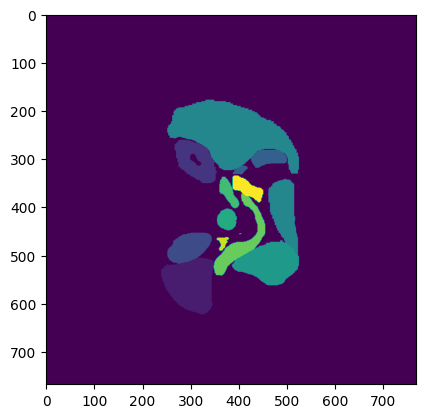

Slice number:  69


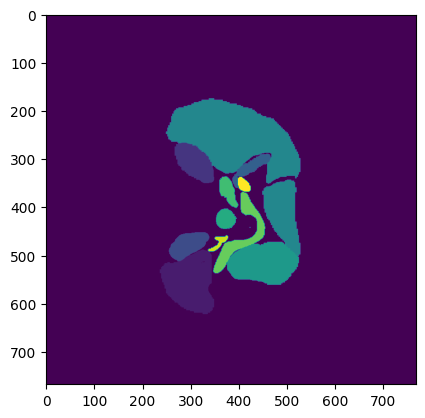

Slice number:  70


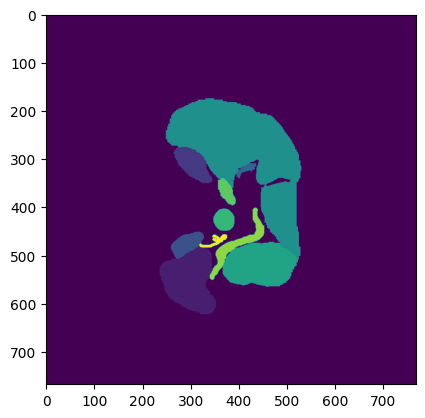

Slice number:  71


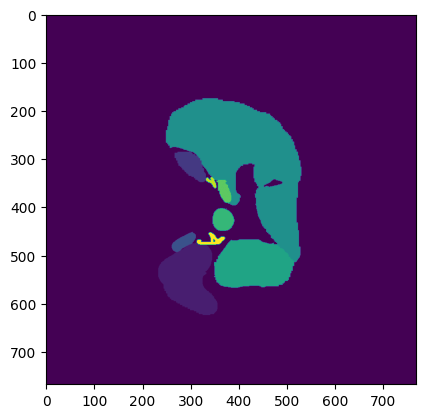

Slice number:  72


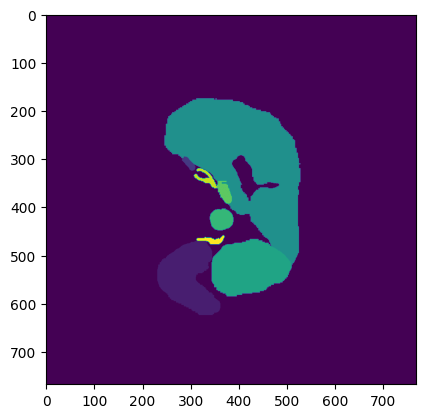

Slice number:  73


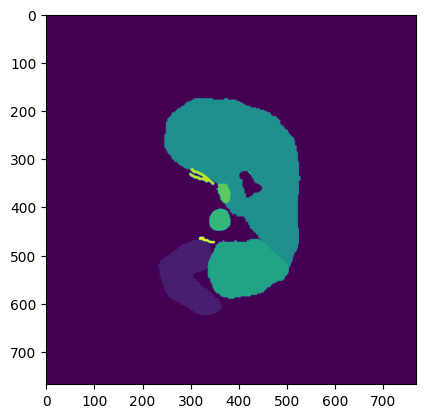

Slice number:  74


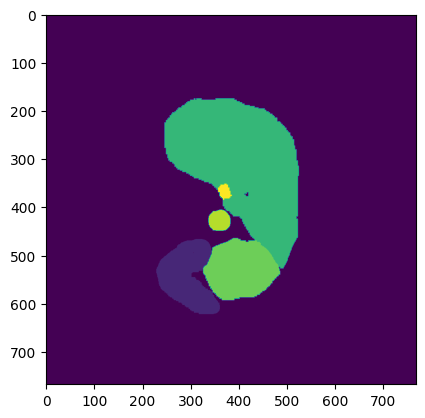

Slice number:  75


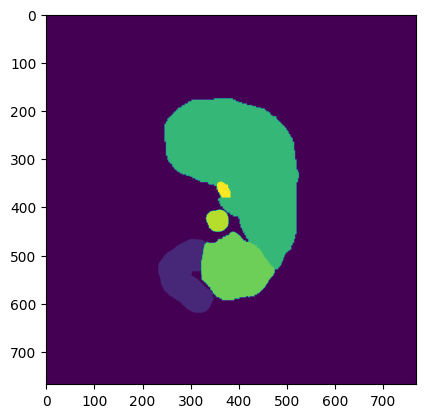

Slice number:  76


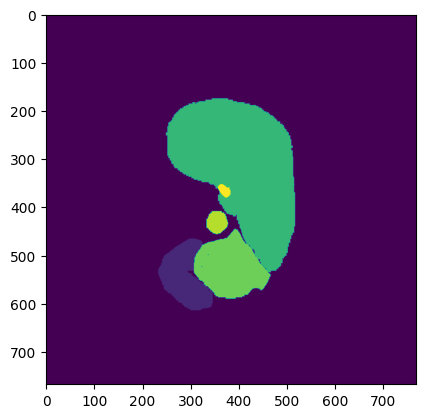

Slice number:  77


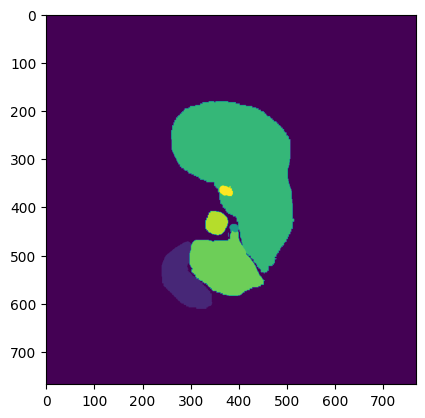

Slice number:  78


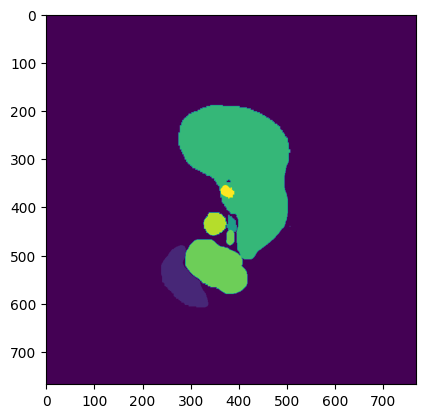

Slice number:  79


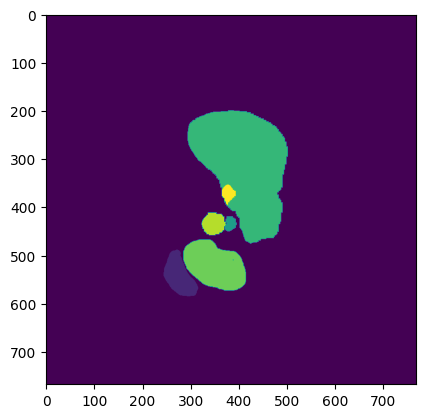

Slice number:  80


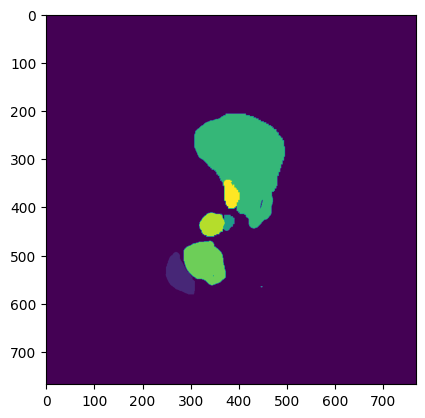

Slice number:  81


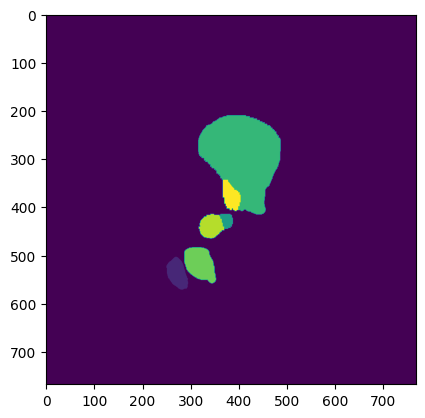

Slice number:  82


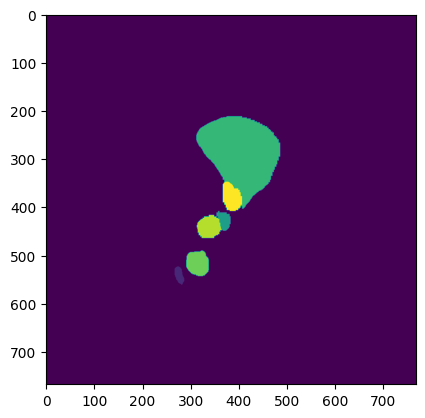

Slice number:  83


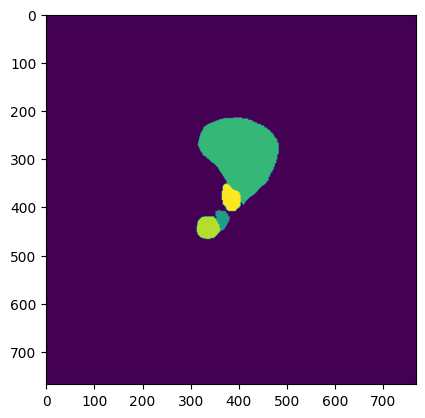

Slice number:  84


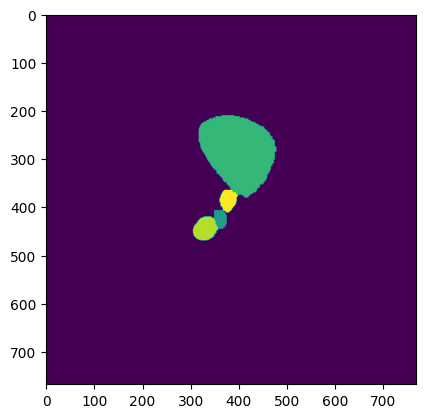

Slice number:  85


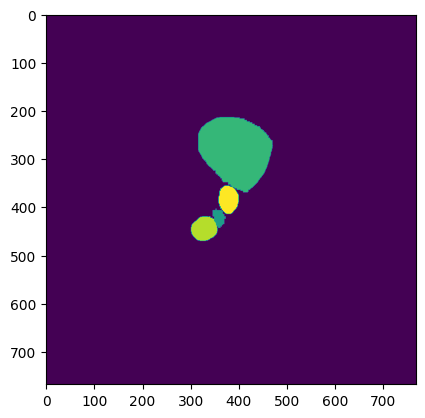

Slice number:  86


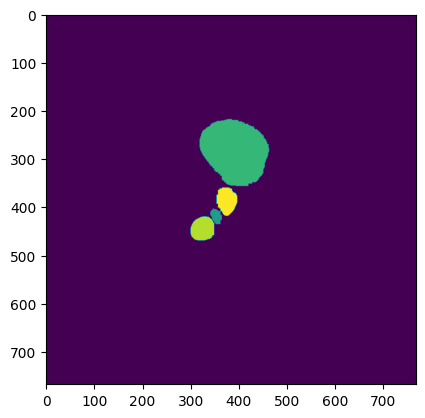

Slice number:  87


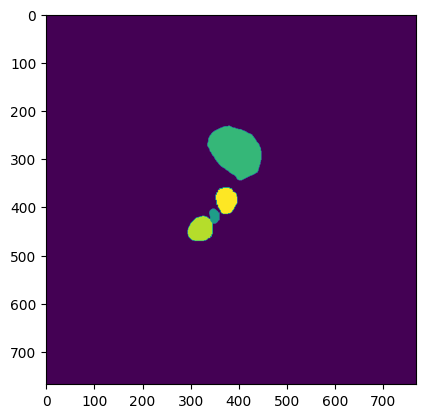

Slice number:  88


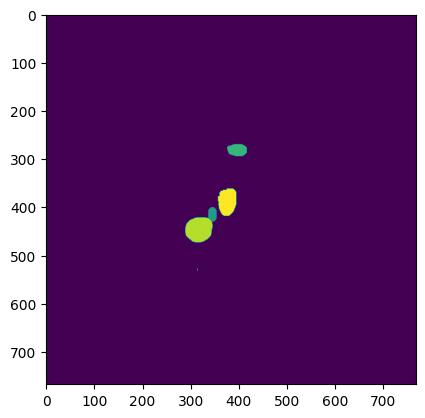

Slice number:  89


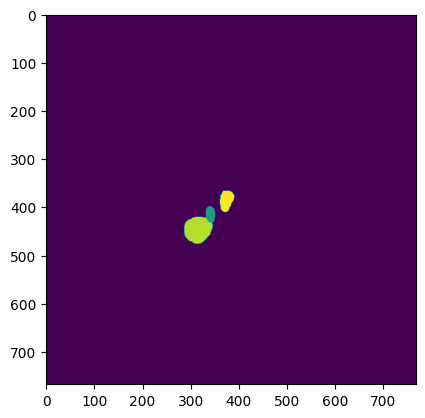

In [11]:
#print scan #0001
printSlice(ndt0001l)

### 1.13 Check the shapes of all images
the images may be of different shape. we want to standardize the shapes for better model performance. 


*p.s. we are checking with the processed (sliced) prostate only images to see the variation in prostate size. The slicing function is defined in 2.1 below*

In [15]:
#set os path one more time to be sure
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")

#set folder name to input and output
in_folder = "labelsTr"
#get item list to call functions on
item_list = os.listdir(in_folder)
shape_0 = np.zeros((len(item_list),))
shape_1 = np.zeros((len(item_list),))
shape_2 = np.zeros((len(item_list),))

#for all the item in input folder:
for i in range(len(item_list)):
    in_path = in_folder+"\\"+item_list[i]#set input path, start from folder
    img, ndt = getScan(in_path)#call slicing on each item
    if len(ndt.shape)==3:
        shape_0[i] = ndt.shape[0]
        shape_1[i] = ndt.shape[1]
        shape_2[i] = ndt.shape[2]
        if ndt.shape[0]==0 or ndt.shape[1]==0 or ndt.shape[2]==0:
            print(item_list[i], ndt.shape)

check the distribution pattern for each of the shape dimension:

In [16]:
print("avg: ", np.average(shape_0), np.average(shape_1), np.average(shape_2))
print("median: ", np.median(shape_0), np.median(shape_1), np.median(shape_2))
print("min: ", np.min(shape_0), np.min(shape_1), np.min(shape_2))
print("max: ", np.max(shape_0), np.max(shape_1), np.max(shape_2))
print("uniq values in shape_0: ", np.unique(shape_0))
print("uniq values in shape_1: ", np.unique(shape_1))
print("uniq values in shape_2: ", np.unique(shape_2))

avg:  599.04 599.04 130.345
median:  512.0 512.0 100.0
min:  512.0 512.0 68.0
max:  768.0 768.0 353.0
uniq values in shape_0:  [512. 768.]
uniq values in shape_1:  [512. 768.]
uniq values in shape_2:  [ 68.  72.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 112. 114. 116. 118. 120. 121. 122.
 123. 124. 125. 126. 131. 132. 133. 134. 135. 138. 140. 163. 187. 191.
 192. 197. 202. 205. 212. 214. 215. 217. 218. 221. 222. 224. 228. 234.
 237. 239. 243. 244. 245. 251. 265. 291. 292. 294. 298. 303. 306. 314.
 317. 321. 322. 333. 341. 345. 353.]


there are some **wildly high values** in the 3rd dimensions. lets check

Slice number:  0


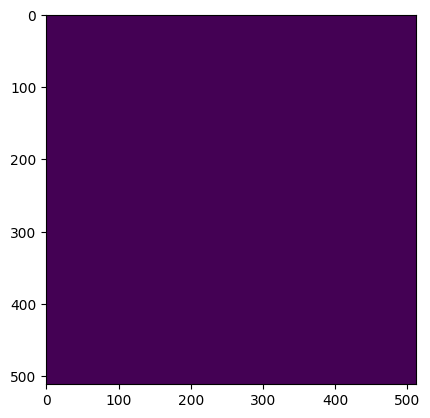

Slice number:  1


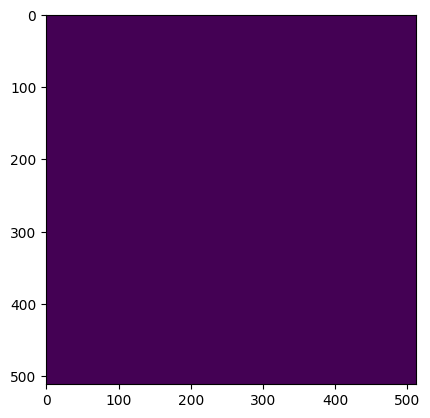

Slice number:  2


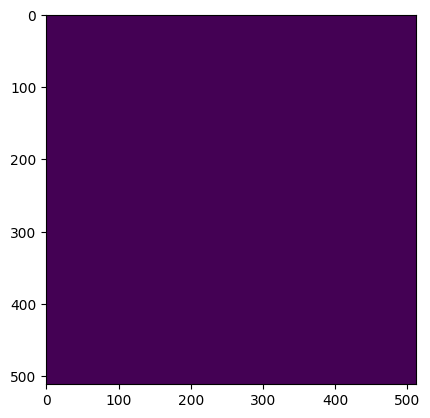

Slice number:  3


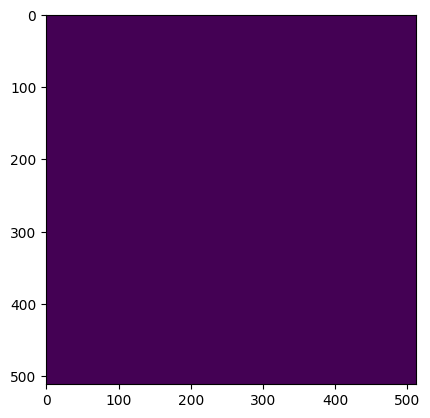

Slice number:  4


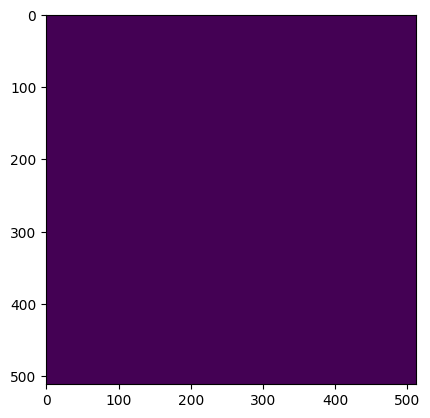

Slice number:  5


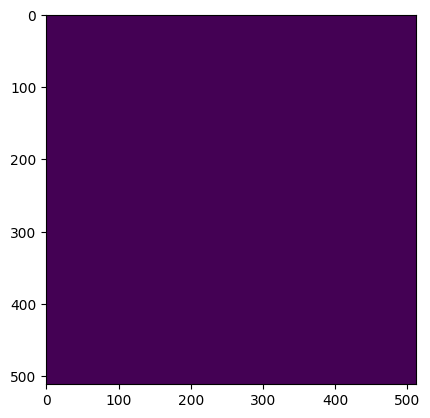

Slice number:  6


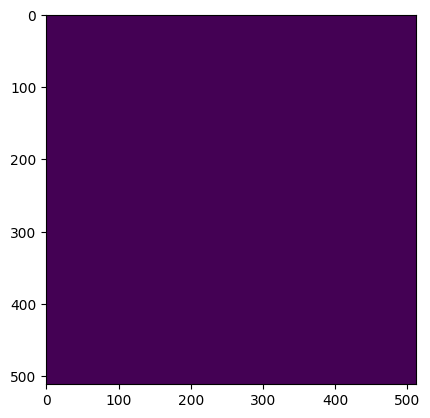

Slice number:  7


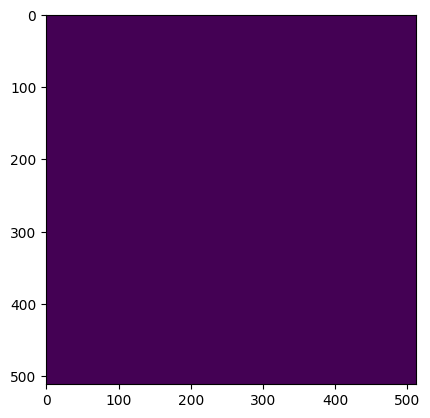

Slice number:  8


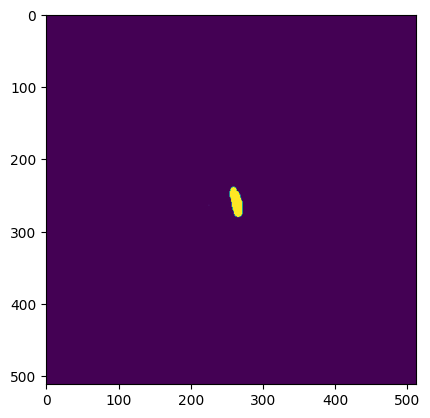

Slice number:  9


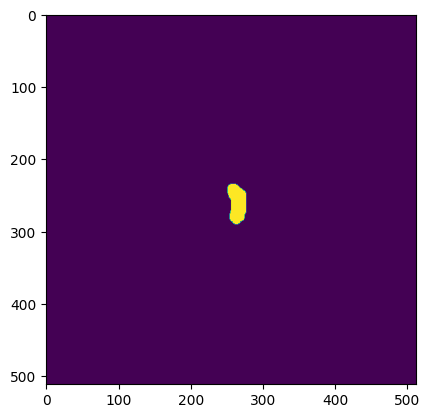

Slice number:  10


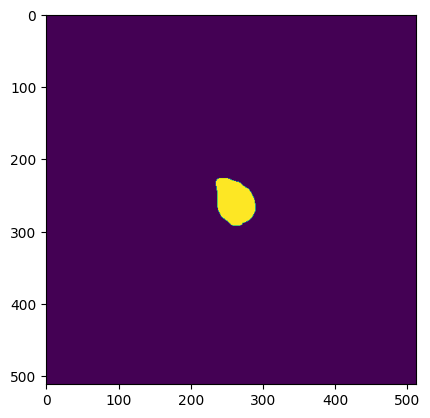

Slice number:  11


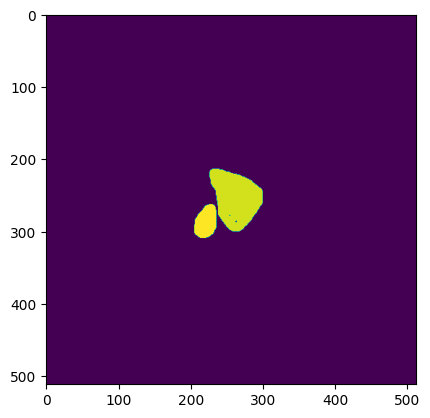

Slice number:  12


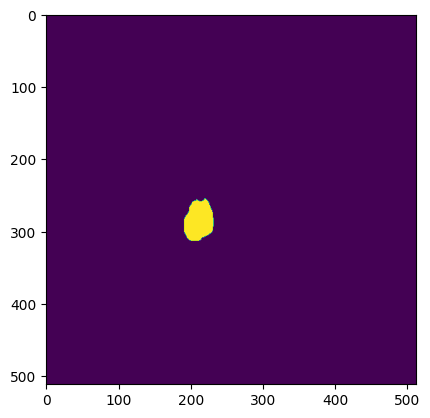

Slice number:  13


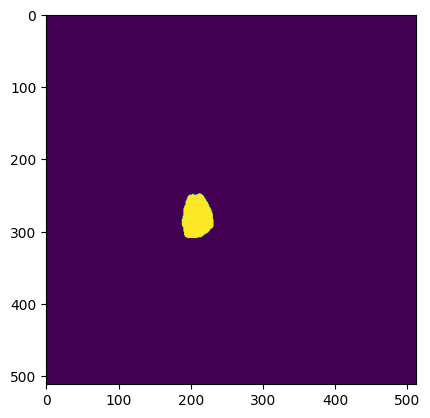

Slice number:  14


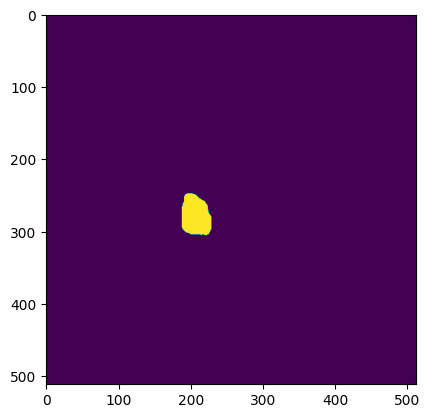

Slice number:  15


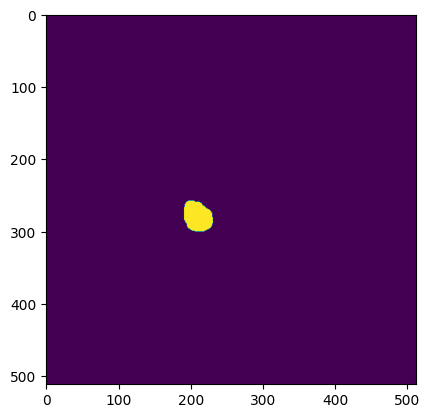

Slice number:  16


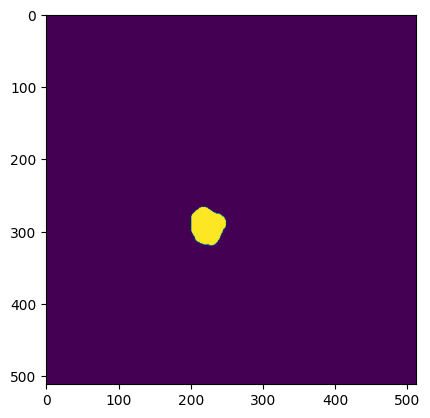

Slice number:  17


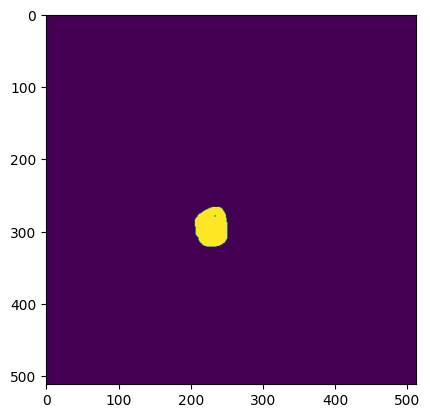

Slice number:  18


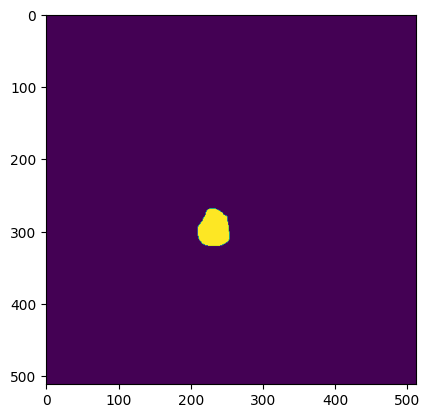

Slice number:  19


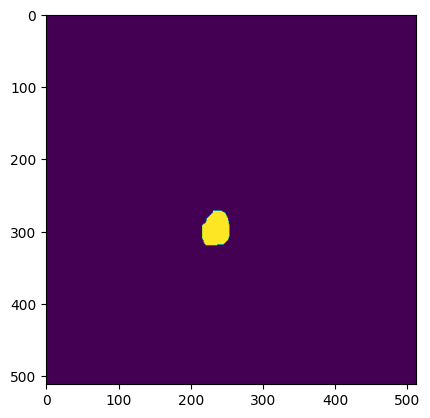

Slice number:  20


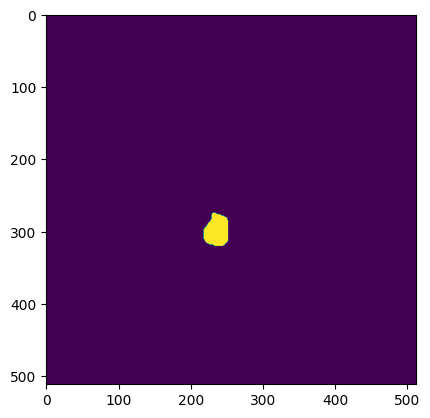

Slice number:  21


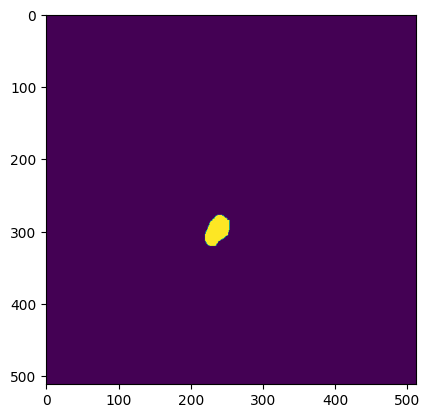

Slice number:  22


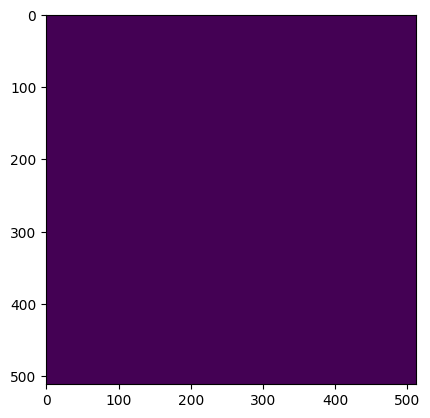

Slice number:  23


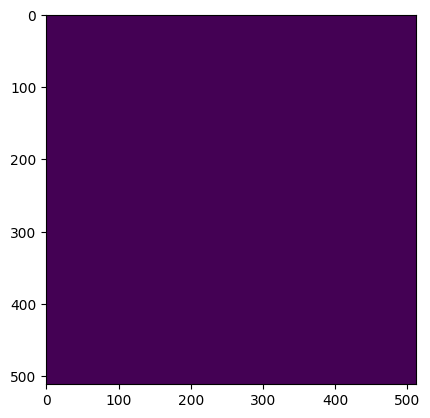

Slice number:  24


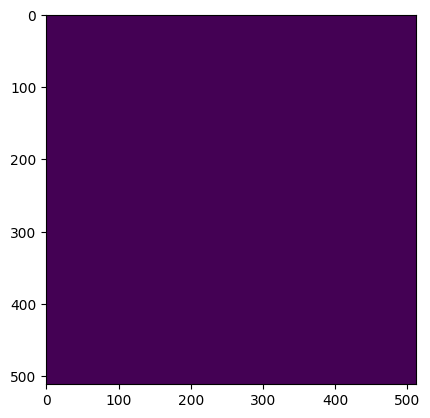

Slice number:  25


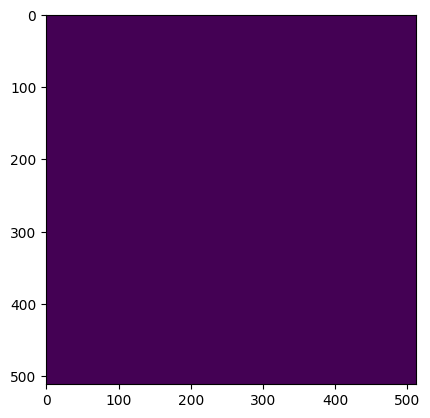

Slice number:  26


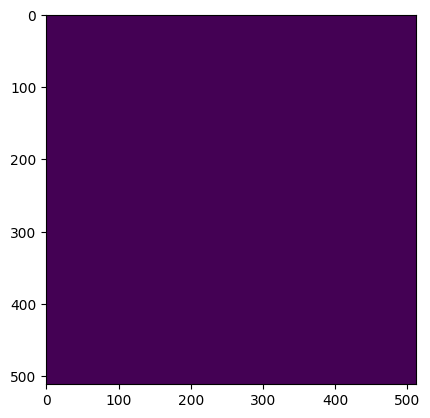

Slice number:  27


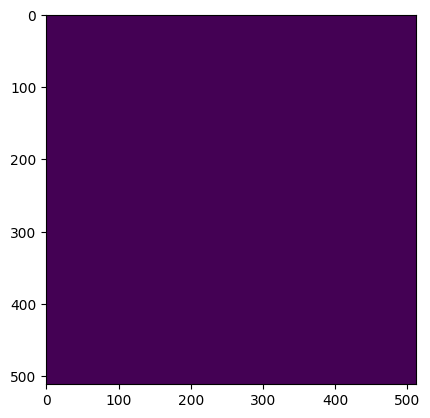

Slice number:  28


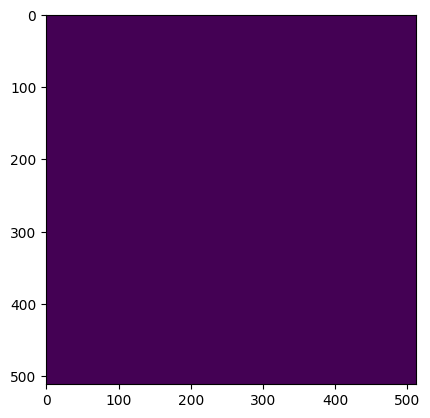

Slice number:  29


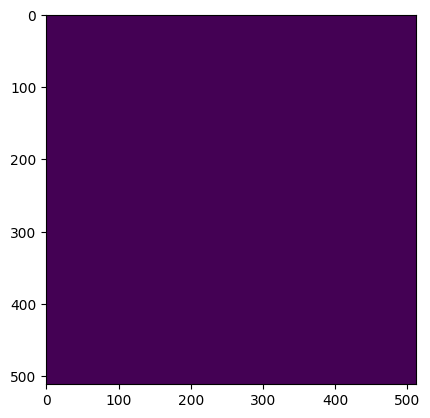

Slice number:  30


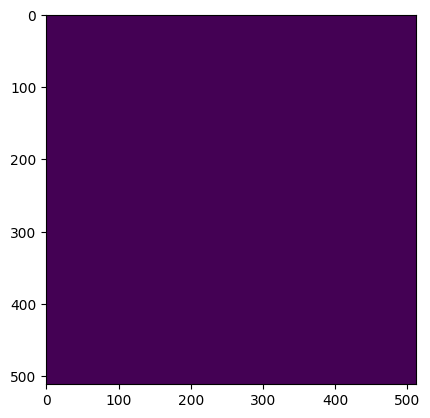

Slice number:  31


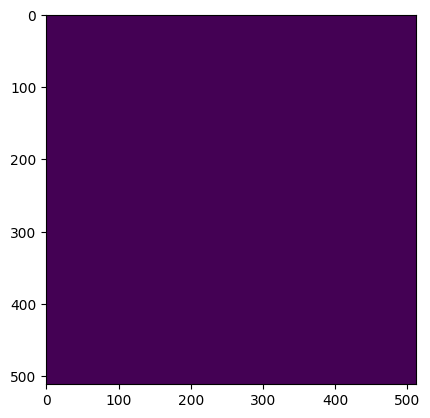

Slice number:  32


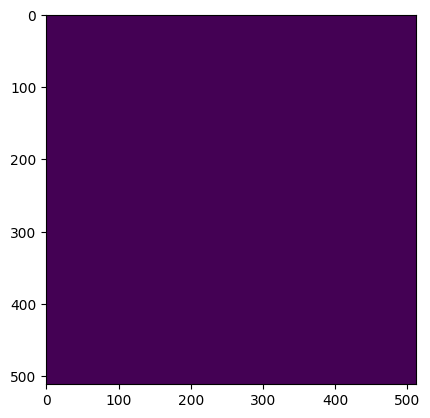

Slice number:  33


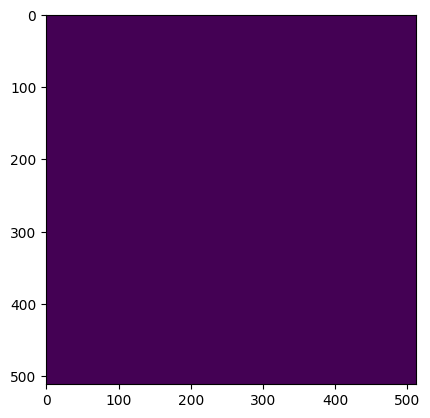

Slice number:  34


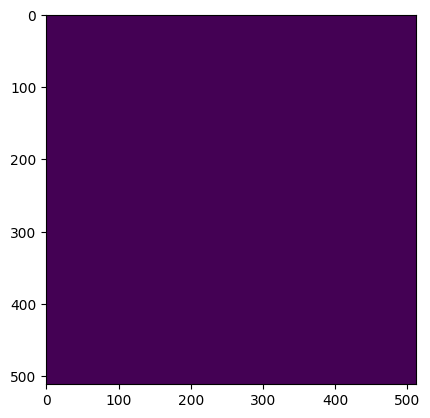

Slice number:  35


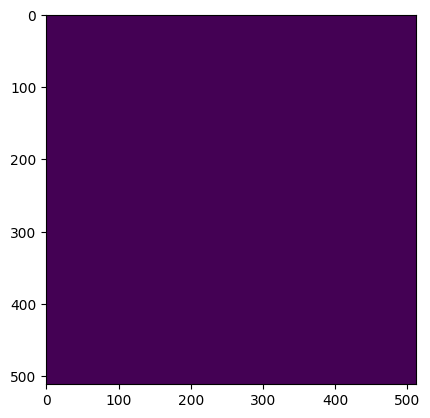

Slice number:  36


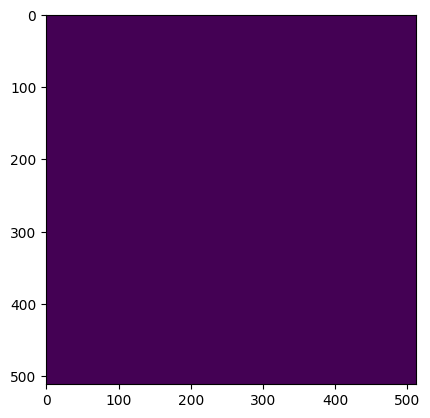

Slice number:  37


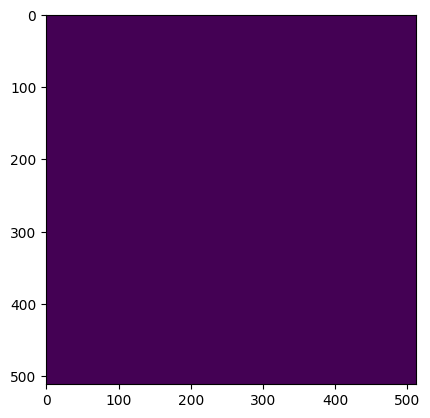

Slice number:  38


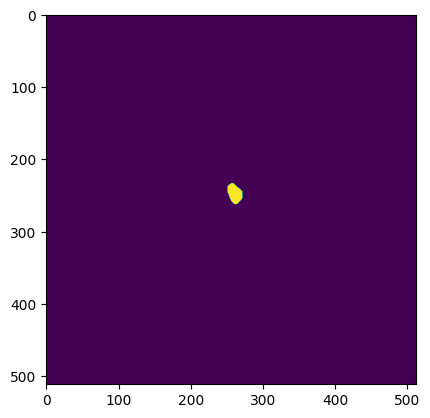

Slice number:  39


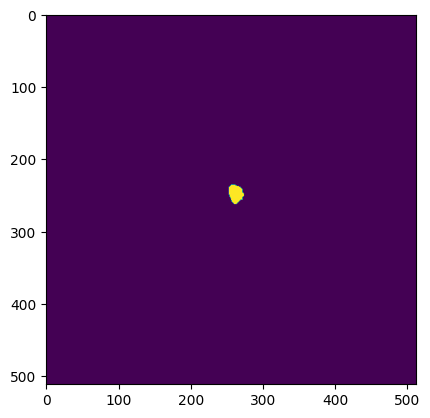

Slice number:  40


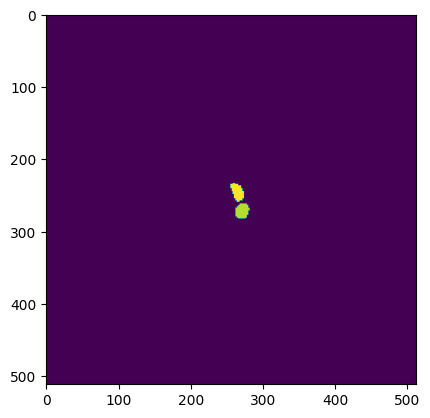

Slice number:  41


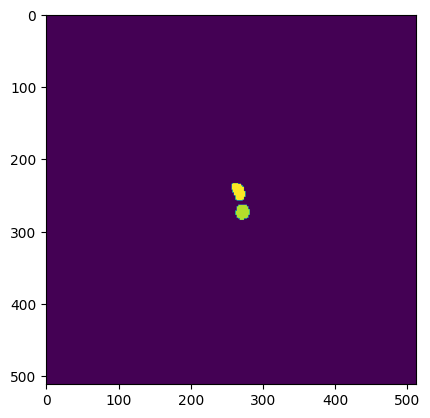

Slice number:  42


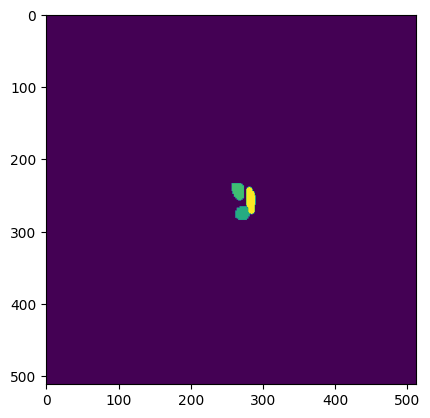

Slice number:  43


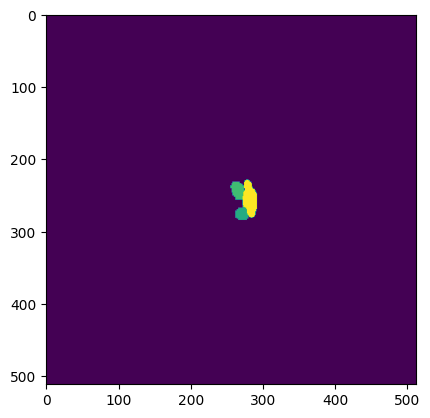

Slice number:  44


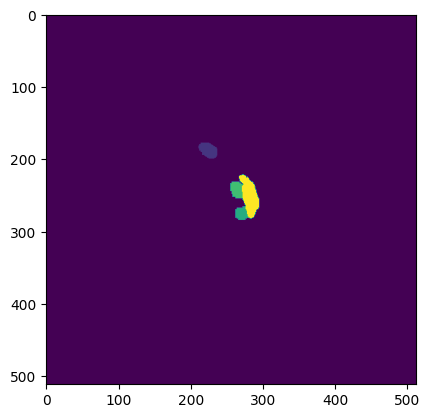

Slice number:  45


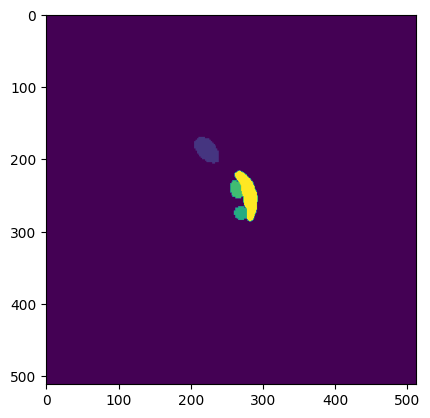

Slice number:  46


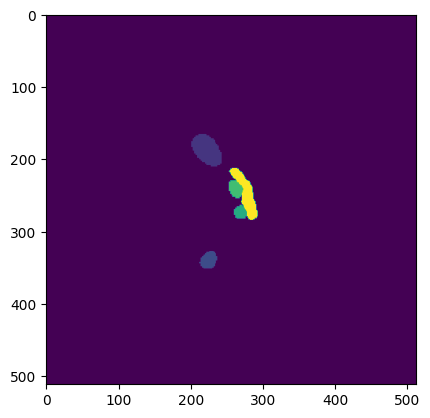

Slice number:  47


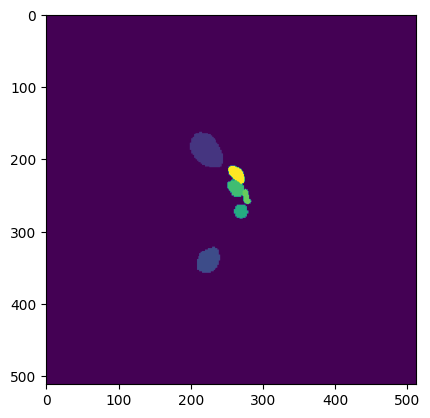

Slice number:  48


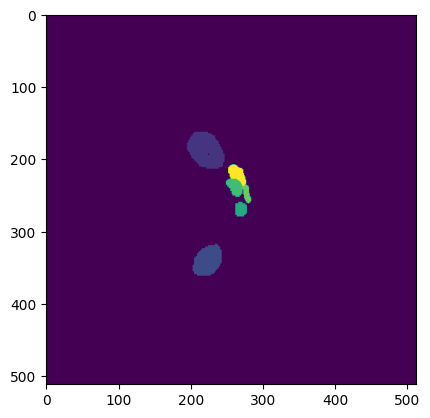

Slice number:  49


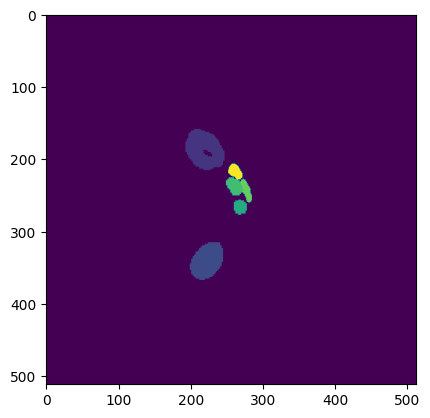

Slice number:  50


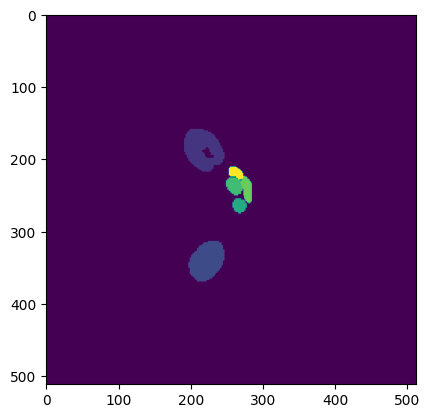

Slice number:  51


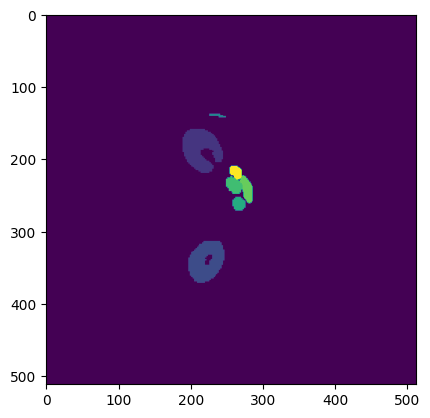

Slice number:  52


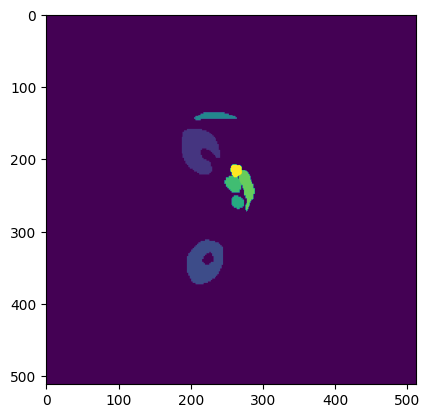

Slice number:  53


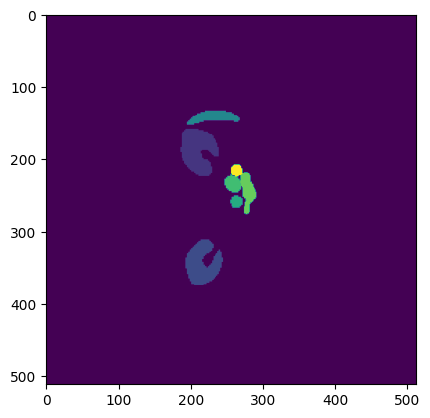

Slice number:  54


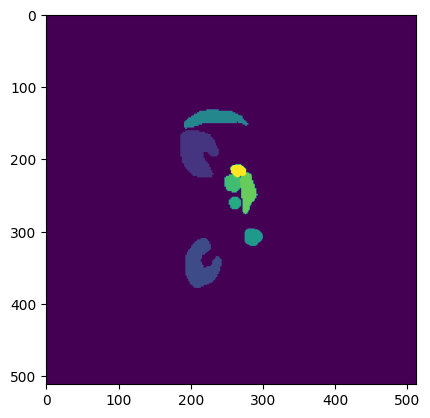

Slice number:  55


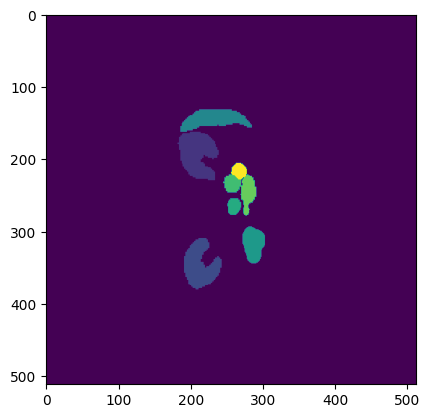

Slice number:  56


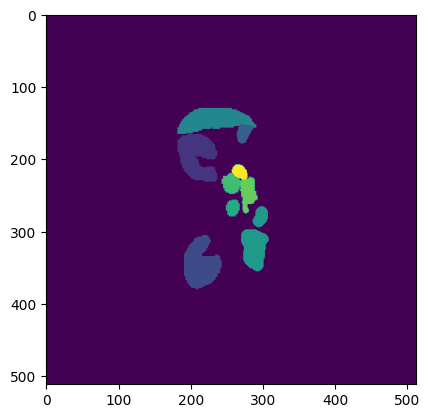

Slice number:  57


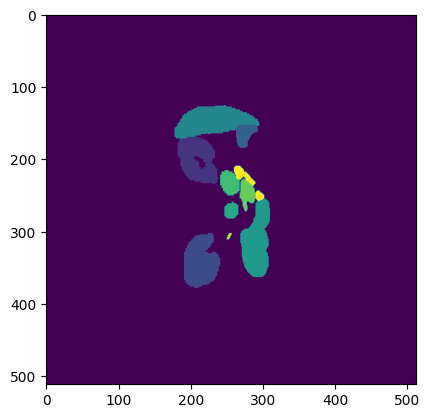

Slice number:  58


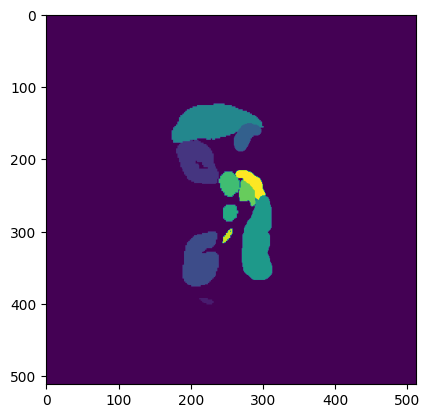

Slice number:  59


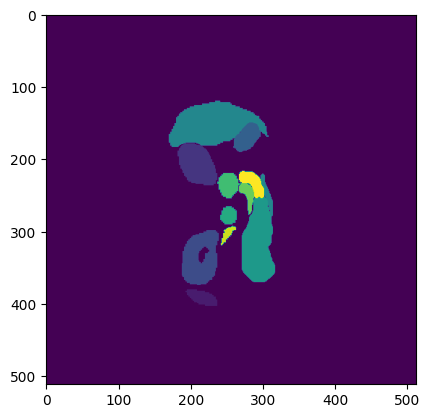

Slice number:  60


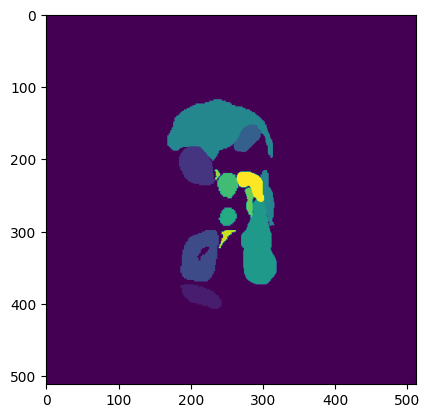

Slice number:  61


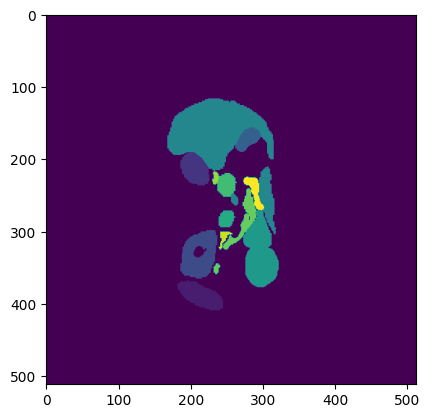

Slice number:  62


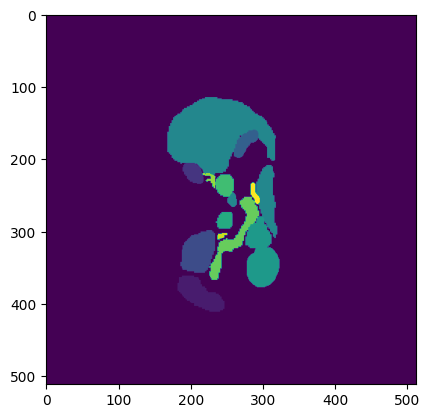

Slice number:  63


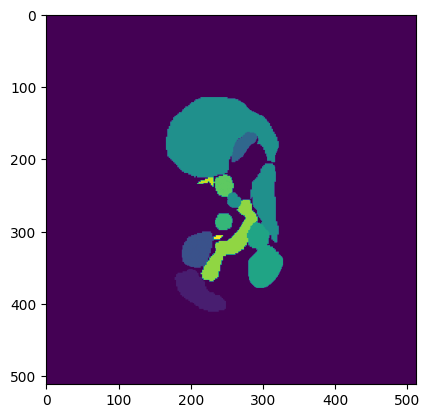

Slice number:  64


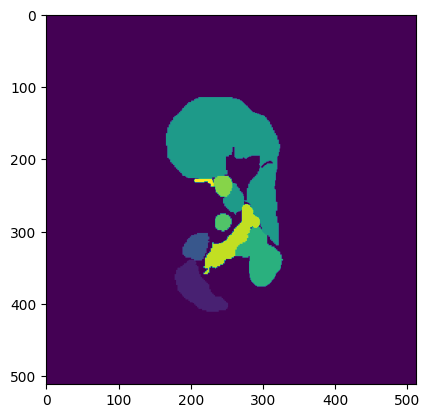

Slice number:  65


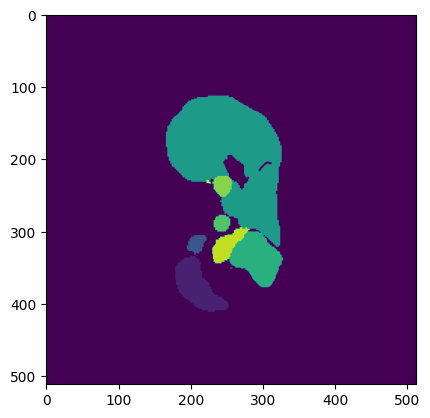

Slice number:  66


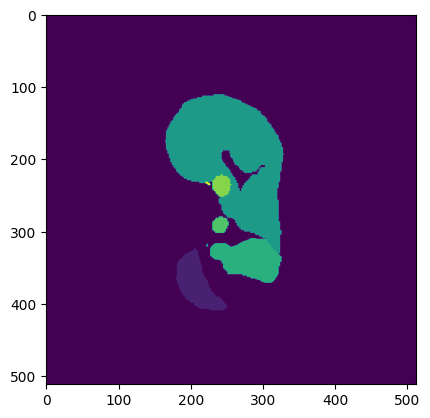

Slice number:  67


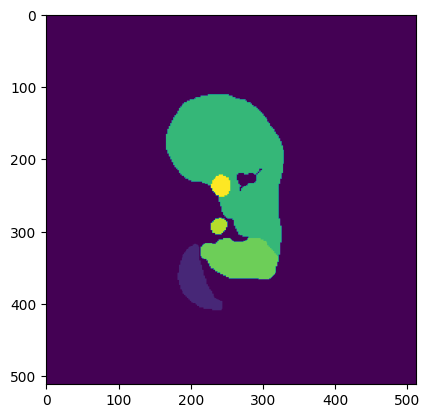

Slice number:  68


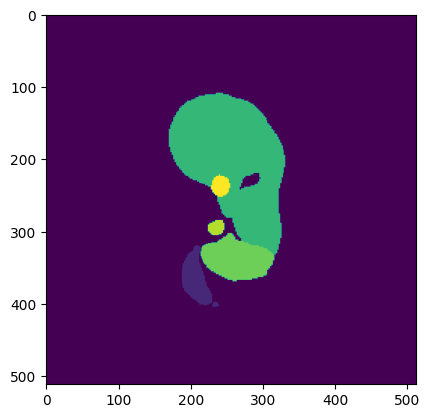

Slice number:  69


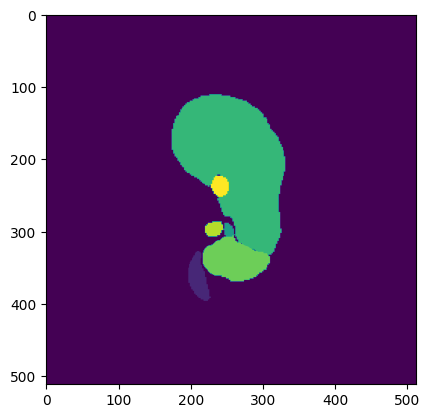

Slice number:  70


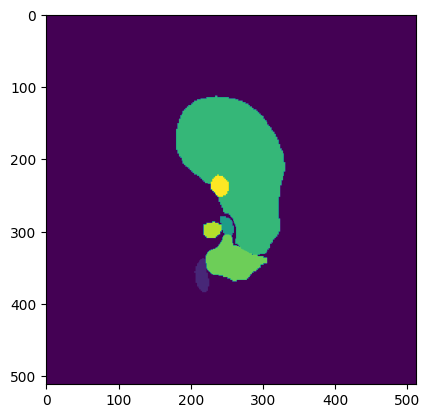

Slice number:  71


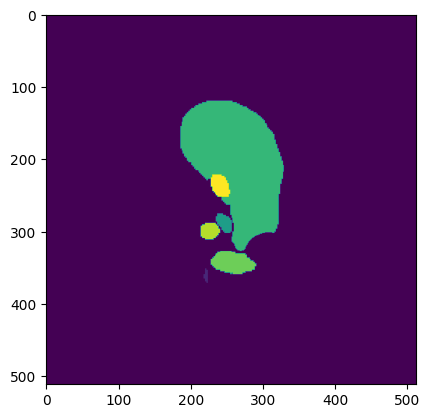

Slice number:  72


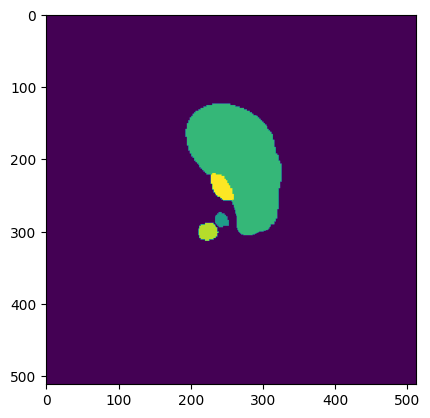

Slice number:  73


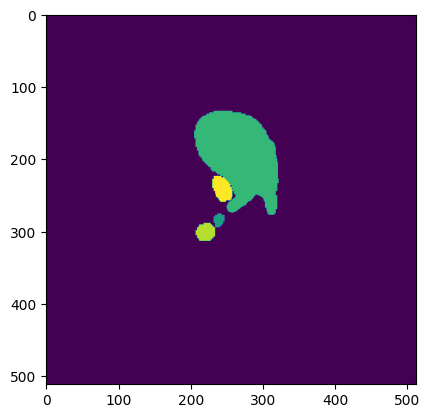

Slice number:  74


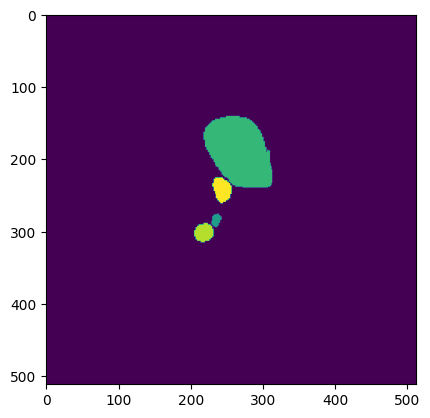

Slice number:  75


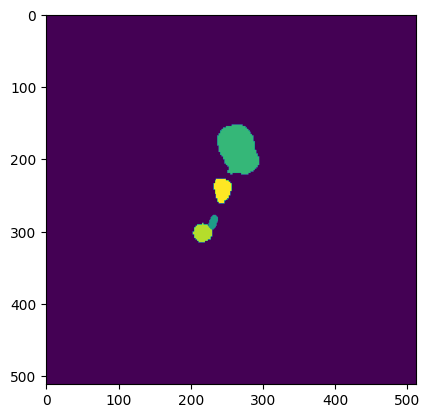

Slice number:  76


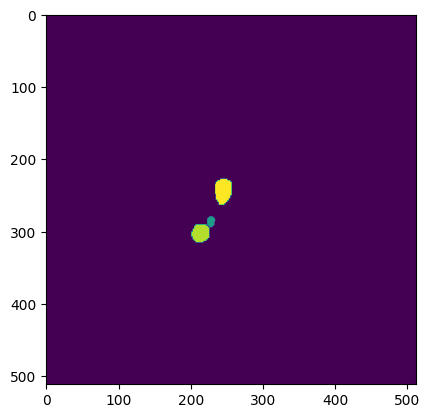

Slice number:  77


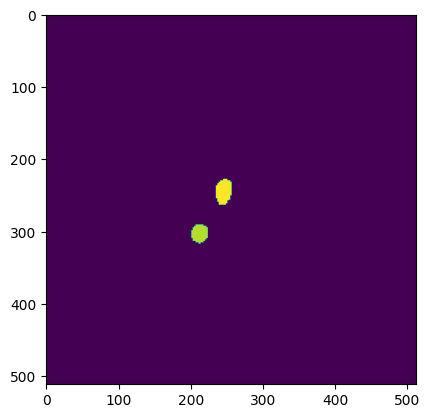

In [18]:
img004, ndt004 = getScan('labelsTr/amos_0004.nii.gz')
printSlice(ndt004)

Slice number:  0


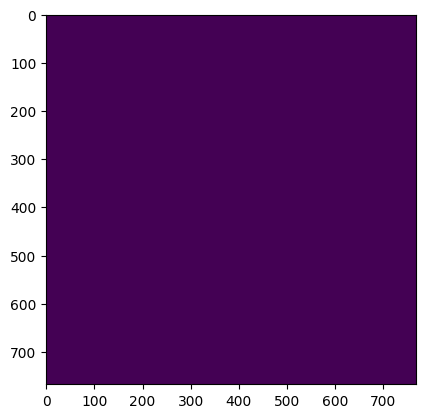

Slice number:  1


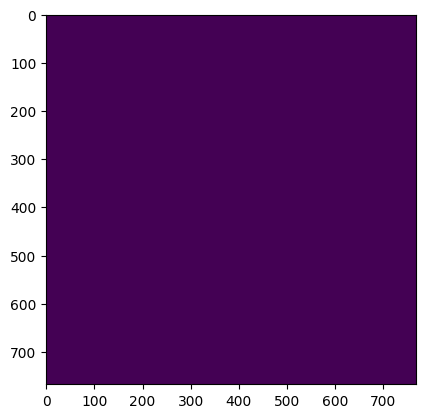

Slice number:  2


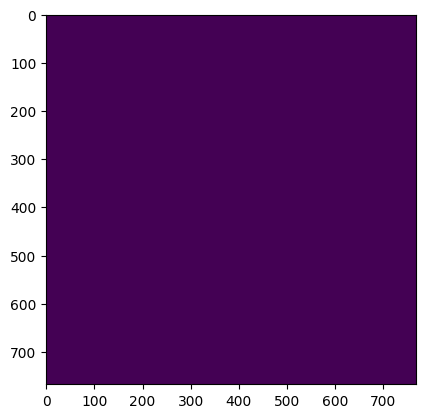

Slice number:  3


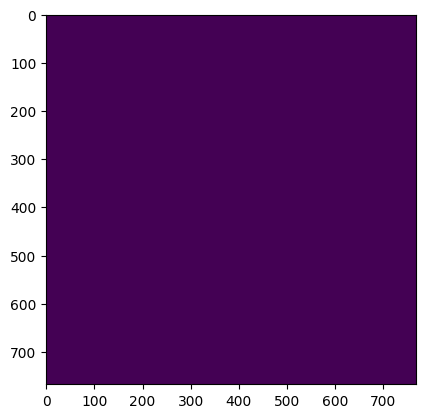

Slice number:  4


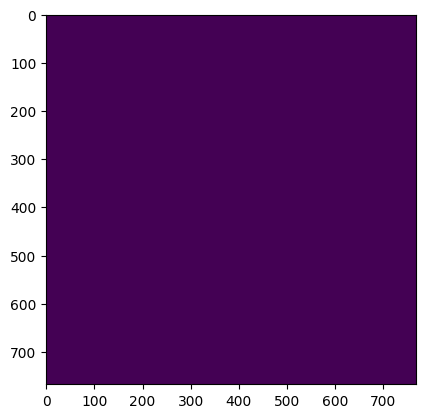

Slice number:  5


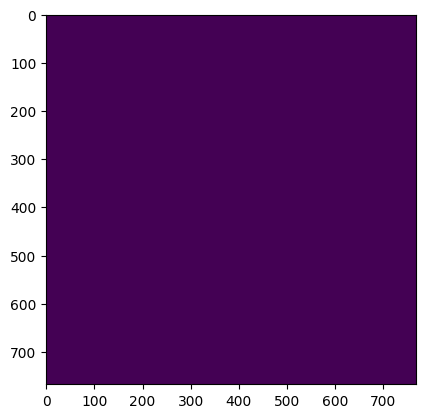

Slice number:  6


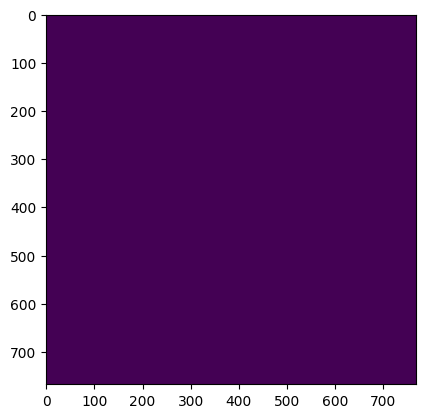

Slice number:  7


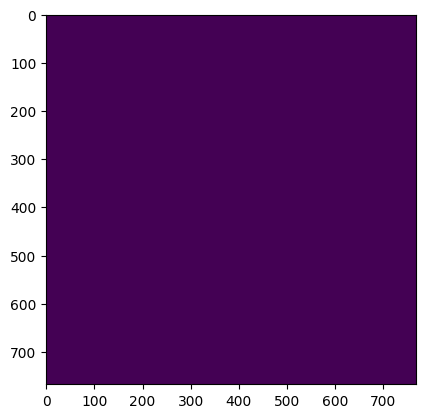

Slice number:  8


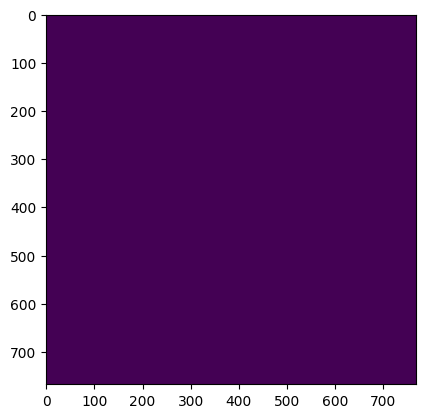

Slice number:  9


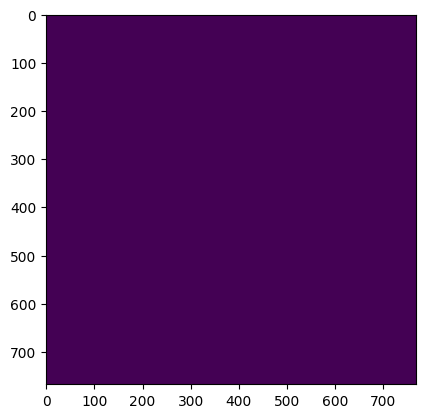

Slice number:  10


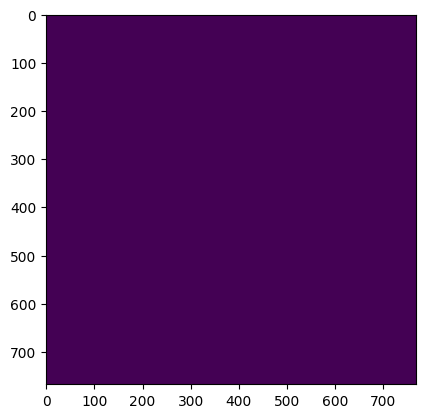

Slice number:  11


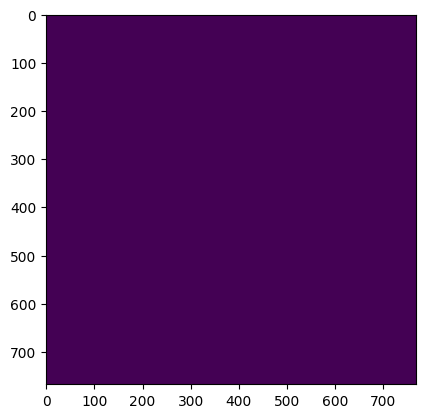

Slice number:  12


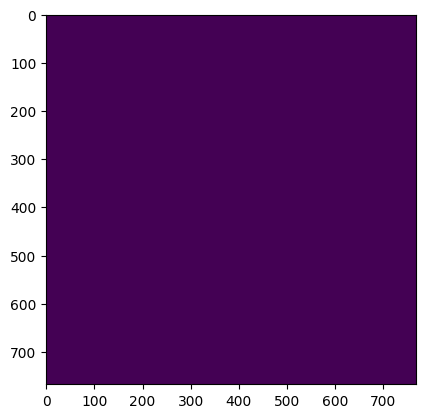

Slice number:  13


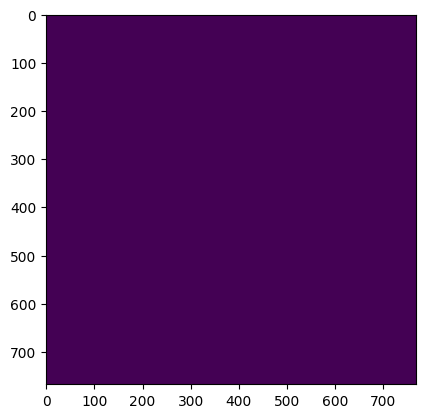

Slice number:  14


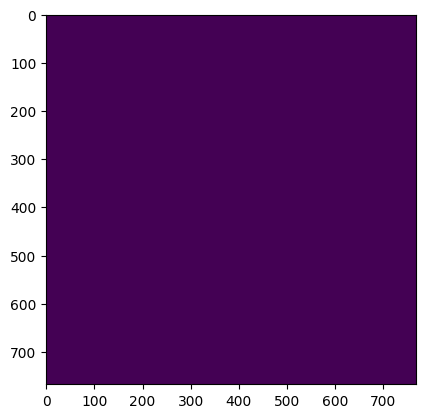

Slice number:  15


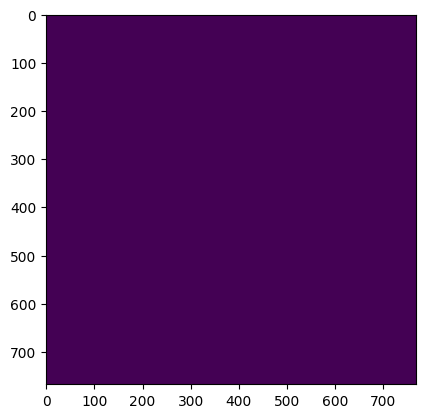

Slice number:  16


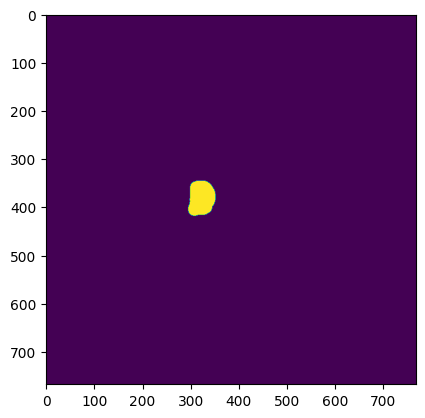

Slice number:  17


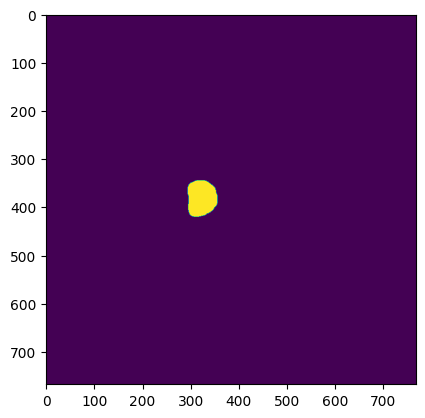

Slice number:  18


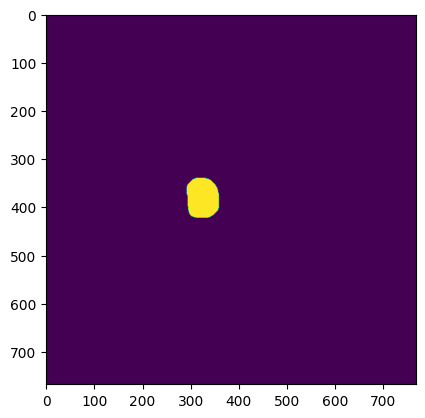

Slice number:  19


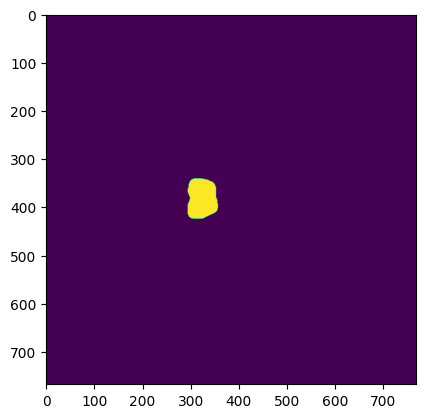

Slice number:  20


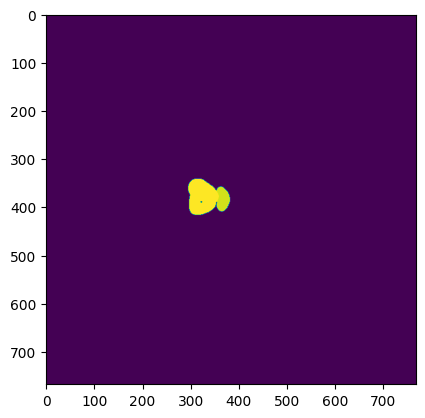

Slice number:  21


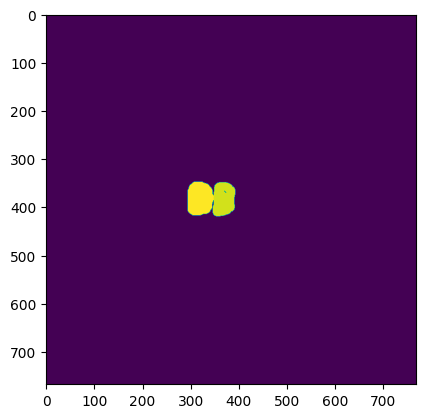

Slice number:  22


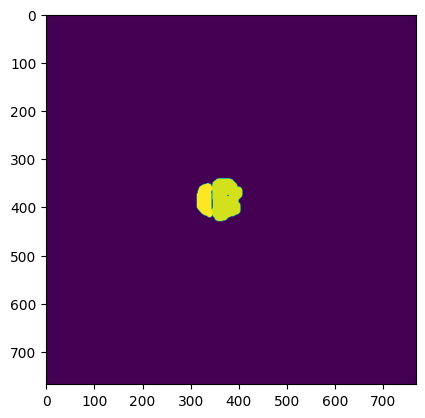

Slice number:  23


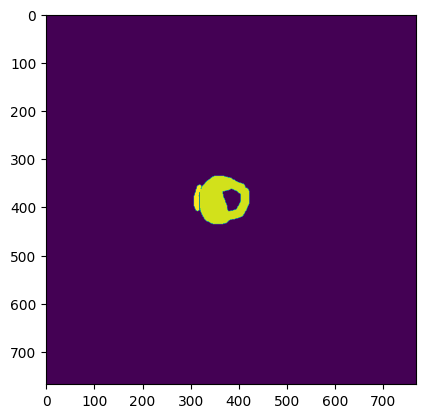

Slice number:  24


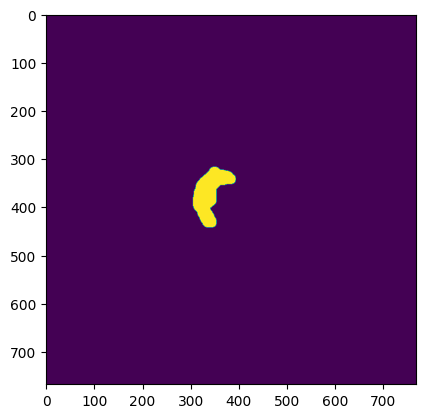

Slice number:  25


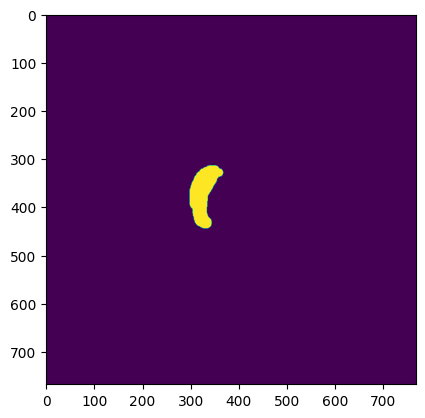

Slice number:  26


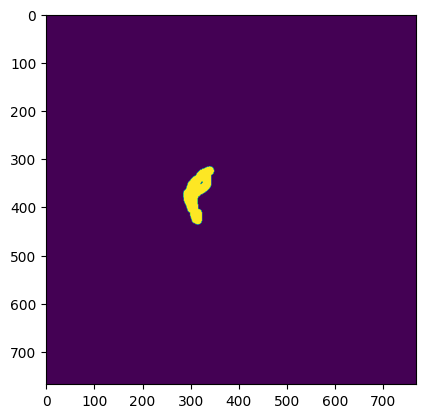

Slice number:  27


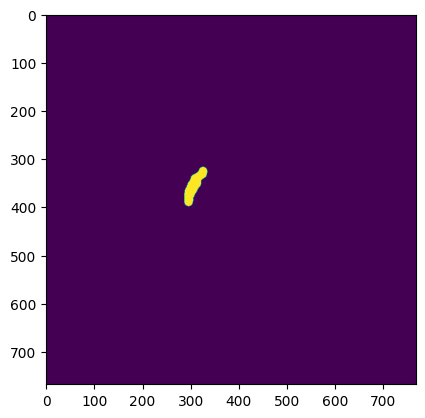

Slice number:  28


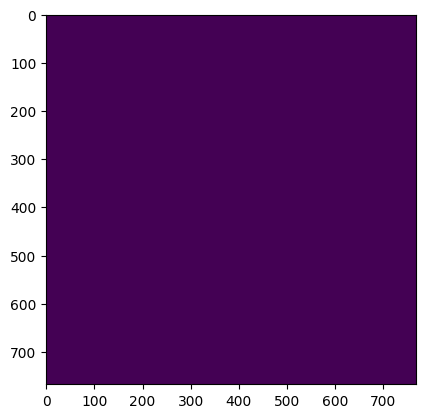

Slice number:  29


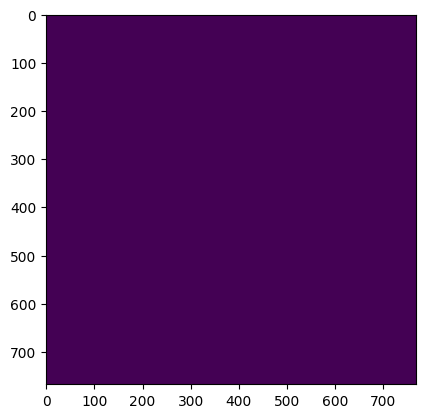

Slice number:  30


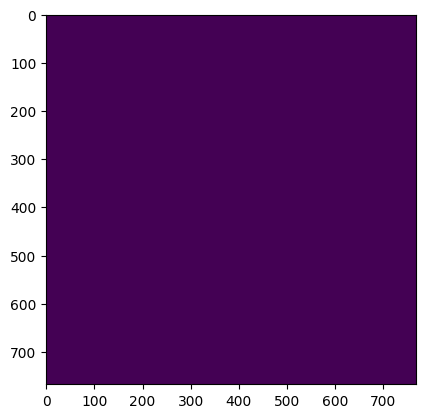

Slice number:  31


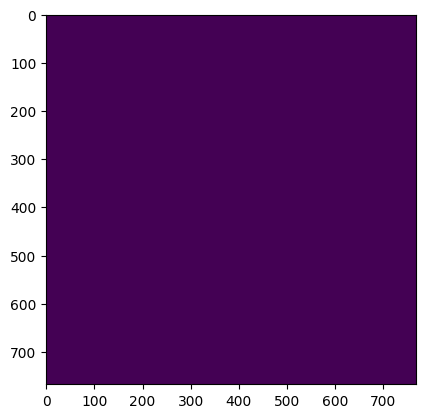

Slice number:  32


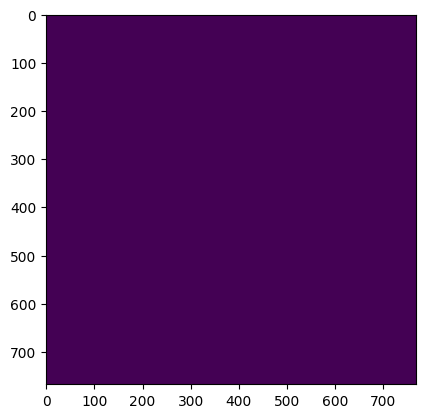

Slice number:  33


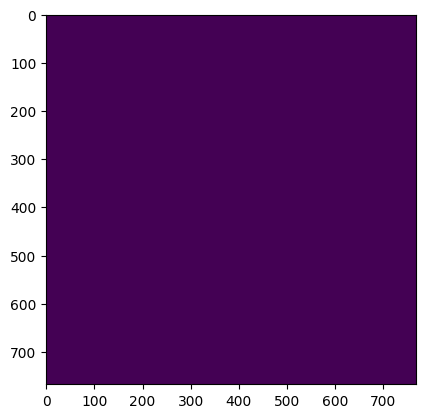

Slice number:  34


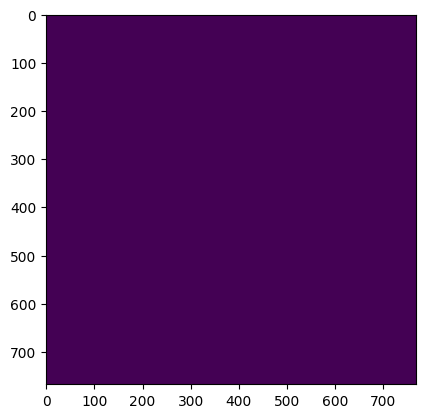

Slice number:  35


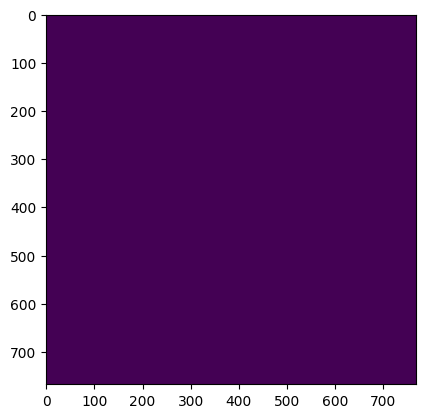

Slice number:  36


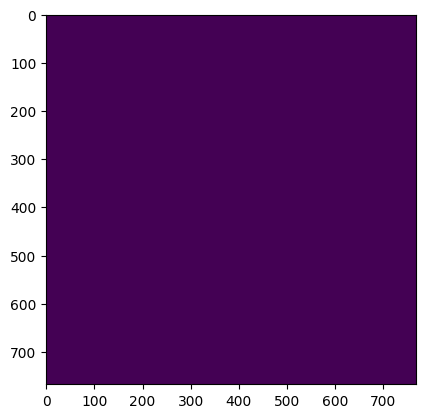

Slice number:  37


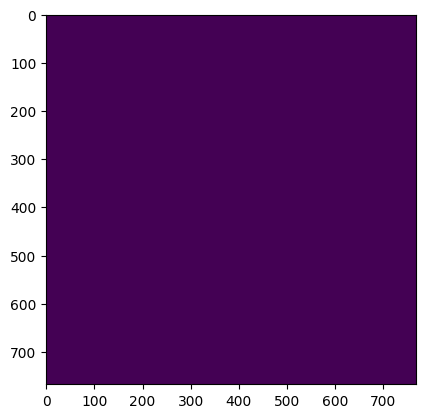

Slice number:  38


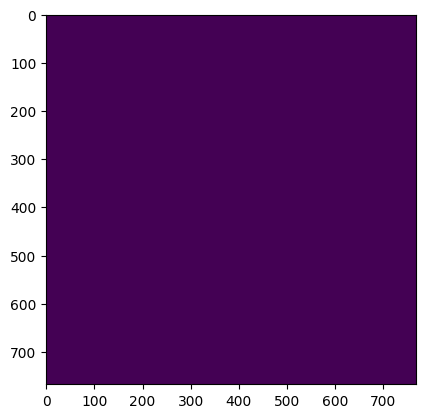

Slice number:  39


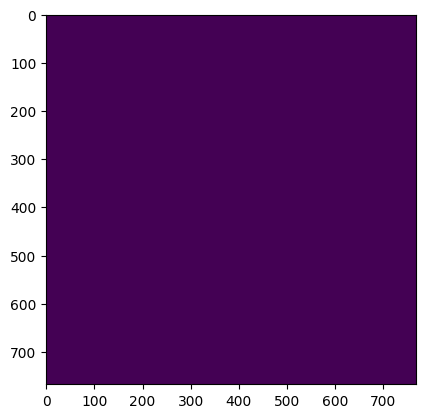

Slice number:  40


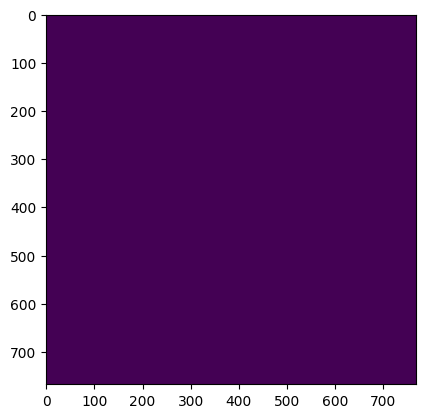

Slice number:  41


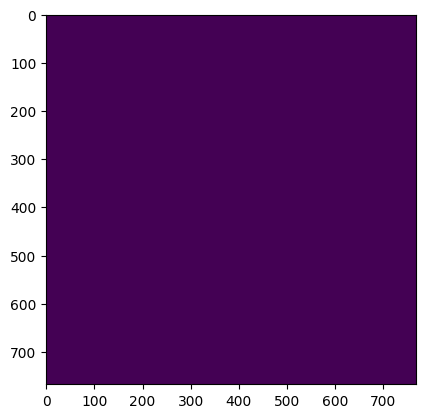

Slice number:  42


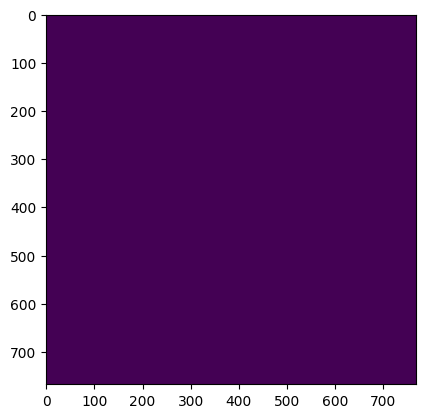

Slice number:  43


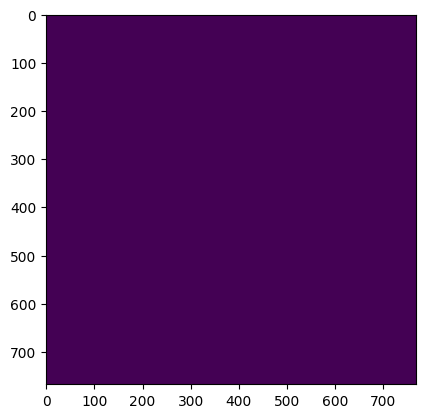

Slice number:  44


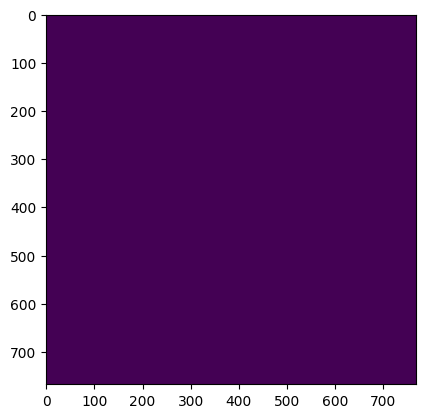

Slice number:  45


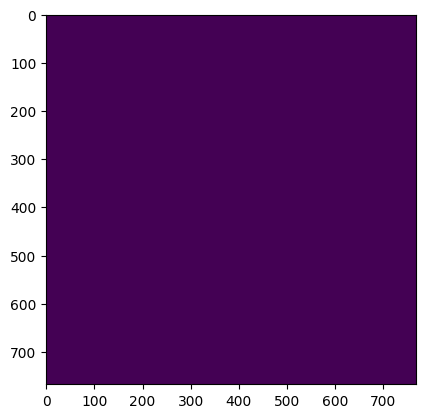

Slice number:  46


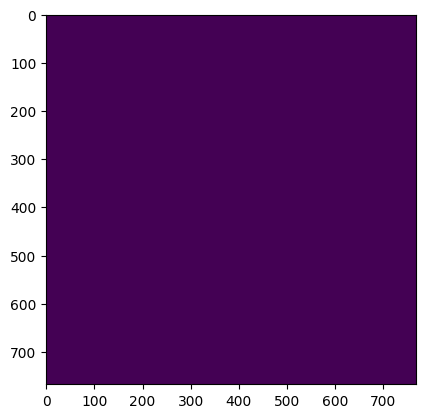

Slice number:  47


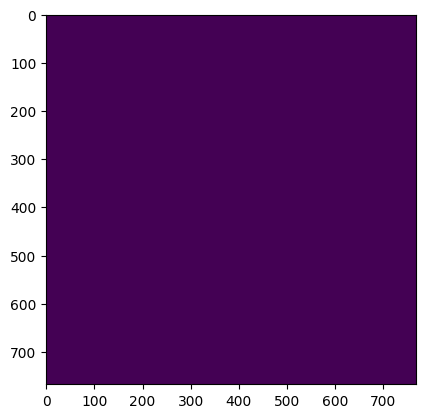

Slice number:  48


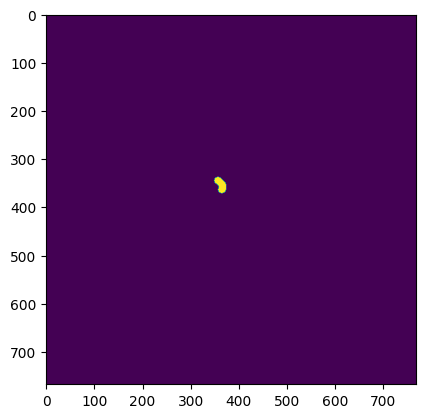

Slice number:  49


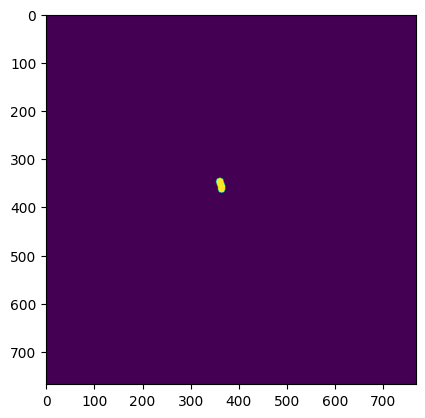

Slice number:  50


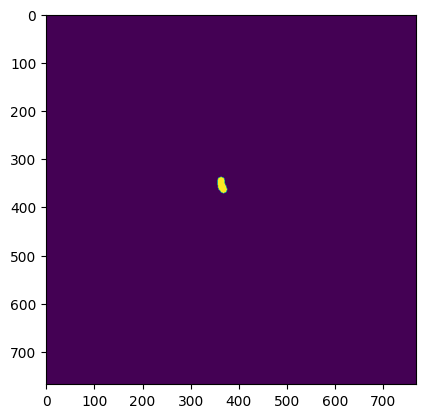

Slice number:  51


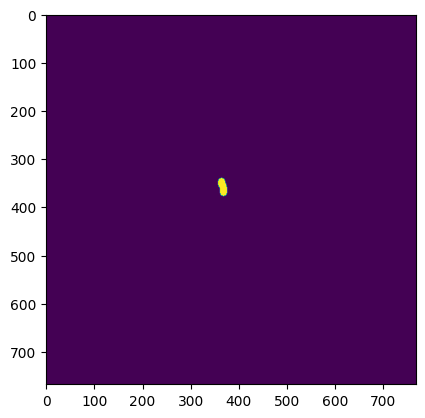

Slice number:  52


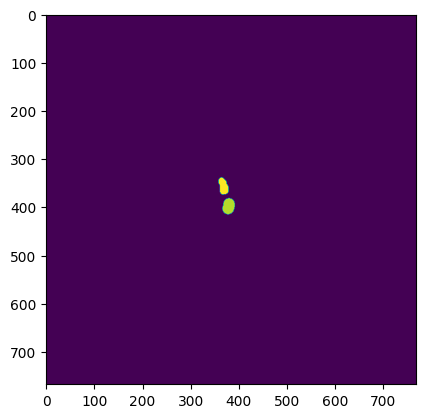

Slice number:  53


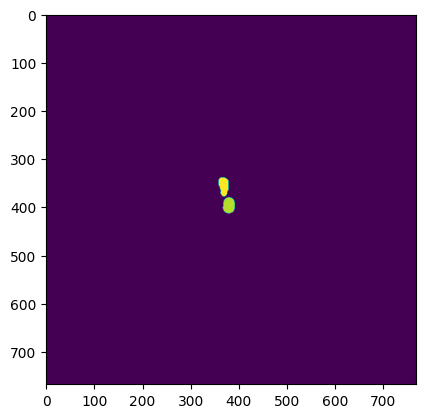

Slice number:  54


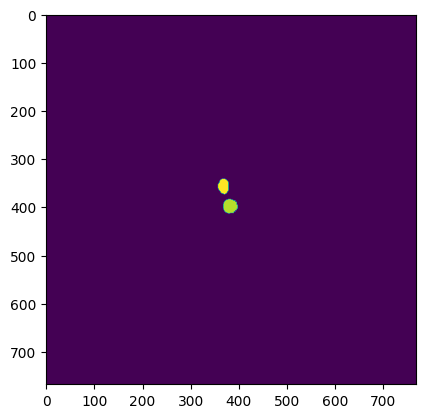

Slice number:  55


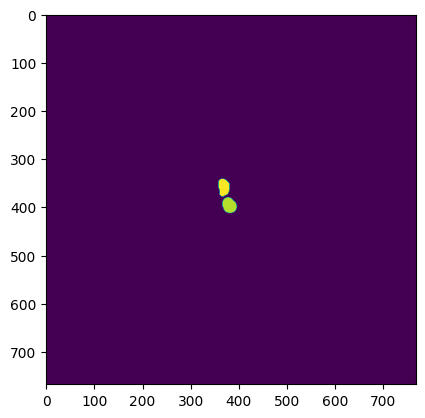

Slice number:  56


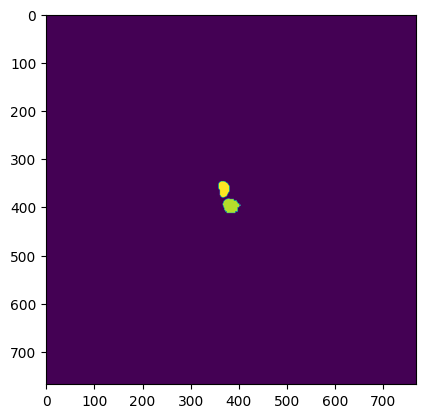

Slice number:  57


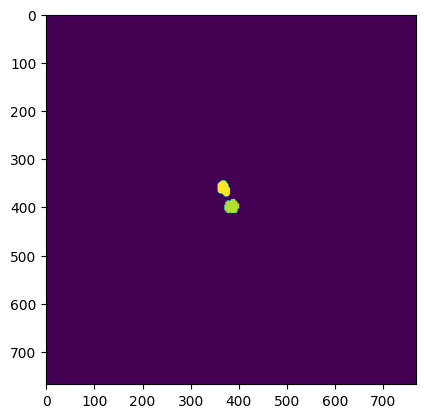

Slice number:  58


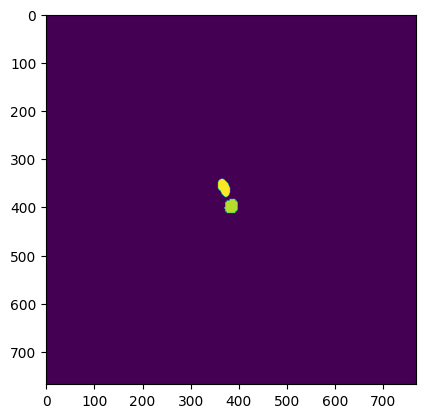

Slice number:  59


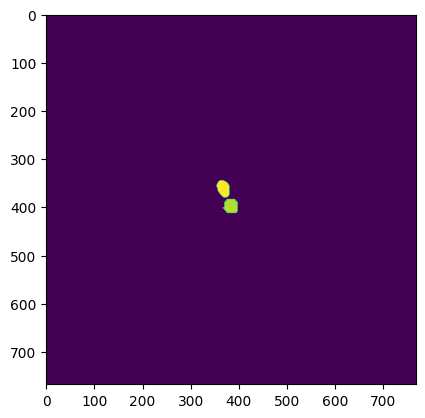

Slice number:  60


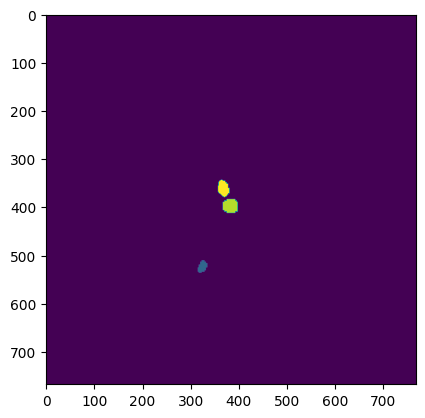

Slice number:  61


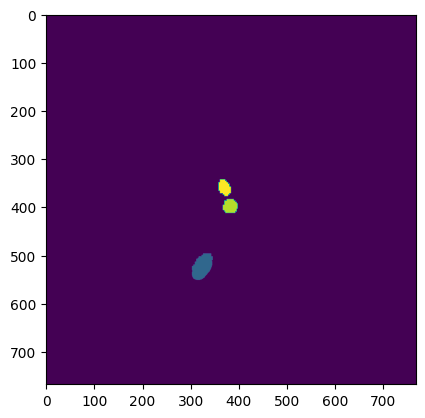

Slice number:  62


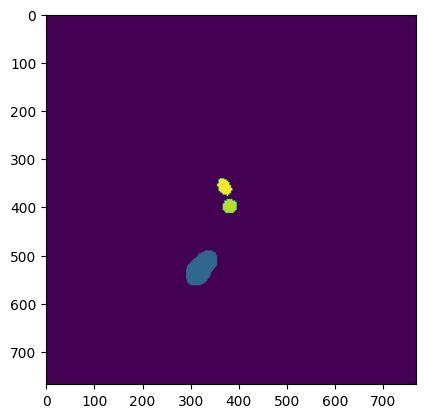

Slice number:  63


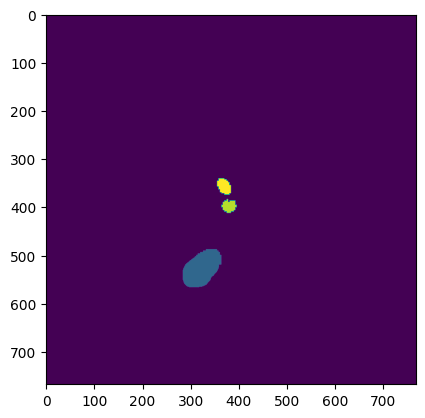

Slice number:  64


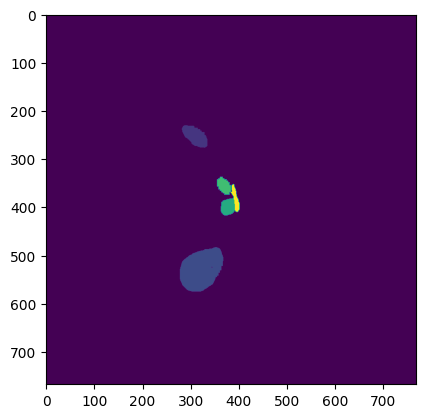

Slice number:  65


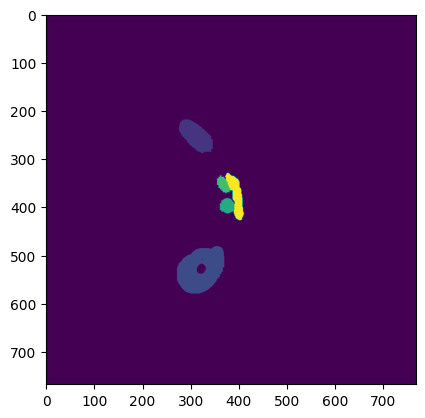

Slice number:  66


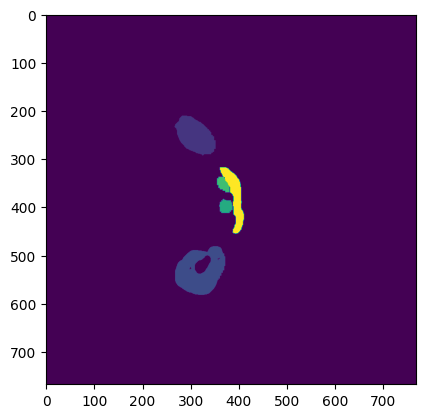

Slice number:  67


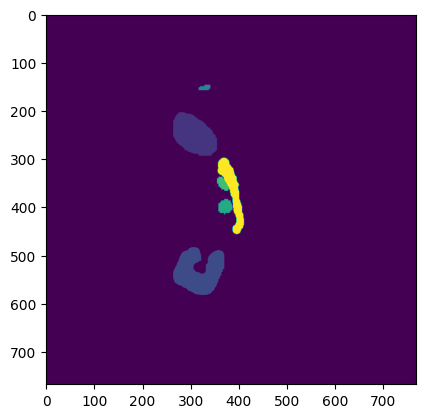

Slice number:  68


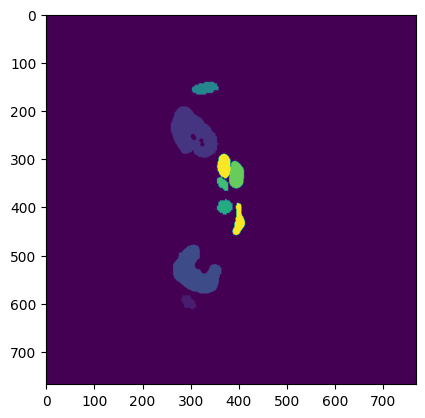

Slice number:  69


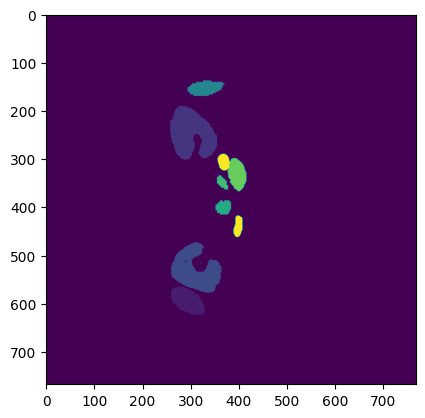

Slice number:  70


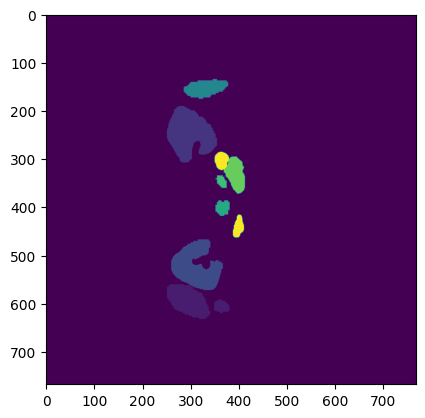

Slice number:  71


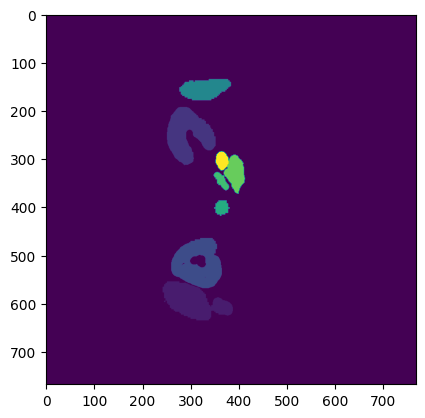

Slice number:  72


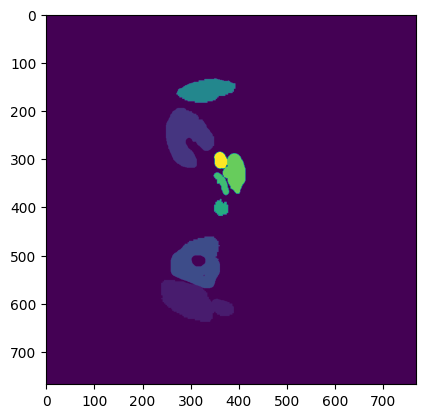

Slice number:  73


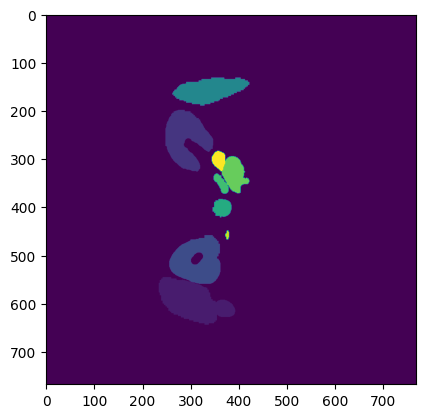

Slice number:  74


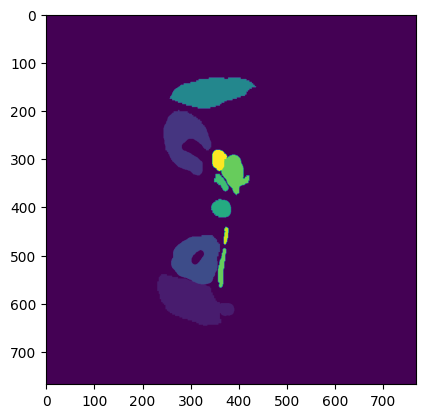

Slice number:  75


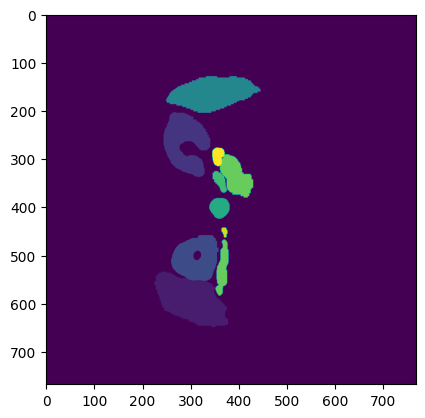

Slice number:  76


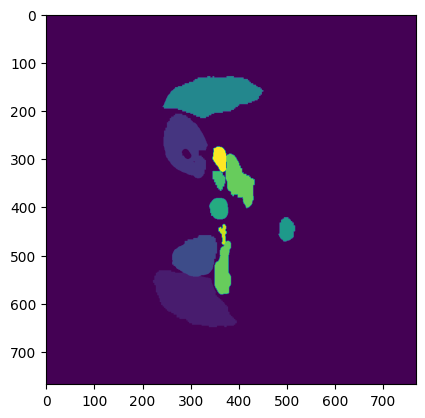

Slice number:  77


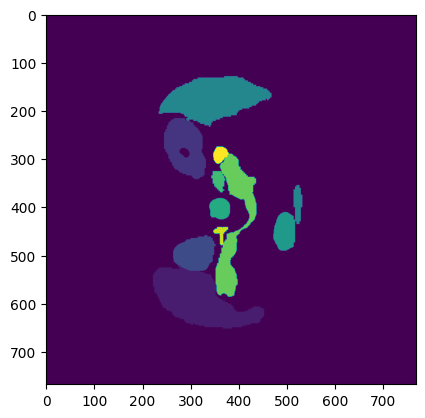

Slice number:  78


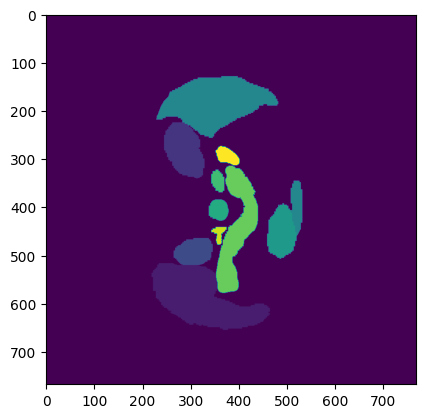

Slice number:  79


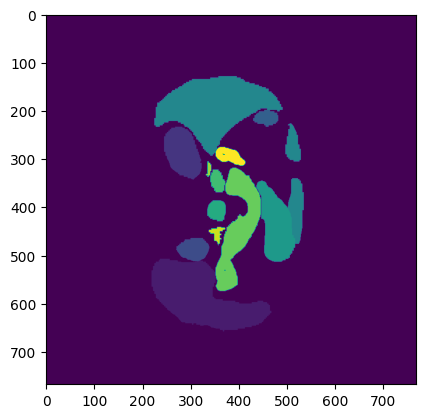

Slice number:  80


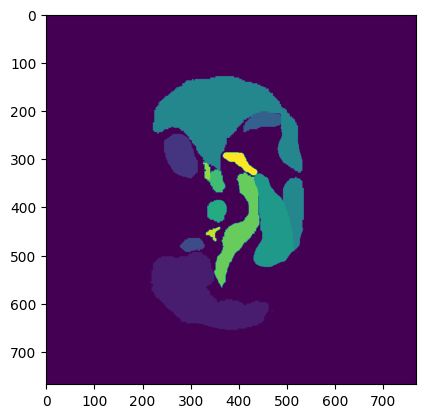

Slice number:  81


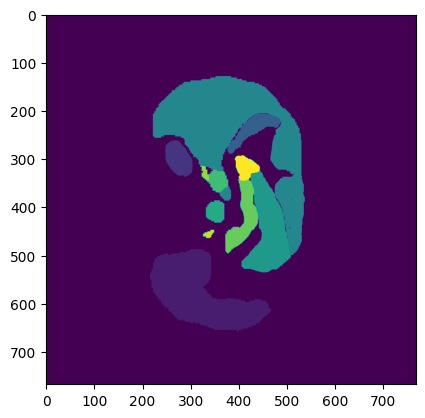

Slice number:  82


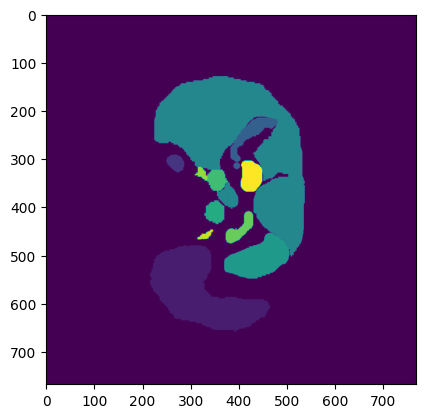

Slice number:  83


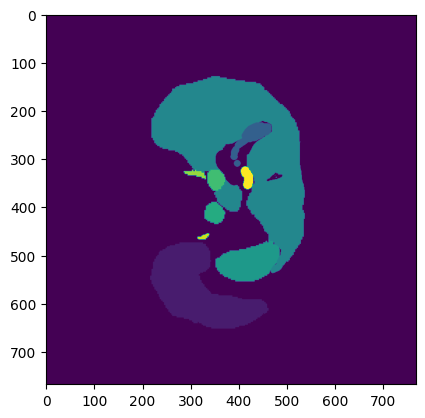

Slice number:  84


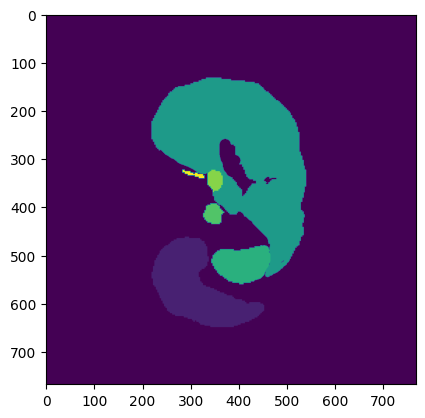

Slice number:  85


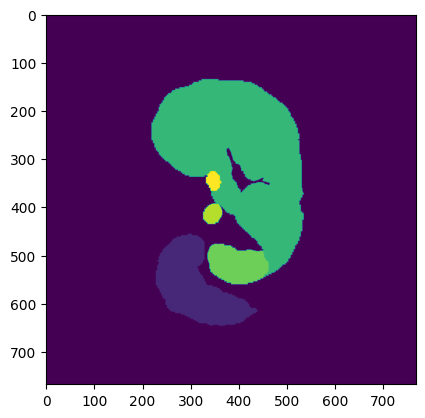

Slice number:  86


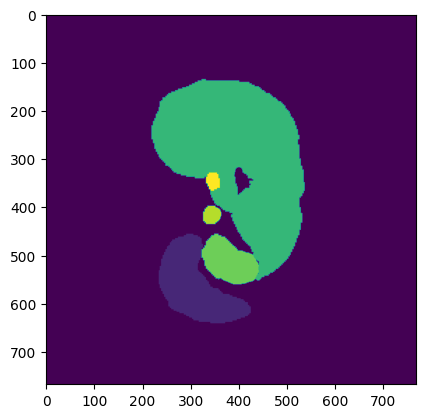

Slice number:  87


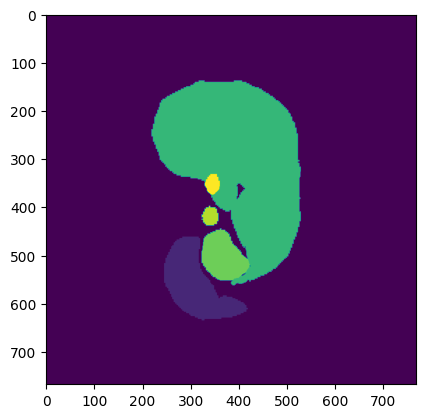

Slice number:  88


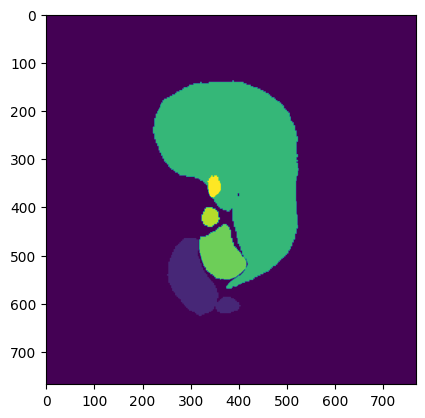

Slice number:  89


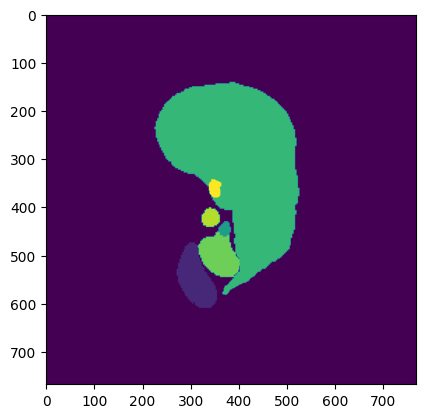

Slice number:  90


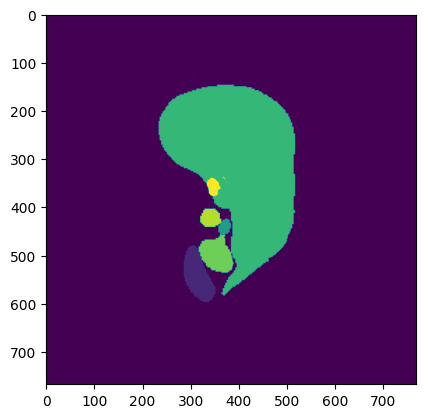

Slice number:  91


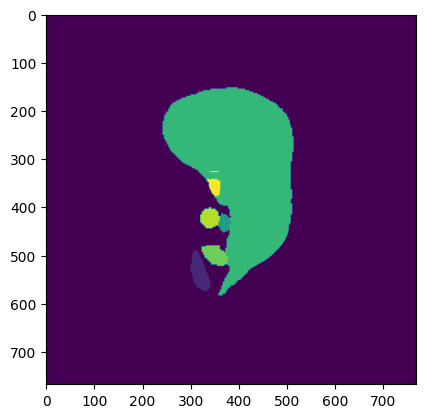

Slice number:  92


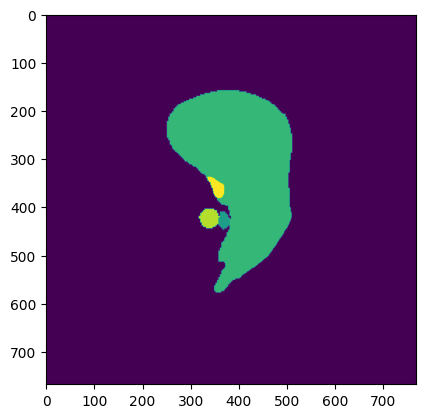

Slice number:  93


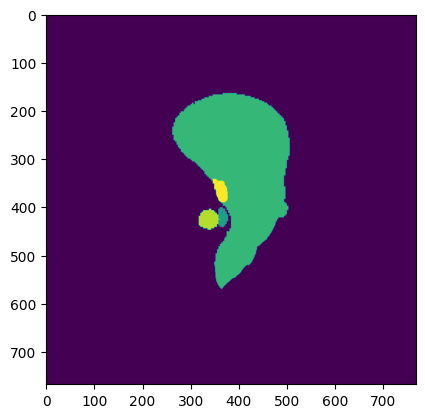

Slice number:  94


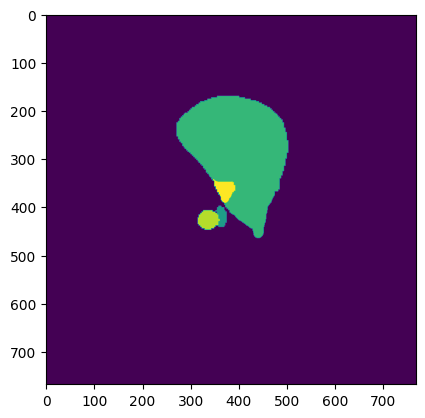

Slice number:  95


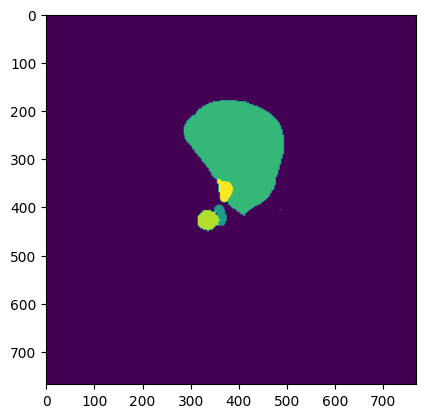

Slice number:  96


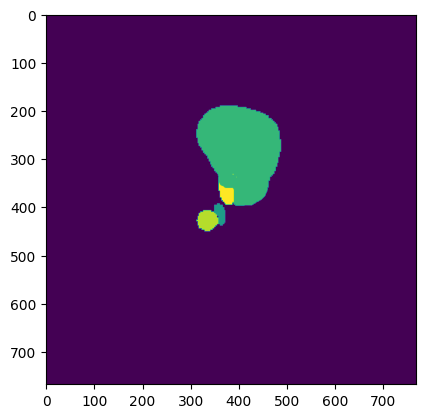

Slice number:  97


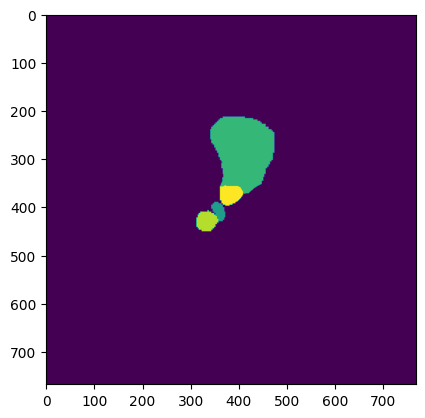

Slice number:  98


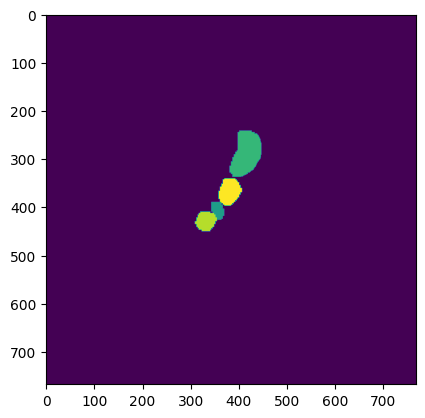

Slice number:  99


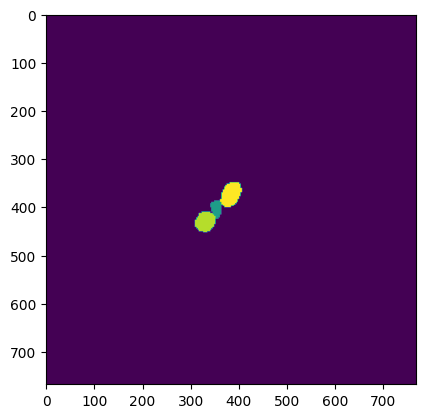

Slice number:  100


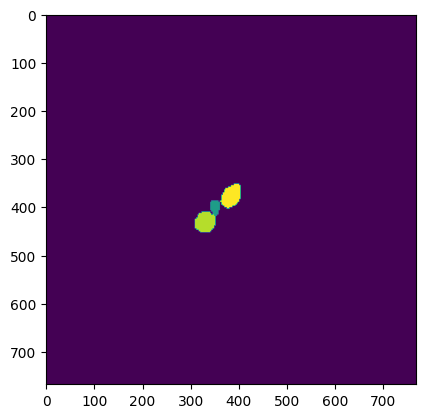

Slice number:  101


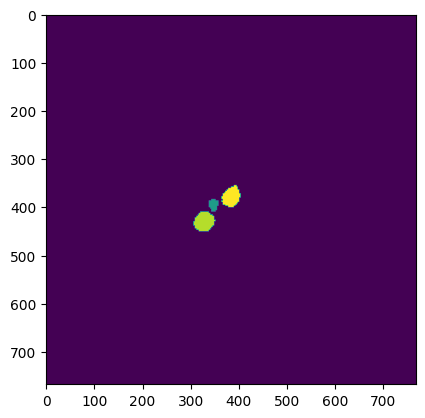

Slice number:  102


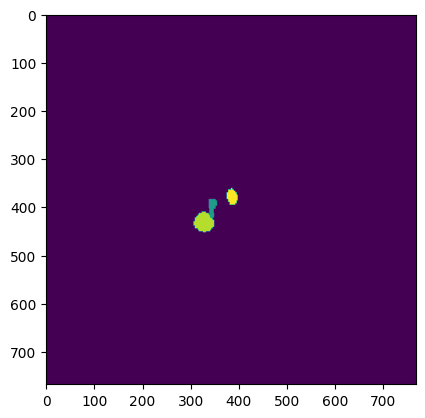

Slice number:  103


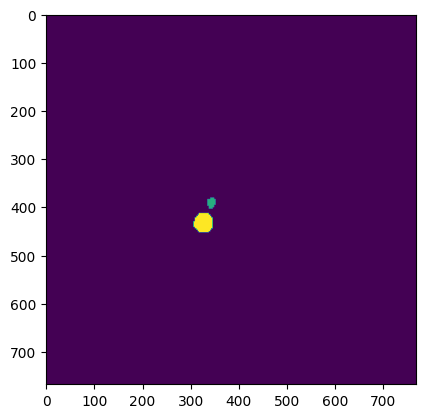

Slice number:  104


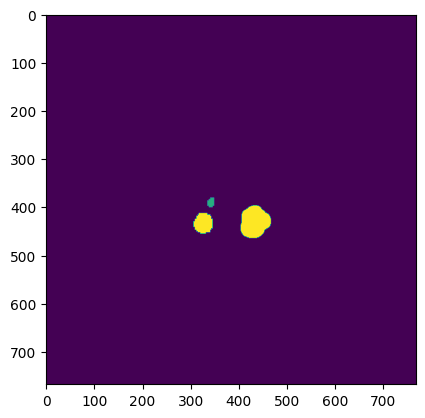

Slice number:  105


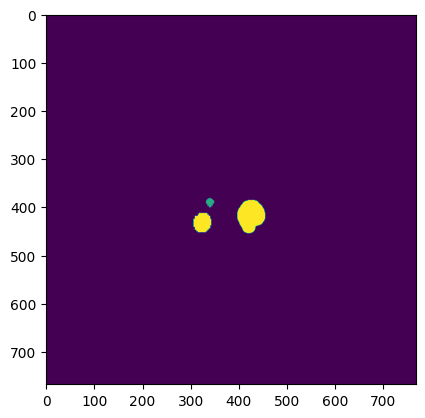

Slice number:  106


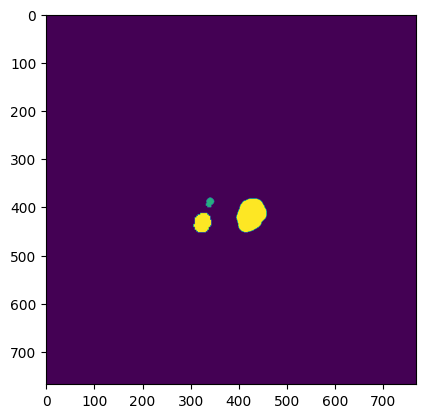

In [19]:
img007, ndt007 = getScan('labelsTr/amos_0007.nii.gz')
printSlice(ndt007)

Slice number:  0


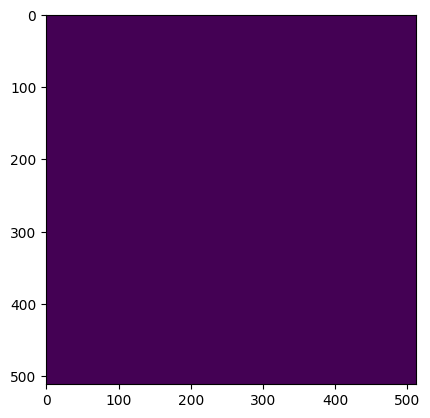

Slice number:  1


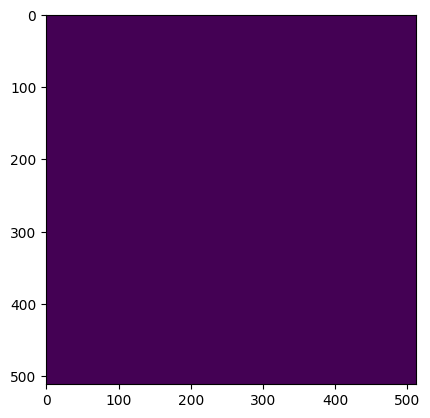

Slice number:  2


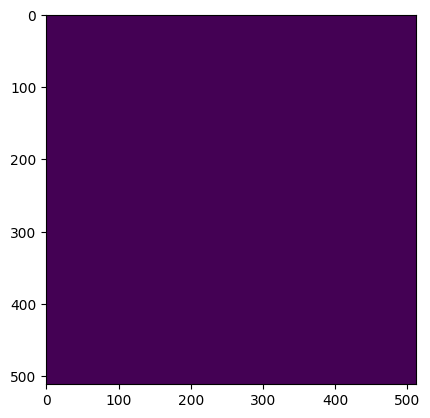

Slice number:  3


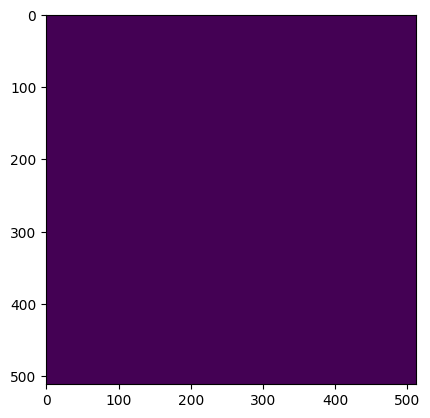

Slice number:  4


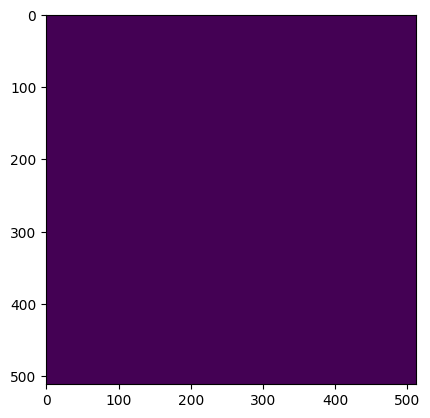

Slice number:  5


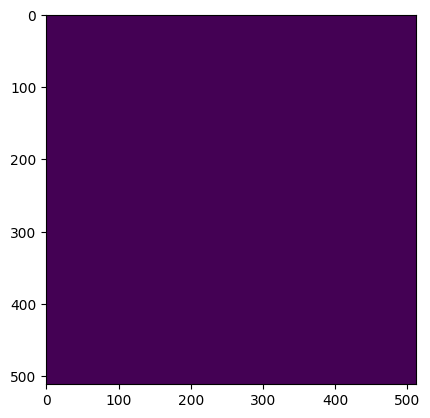

Slice number:  6


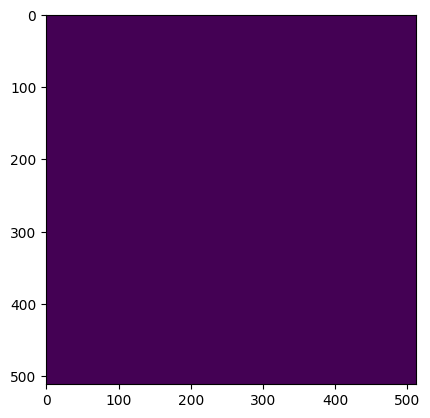

Slice number:  7


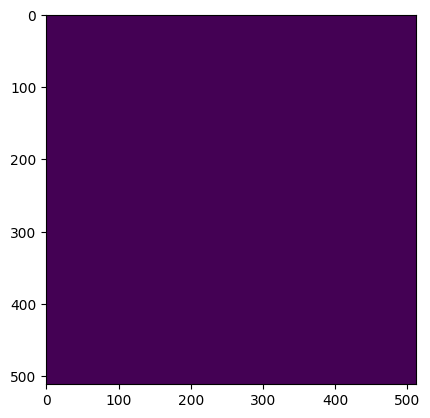

Slice number:  8


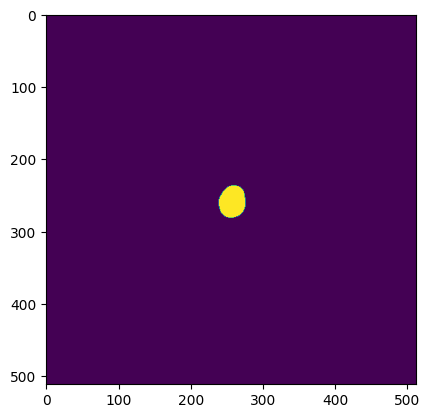

Slice number:  9


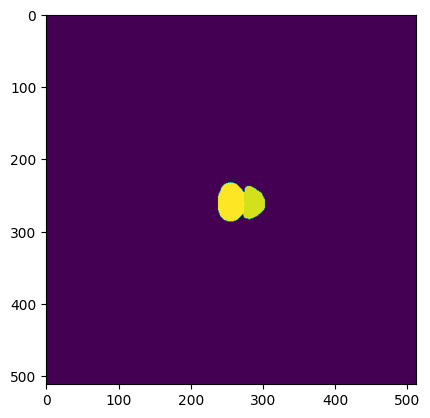

Slice number:  10


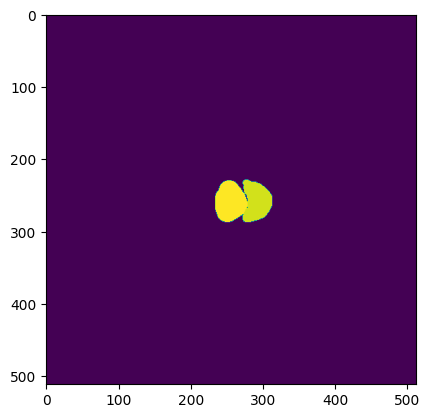

Slice number:  11


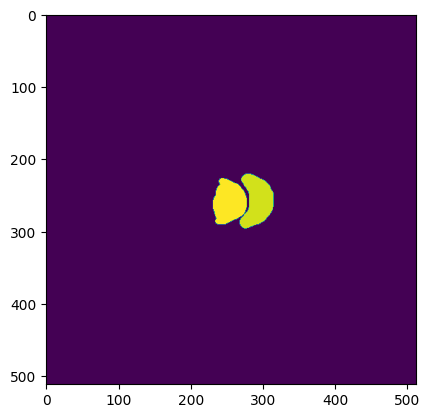

Slice number:  12


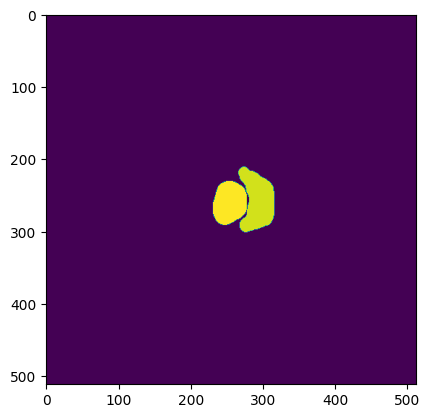

Slice number:  13


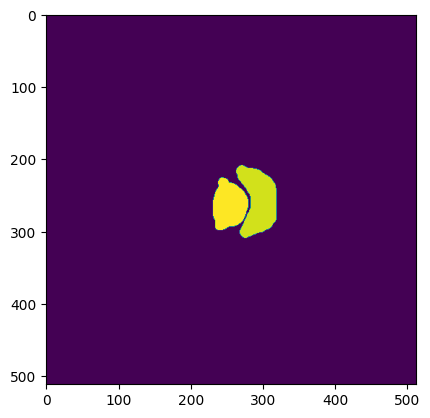

Slice number:  14


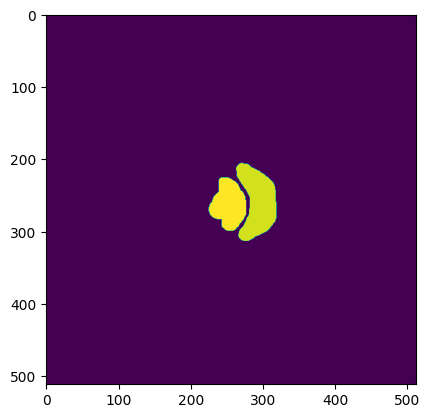

Slice number:  15


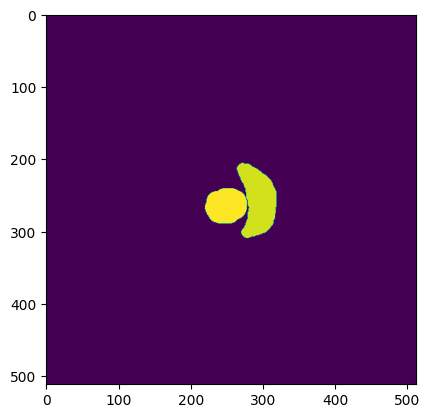

Slice number:  16


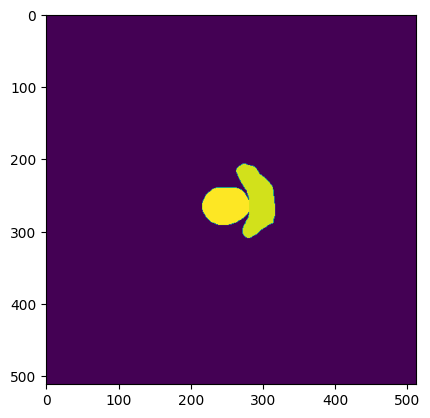

Slice number:  17


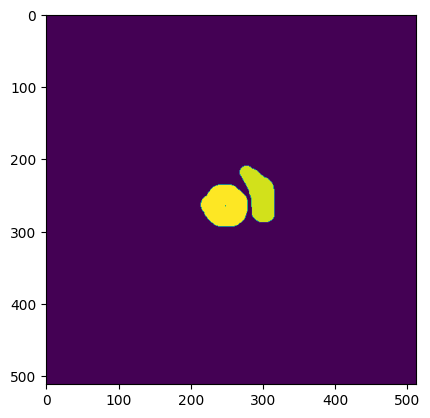

Slice number:  18


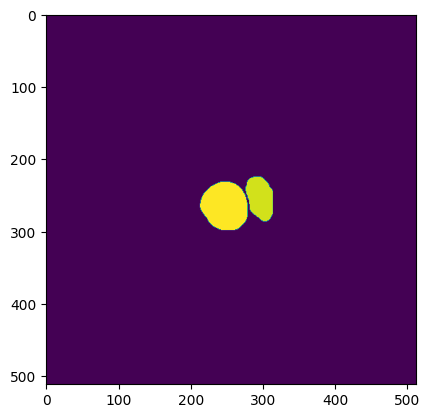

Slice number:  19


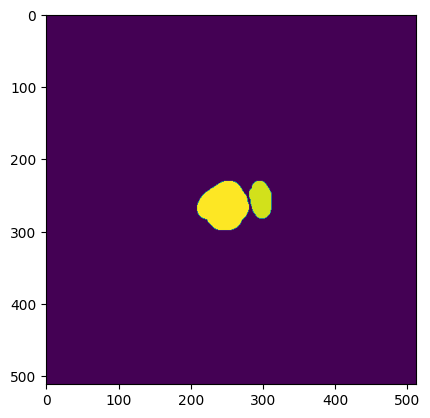

Slice number:  20


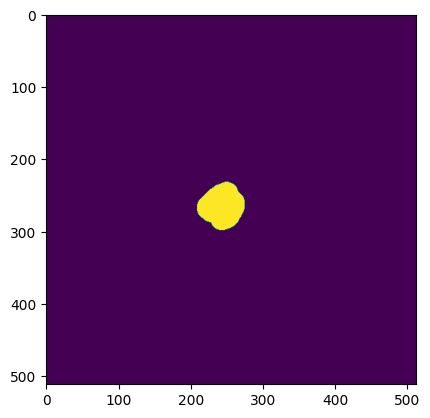

Slice number:  21


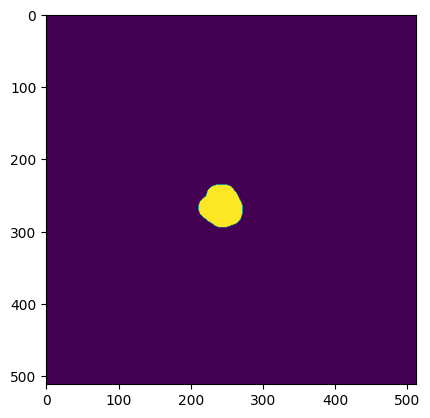

Slice number:  22


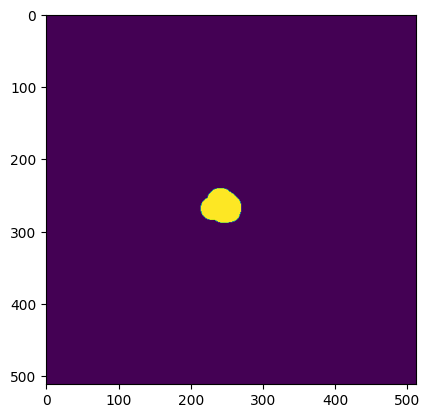

Slice number:  23


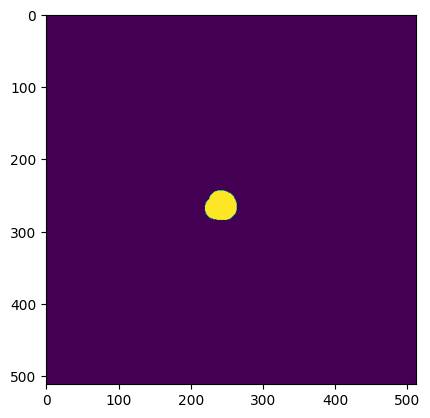

Slice number:  24


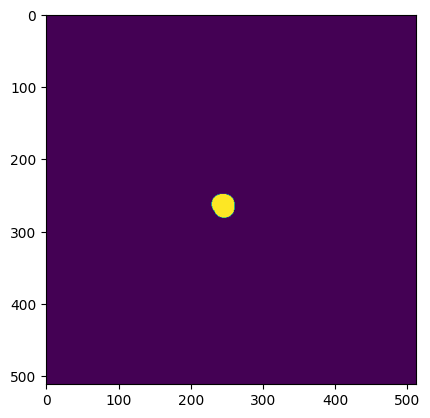

Slice number:  25


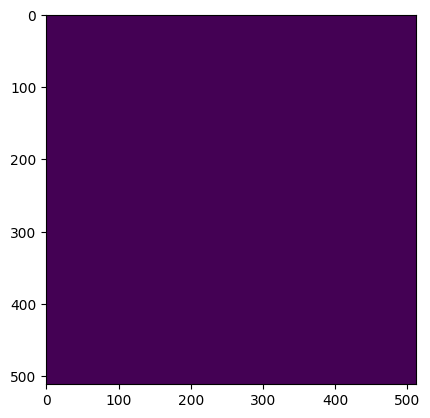

Slice number:  26


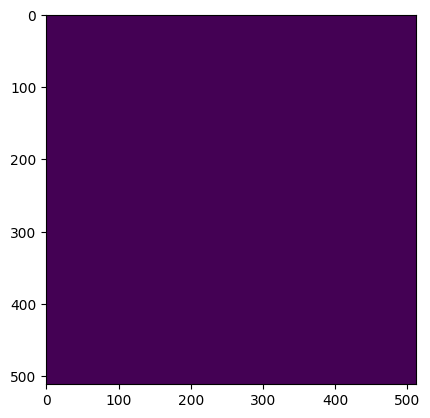

Slice number:  27


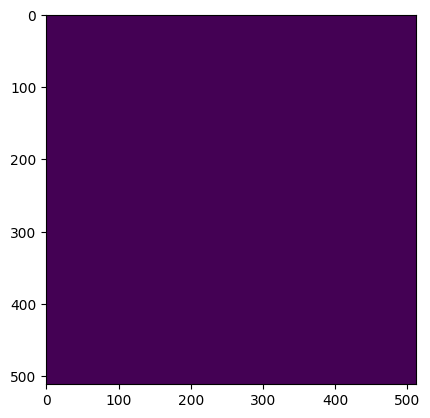

Slice number:  28


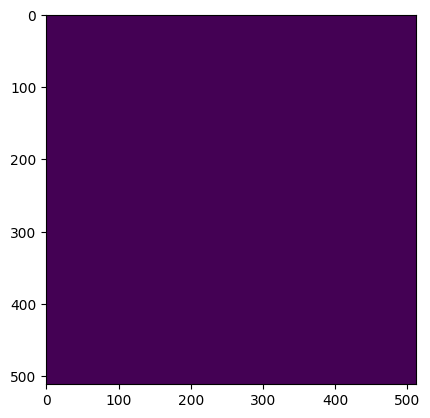

Slice number:  29


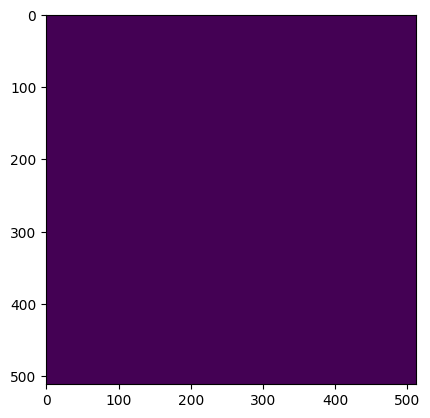

Slice number:  30


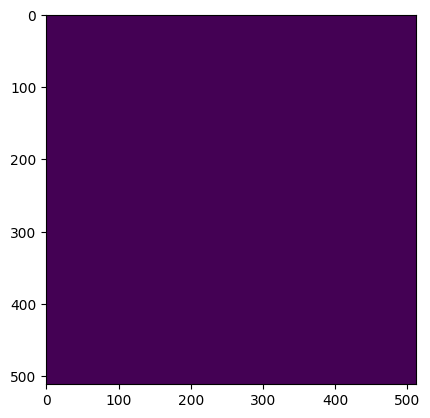

Slice number:  31


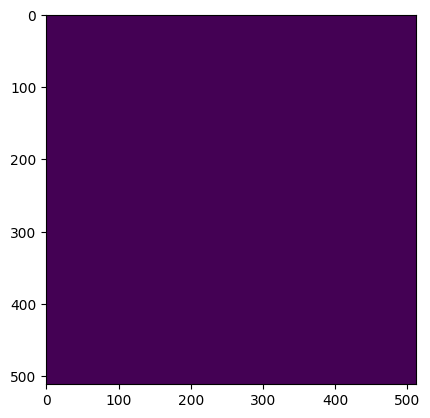

Slice number:  32


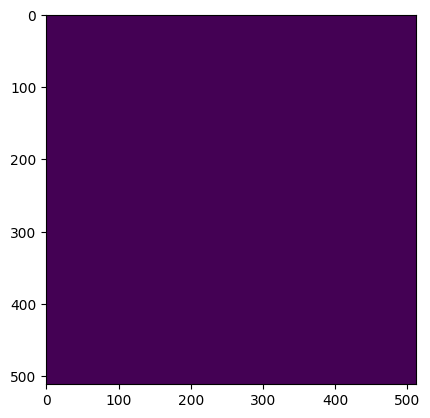

Slice number:  33


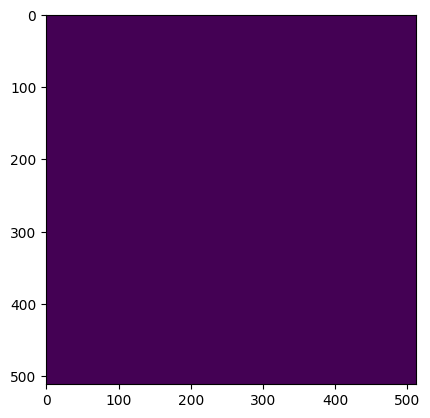

Slice number:  34


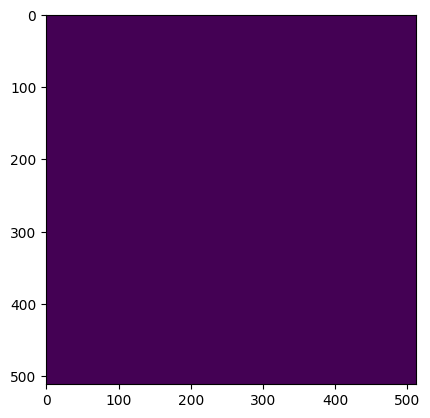

Slice number:  35


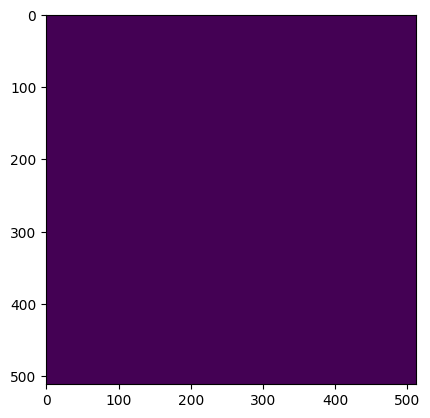

Slice number:  36


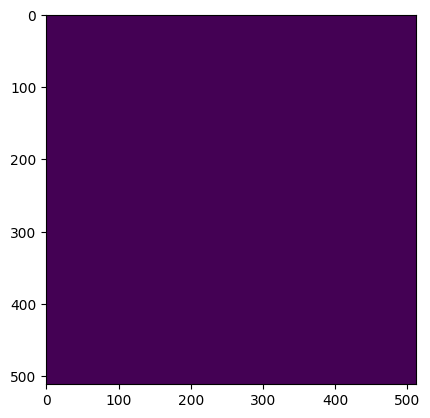

Slice number:  37


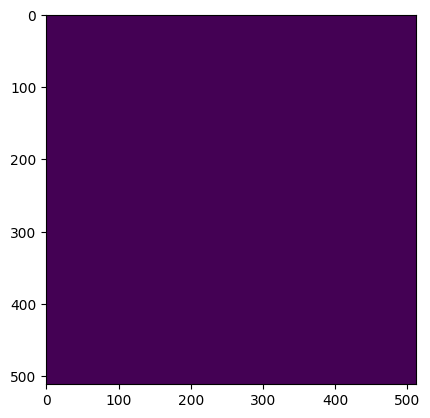

Slice number:  38


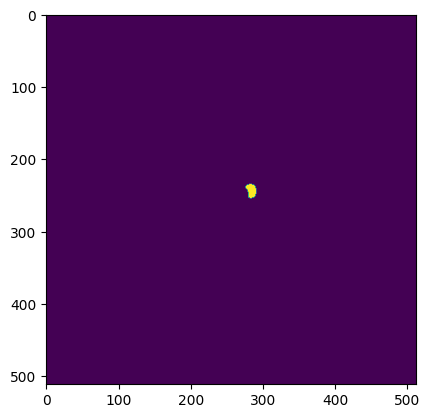

Slice number:  39


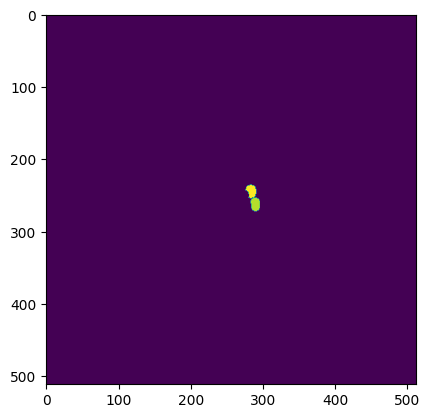

Slice number:  40


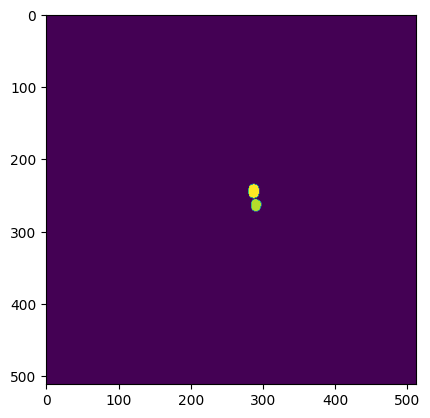

Slice number:  41


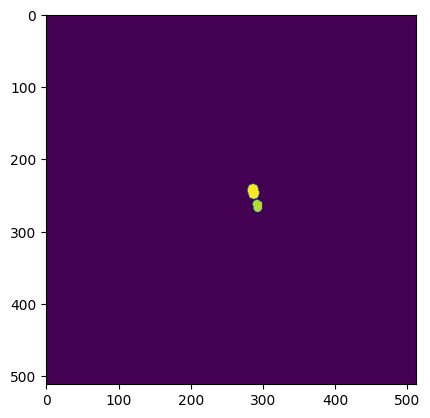

Slice number:  42


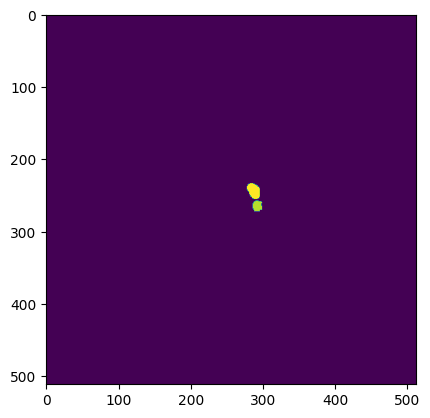

Slice number:  43


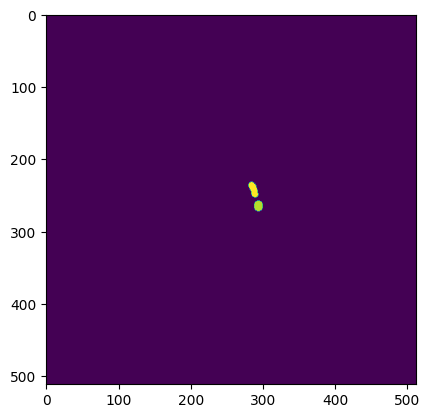

Slice number:  44


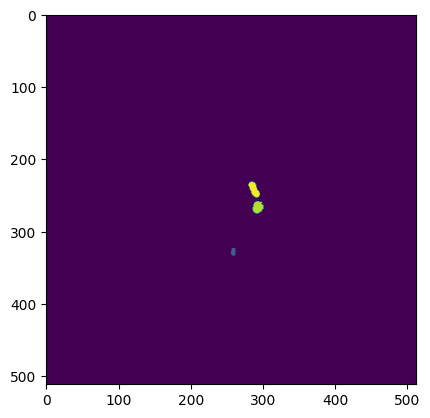

Slice number:  45


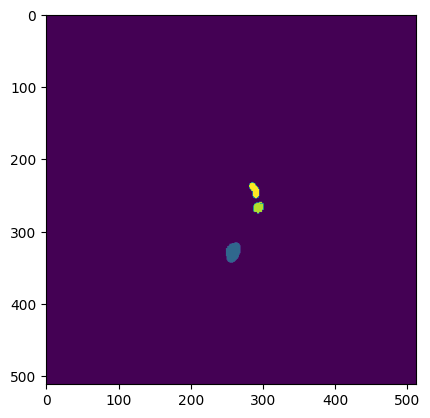

Slice number:  46


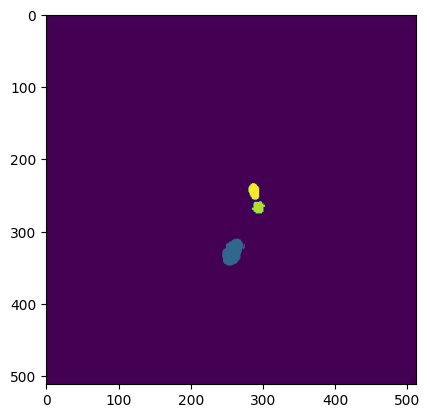

Slice number:  47


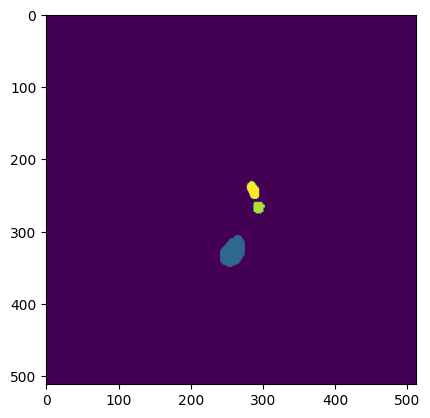

Slice number:  48


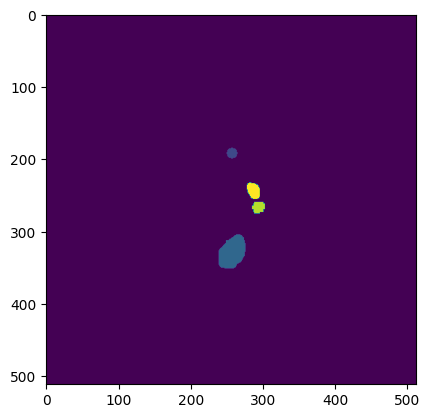

Slice number:  49


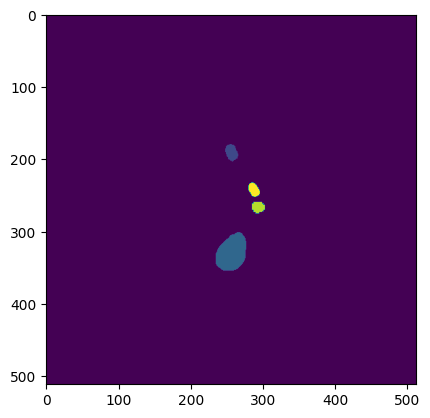

Slice number:  50


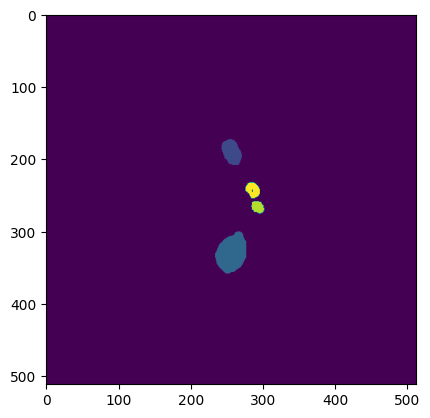

Slice number:  51


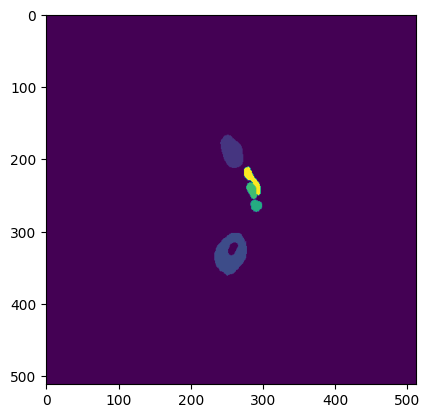

Slice number:  52


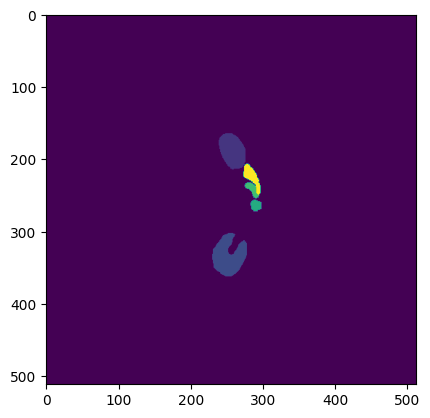

Slice number:  53


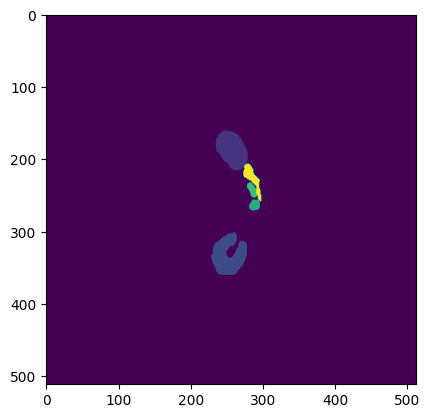

Slice number:  54


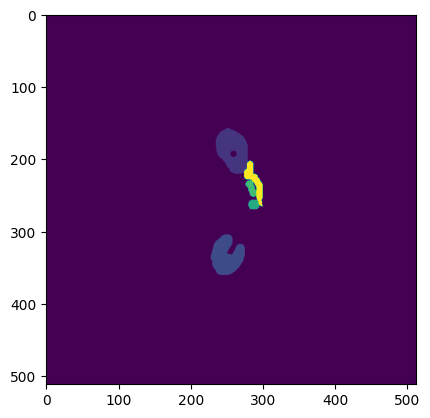

Slice number:  55


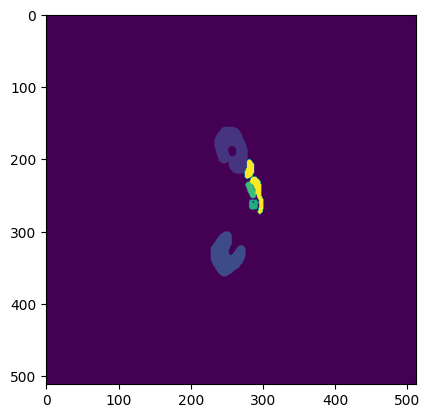

Slice number:  56


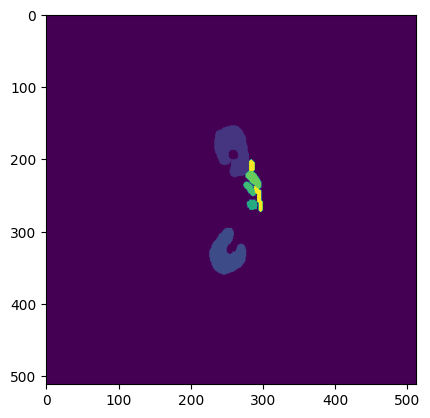

Slice number:  57


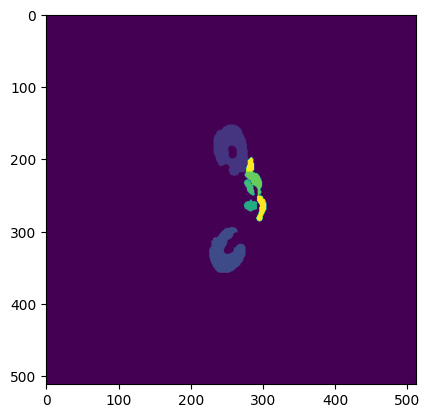

Slice number:  58


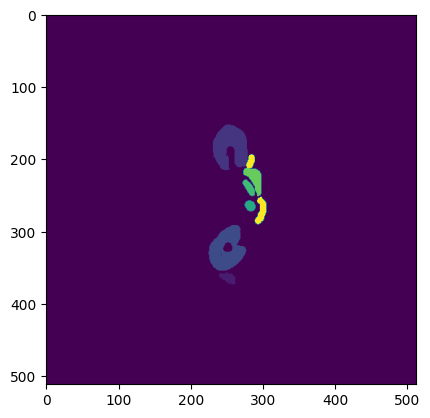

Slice number:  59


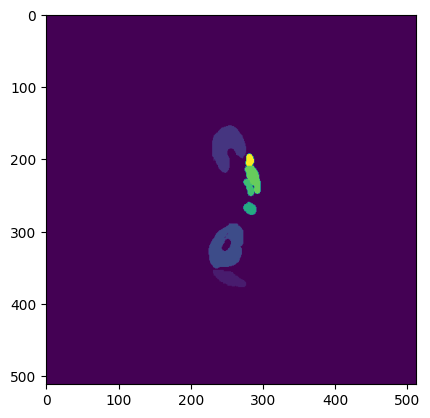

Slice number:  60


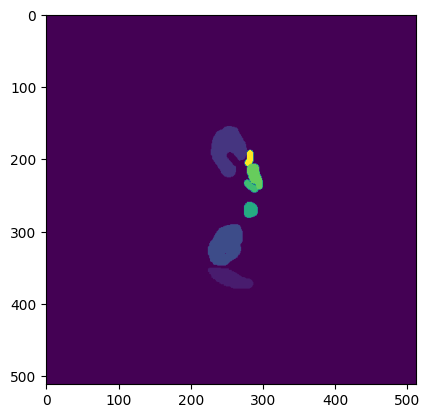

Slice number:  61


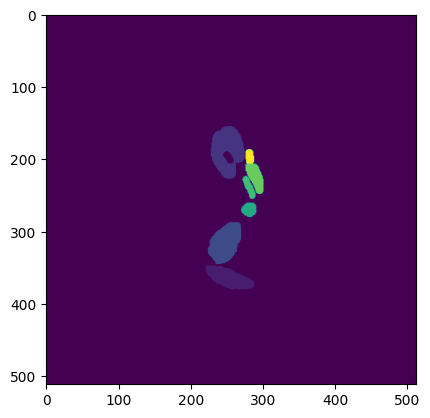

Slice number:  62


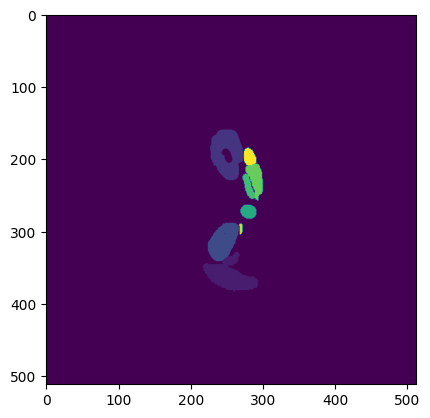

Slice number:  63


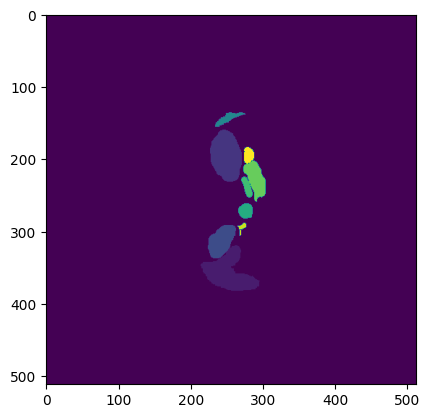

Slice number:  64


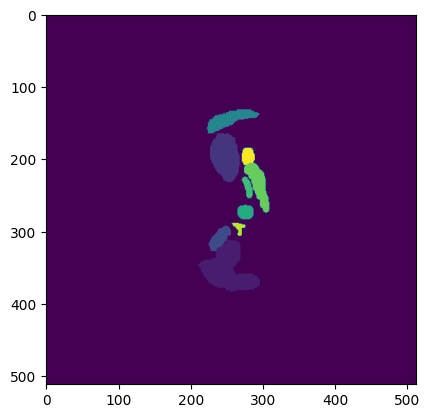

Slice number:  65


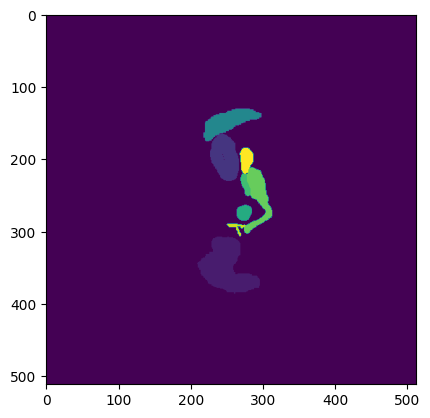

Slice number:  66


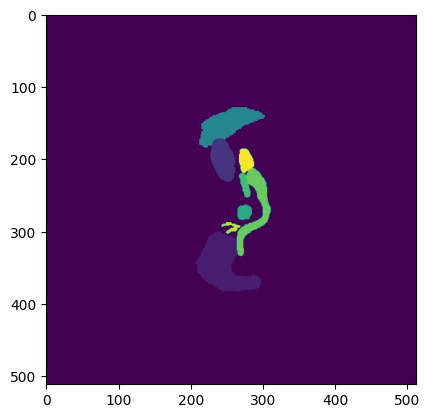

Slice number:  67


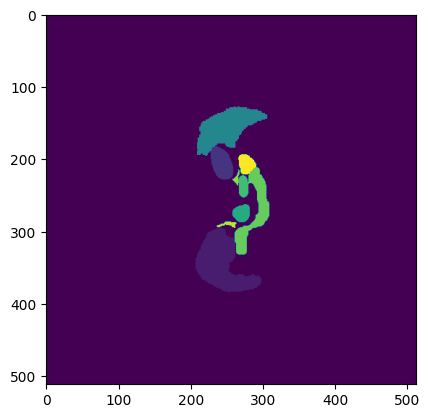

Slice number:  68


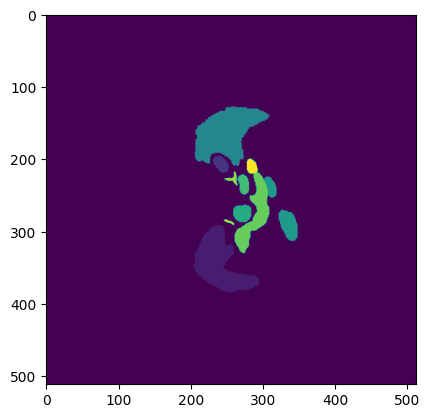

Slice number:  69


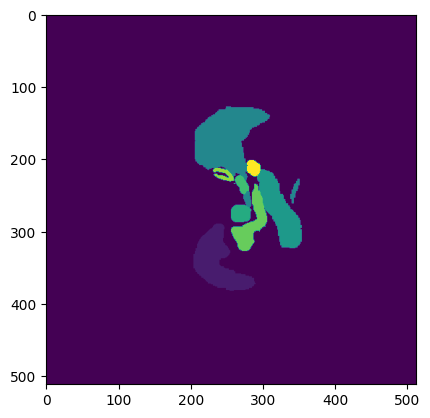

Slice number:  70


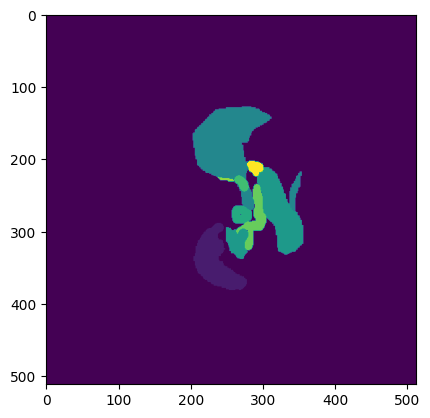

Slice number:  71


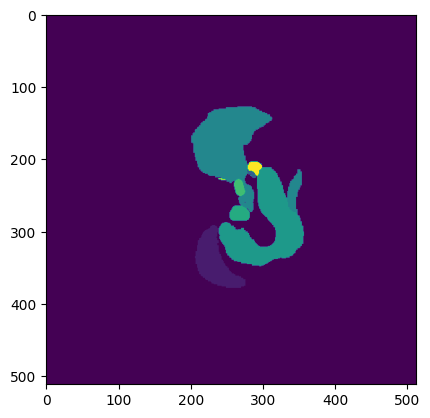

Slice number:  72


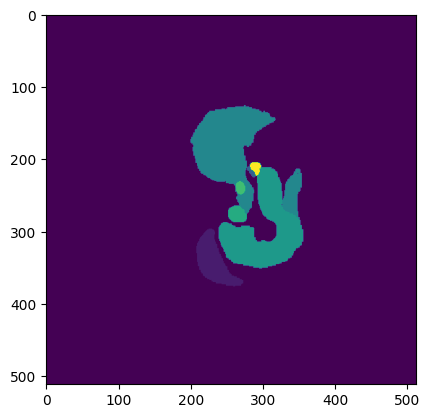

Slice number:  73


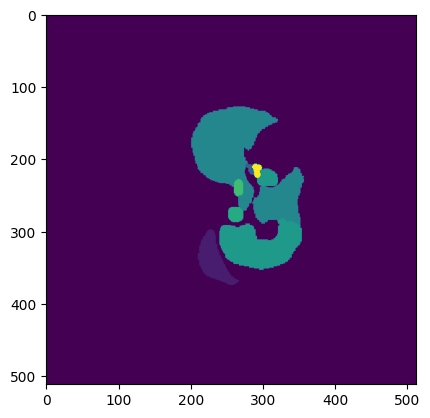

Slice number:  74


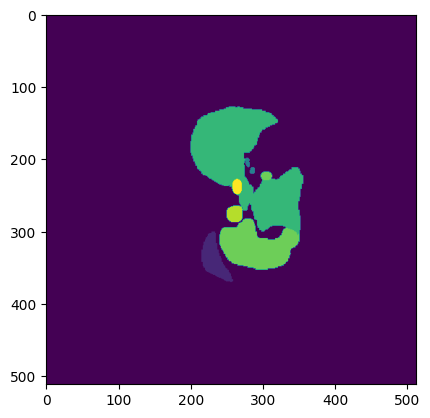

Slice number:  75


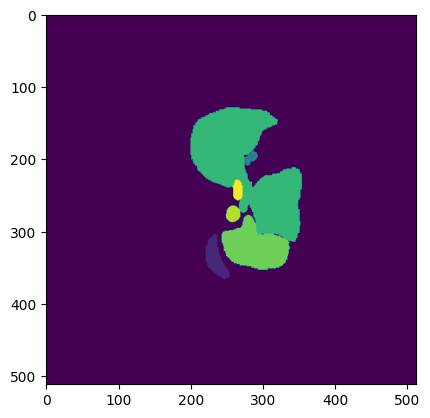

Slice number:  76


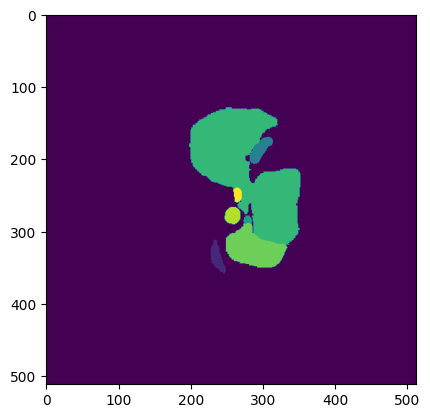

Slice number:  77


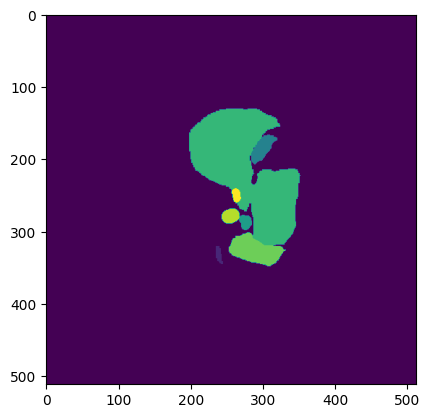

Slice number:  78


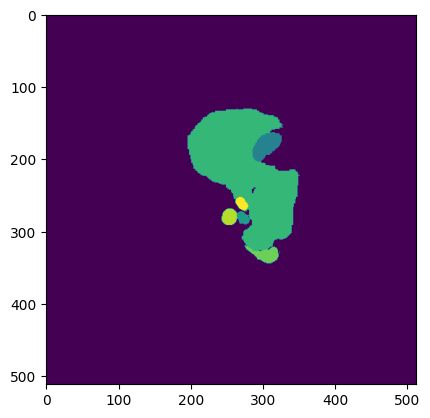

Slice number:  79


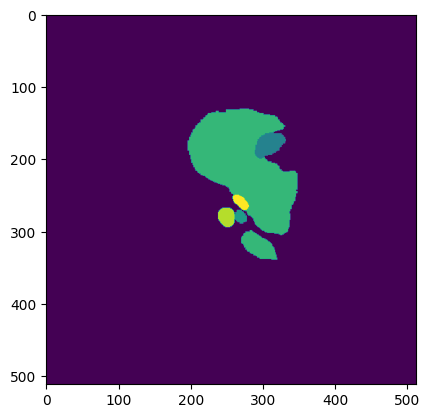

Slice number:  80


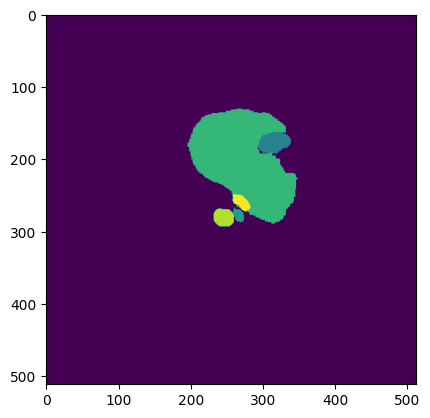

Slice number:  81


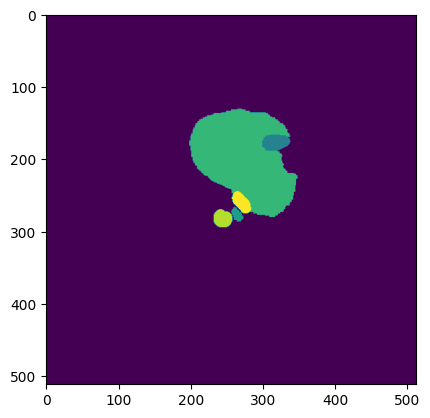

Slice number:  82


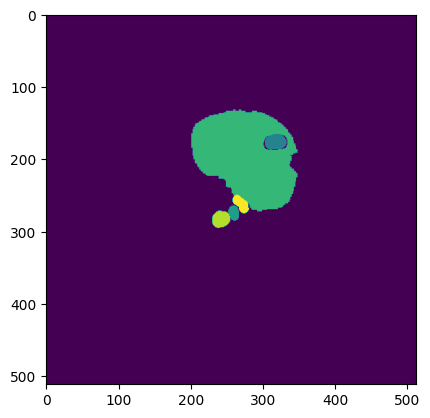

Slice number:  83


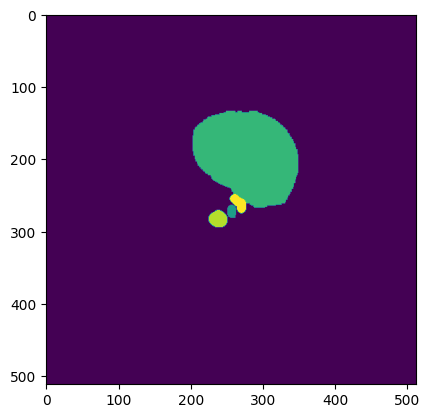

Slice number:  84


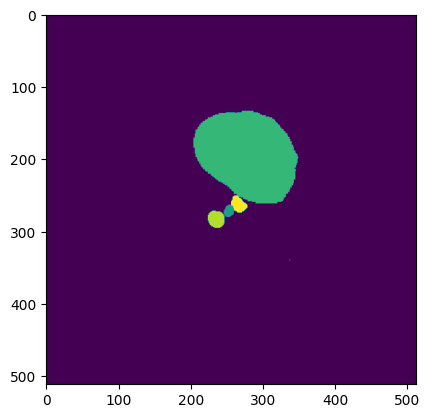

Slice number:  85


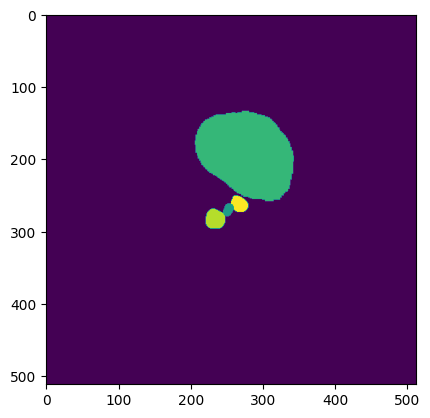

Slice number:  86


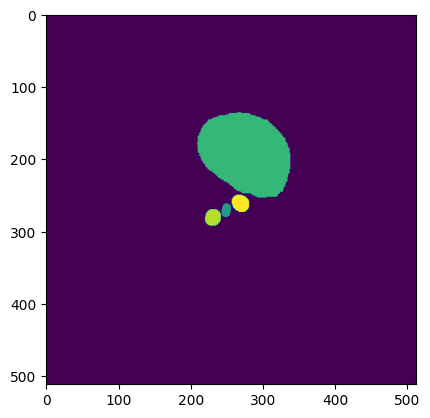

Slice number:  87


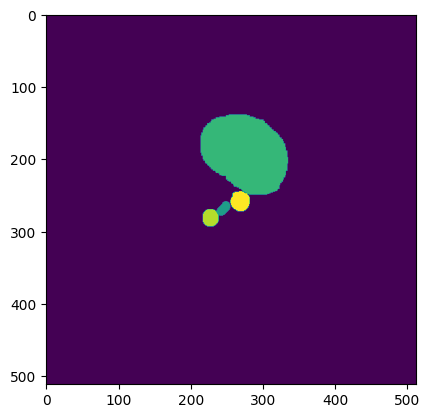

Slice number:  88


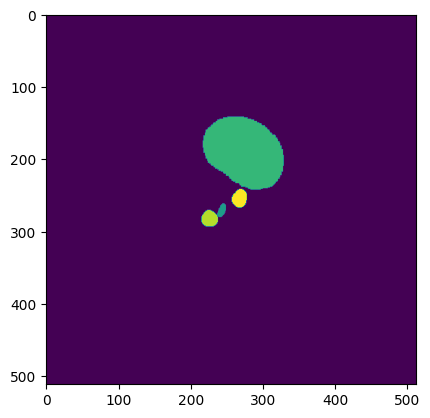

Slice number:  89


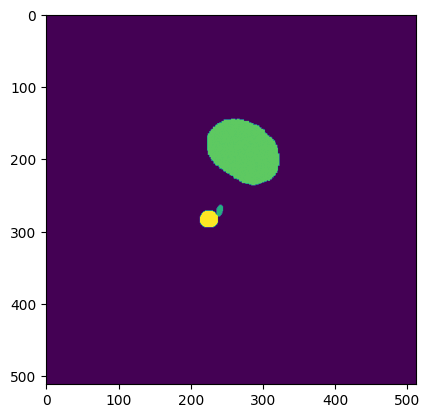

Slice number:  90


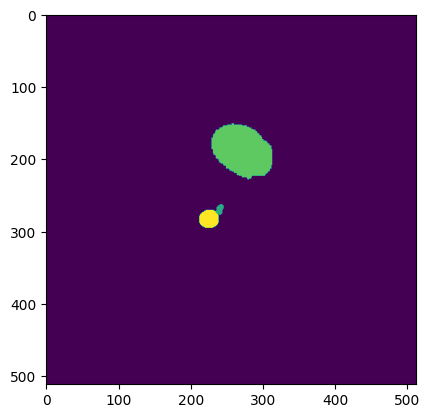

Slice number:  91


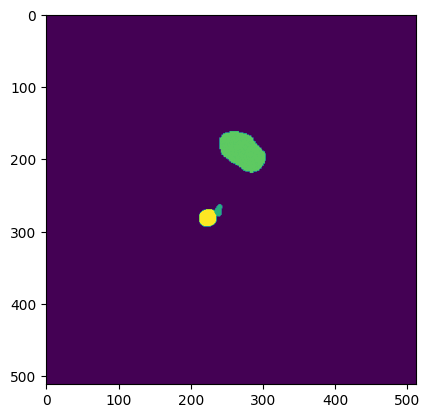

Slice number:  92


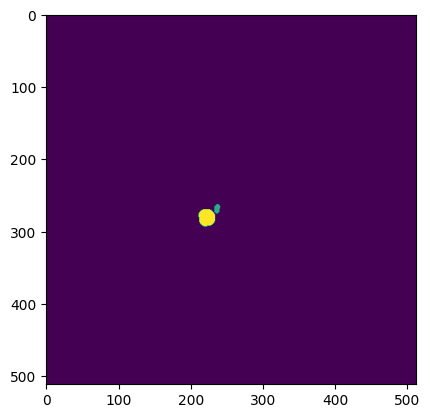

In [20]:
img035, ndt035 = getScan('labelsTr/amos_0035.nii.gz')
printSlice(ndt035)

Slice number:  0


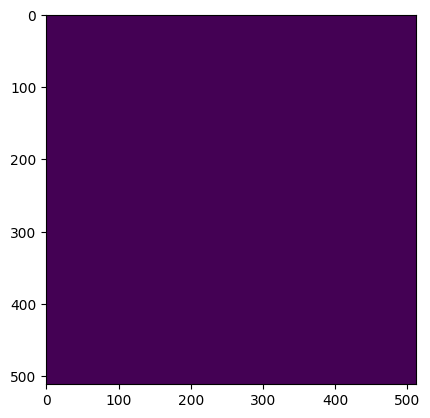

Slice number:  1


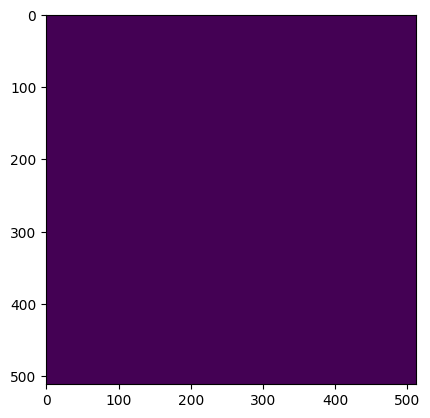

Slice number:  2


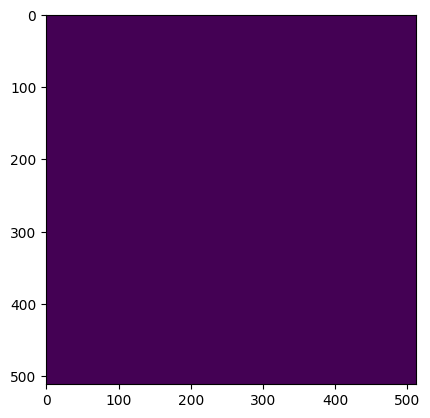

Slice number:  3


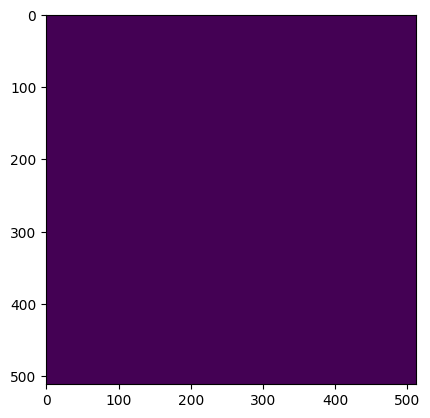

Slice number:  4


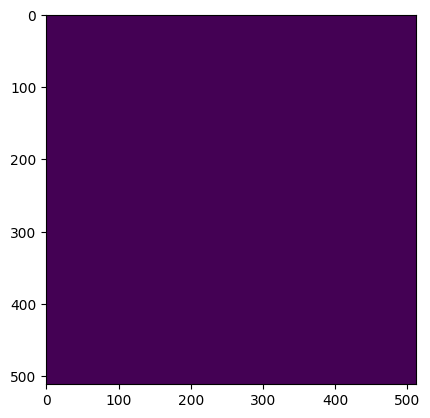

Slice number:  5


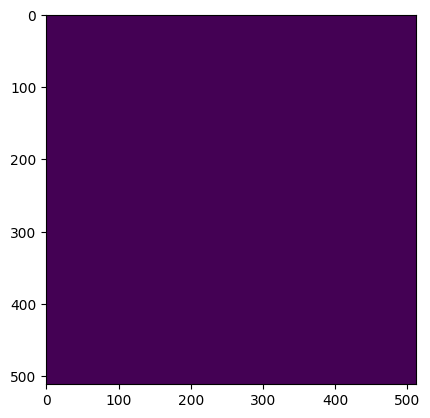

Slice number:  6


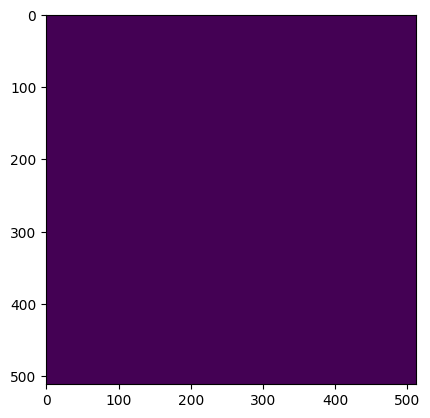

Slice number:  7


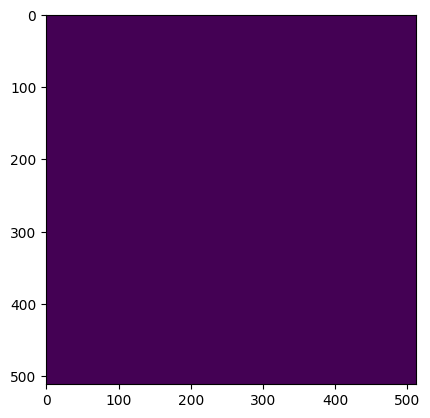

Slice number:  8


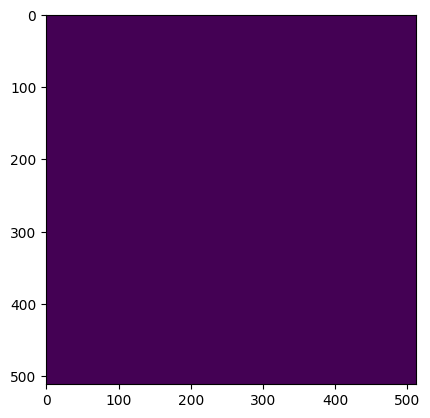

Slice number:  9


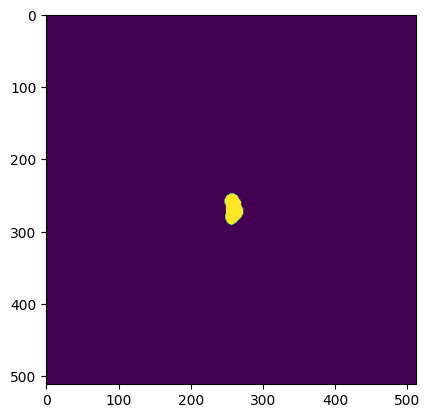

Slice number:  10


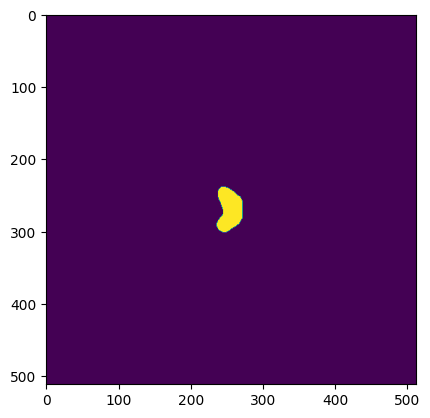

Slice number:  11


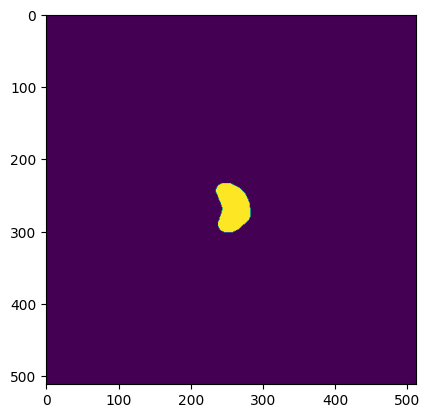

Slice number:  12


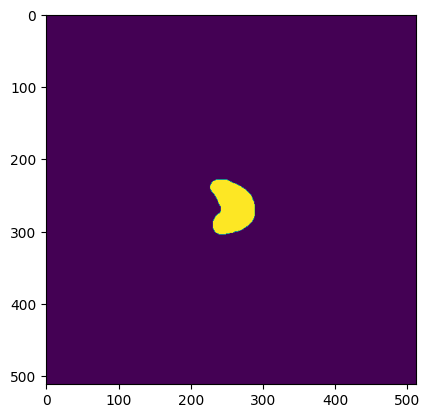

Slice number:  13


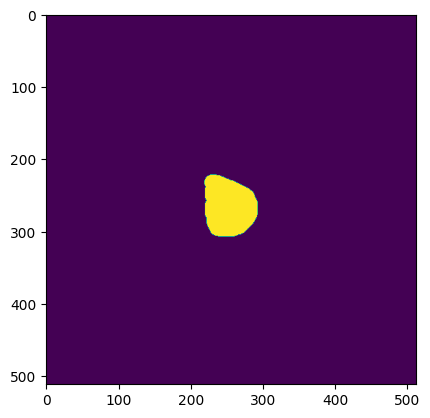

Slice number:  14


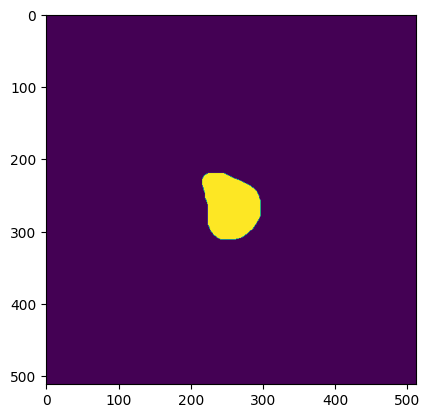

Slice number:  15


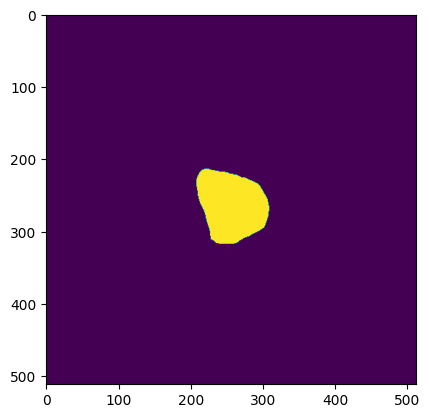

Slice number:  16


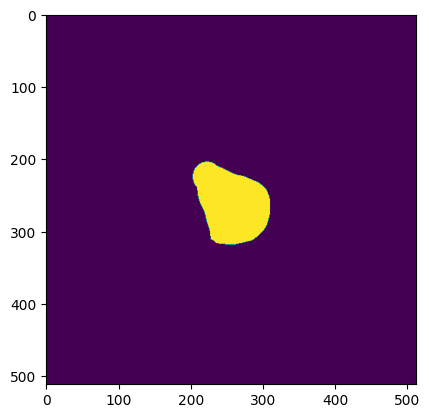

Slice number:  17


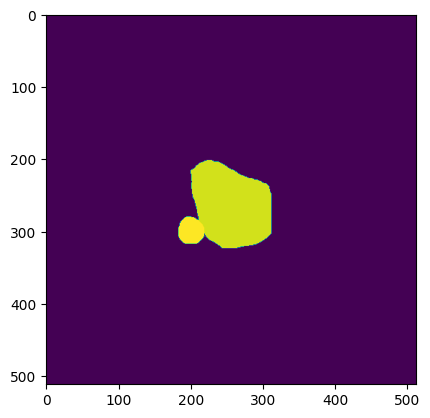

Slice number:  18


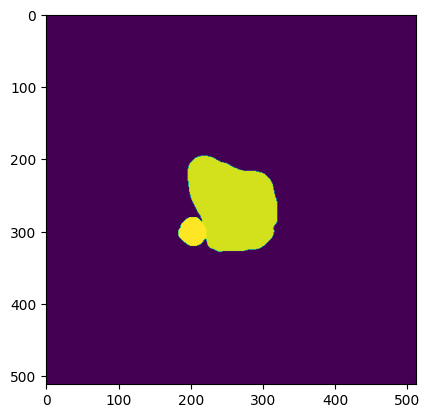

Slice number:  19


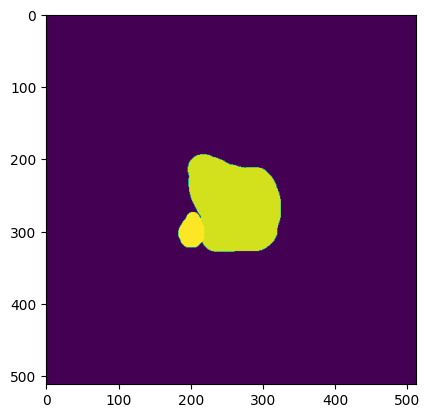

Slice number:  20


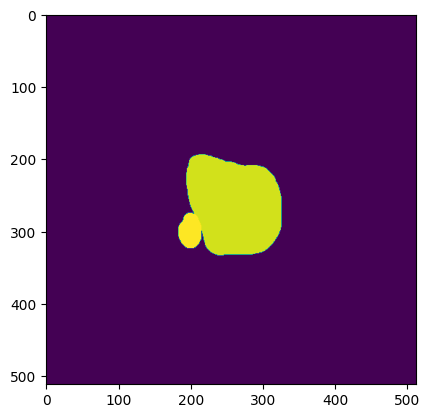

Slice number:  21


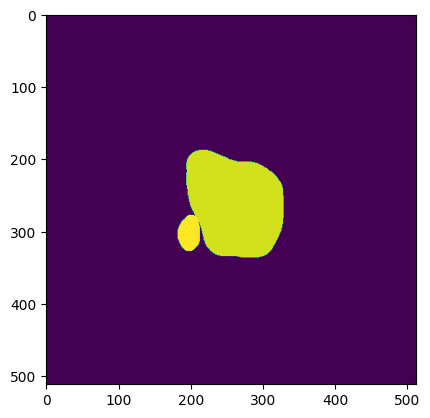

Slice number:  22


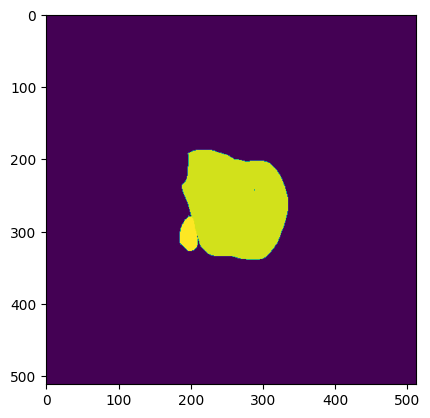

Slice number:  23


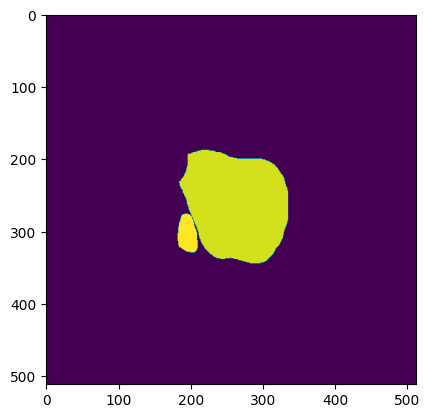

Slice number:  24


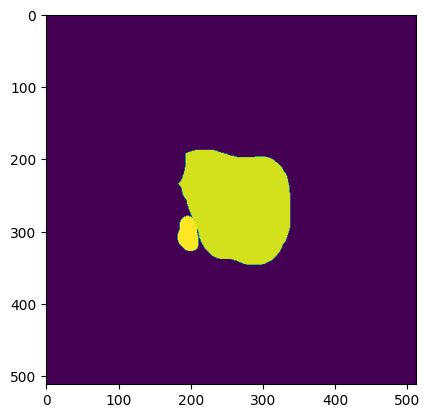

Slice number:  25


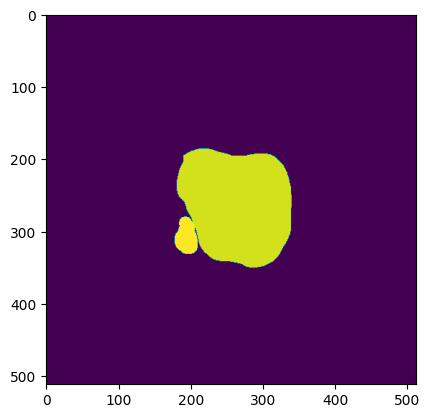

Slice number:  26


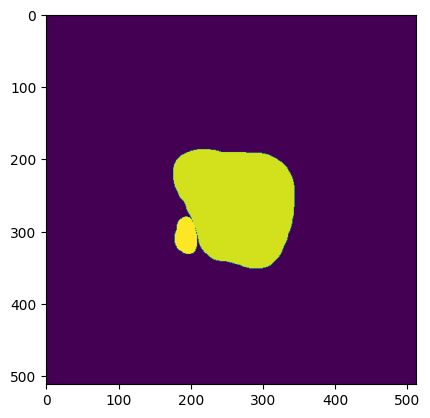

Slice number:  27


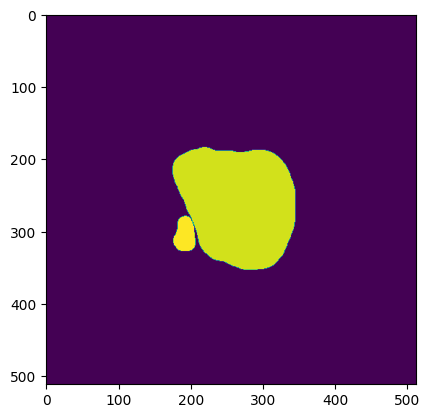

Slice number:  28


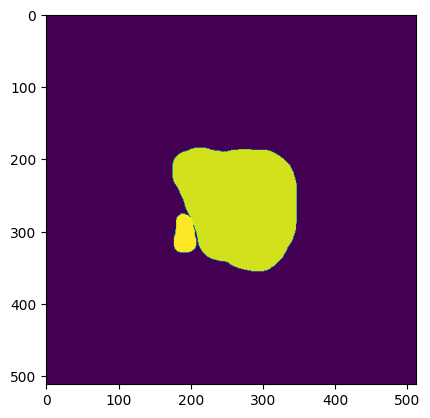

Slice number:  29


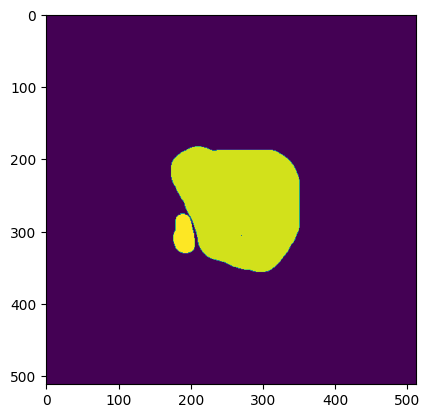

Slice number:  30


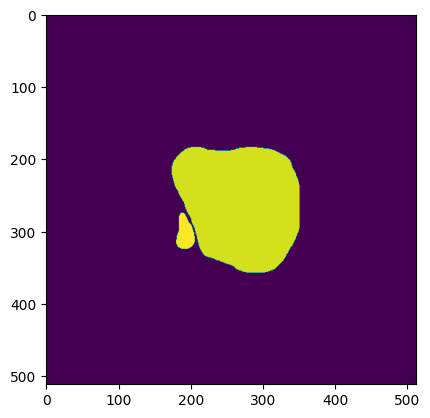

Slice number:  31


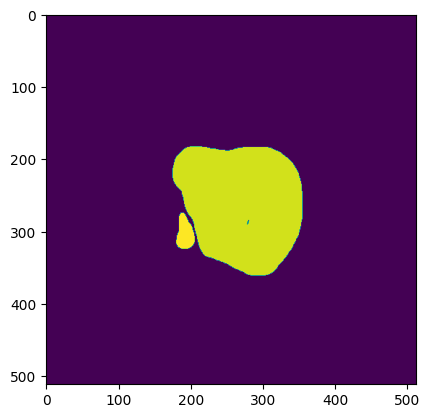

Slice number:  32


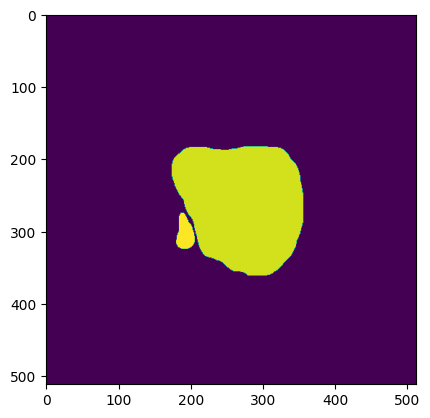

Slice number:  33


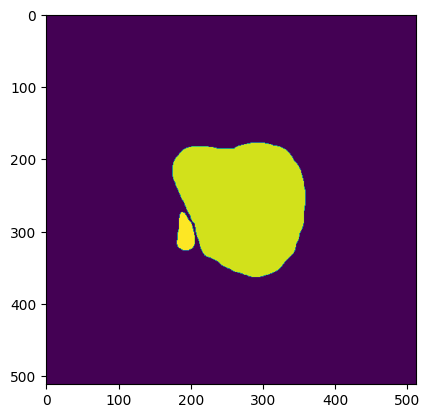

Slice number:  34


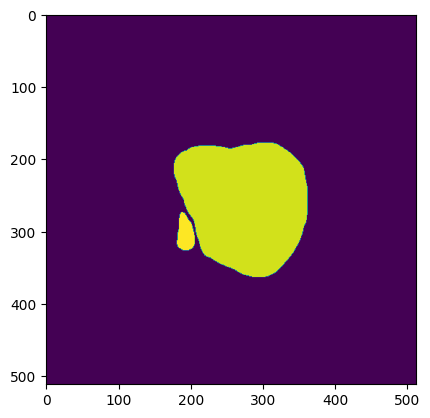

Slice number:  35


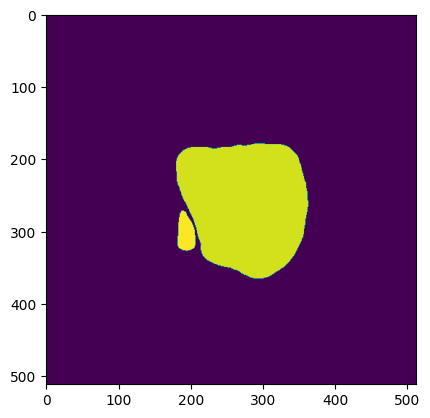

Slice number:  36


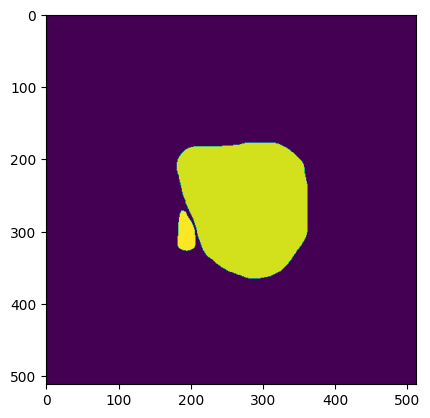

Slice number:  37


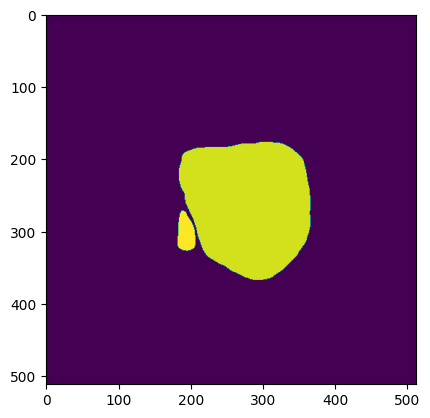

Slice number:  38


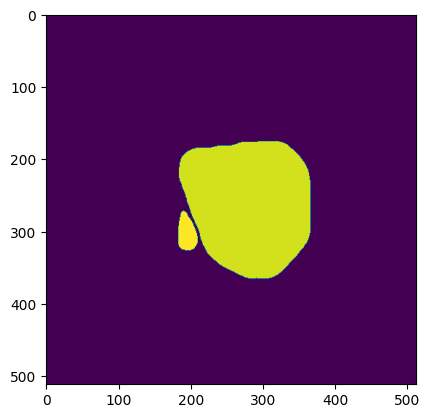

Slice number:  39


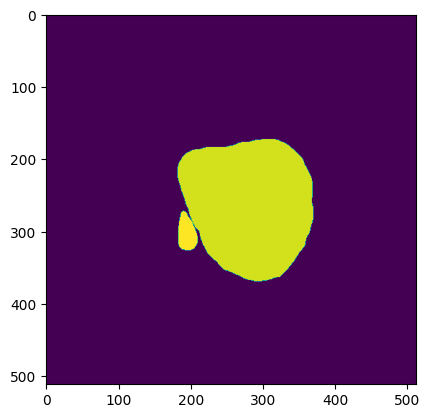

Slice number:  40


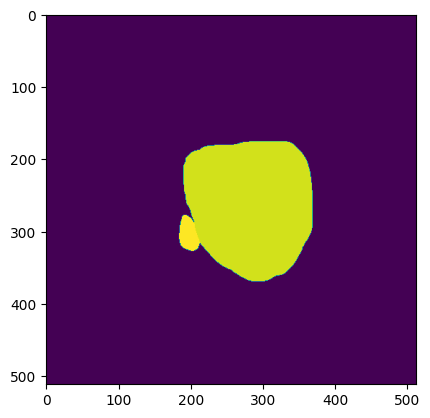

Slice number:  41


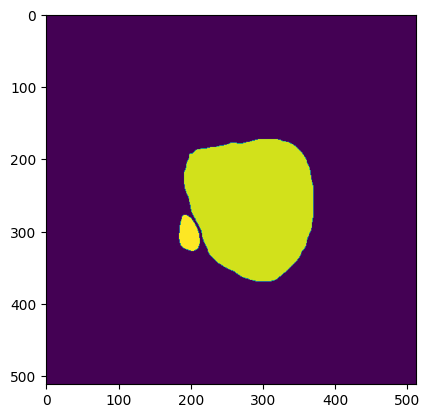

Slice number:  42


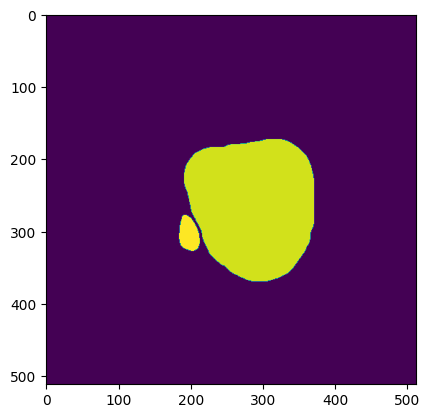

Slice number:  43


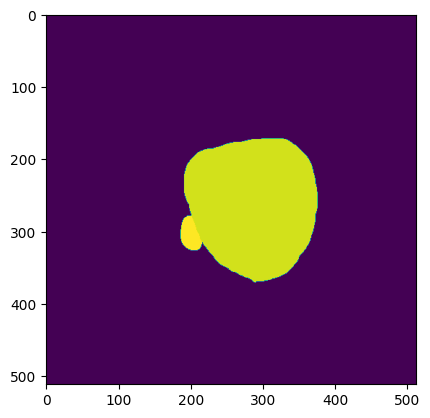

Slice number:  44


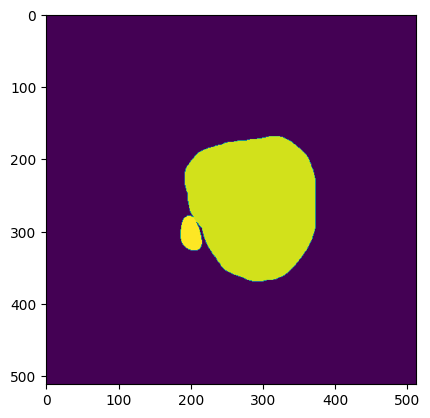

Slice number:  45


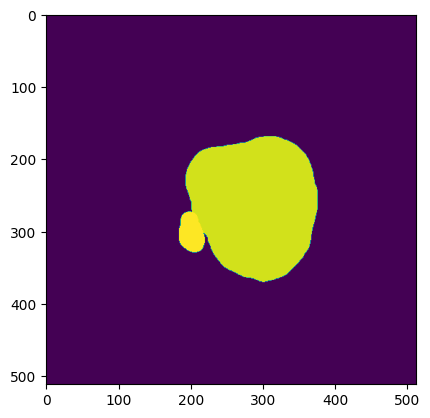

Slice number:  46


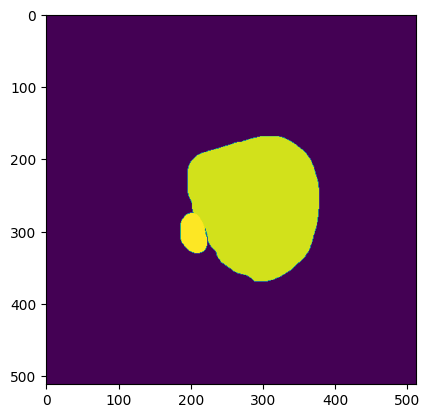

Slice number:  47


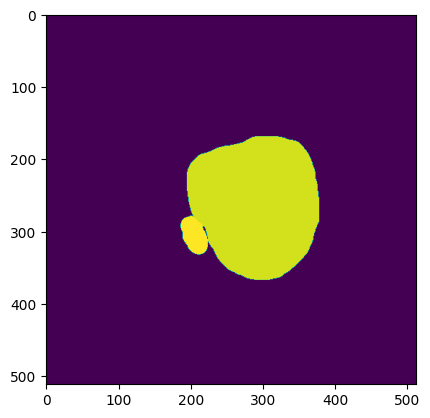

Slice number:  48


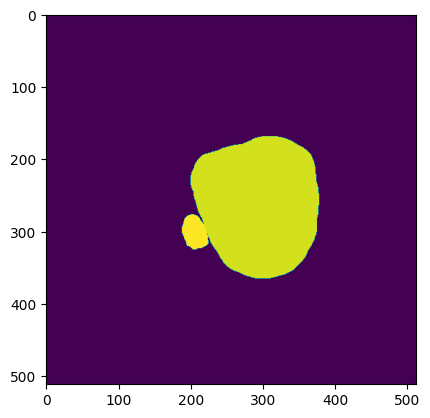

Slice number:  49


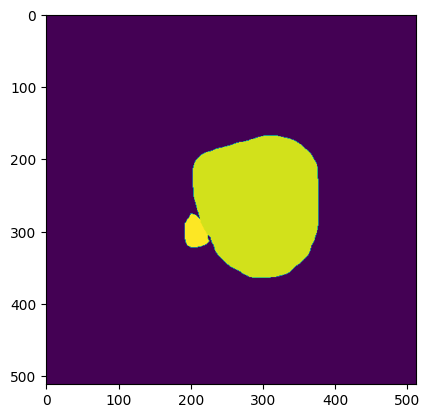

Slice number:  50


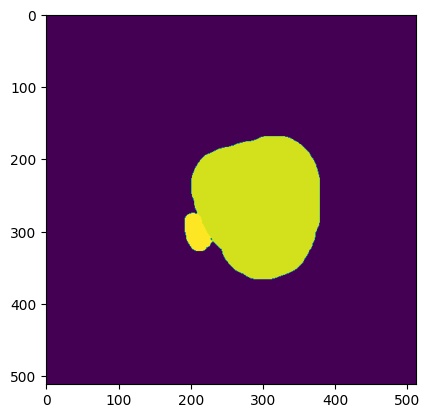

Slice number:  51


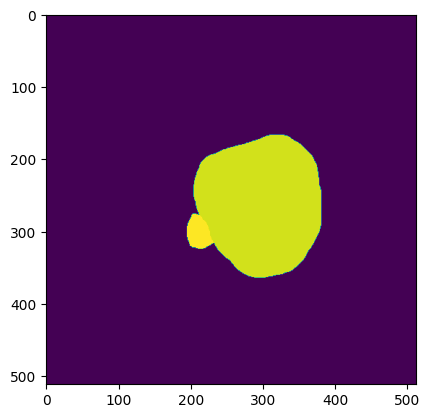

Slice number:  52


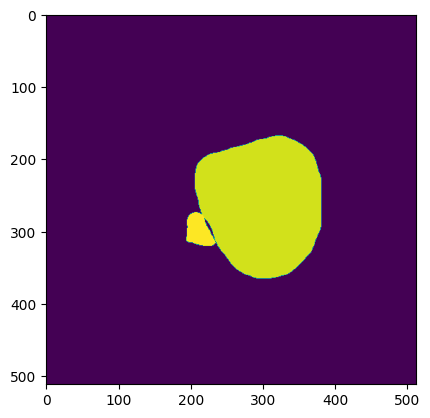

Slice number:  53


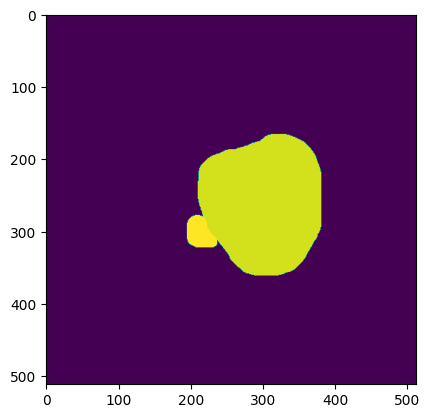

Slice number:  54


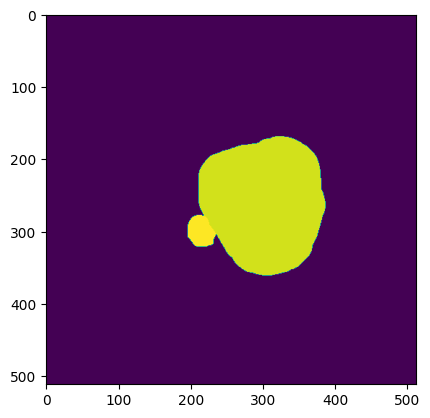

Slice number:  55


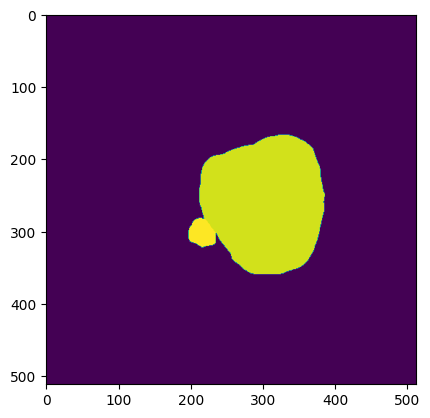

Slice number:  56


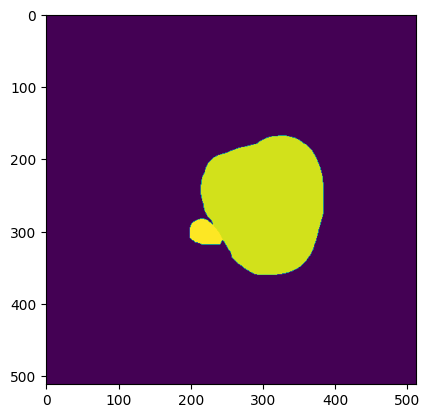

Slice number:  57


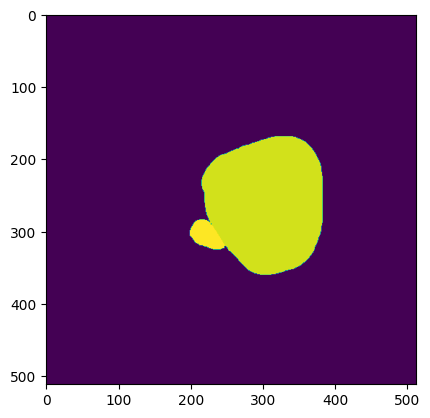

Slice number:  58


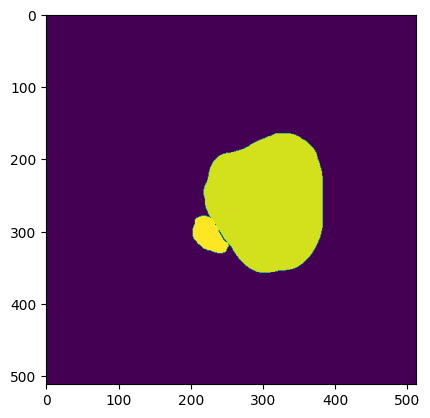

Slice number:  59


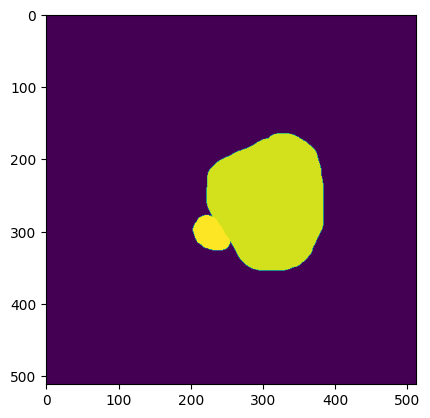

Slice number:  60


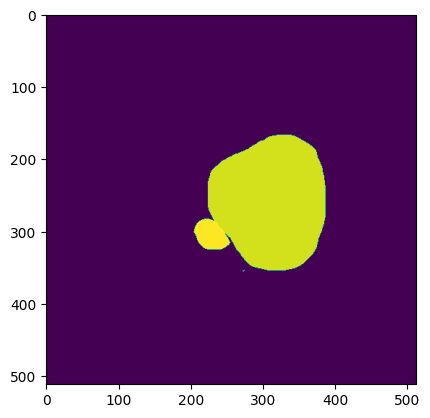

Slice number:  61


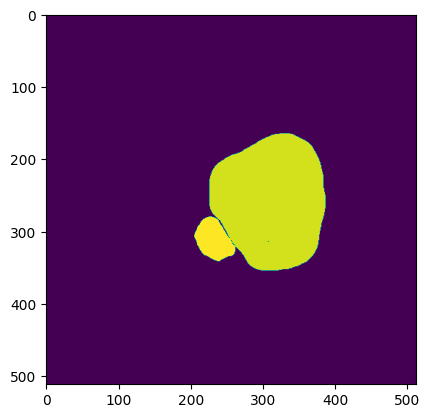

Slice number:  62


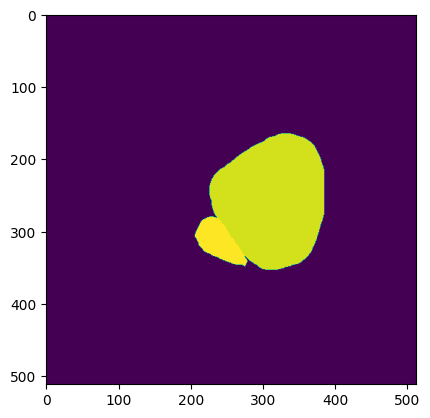

Slice number:  63


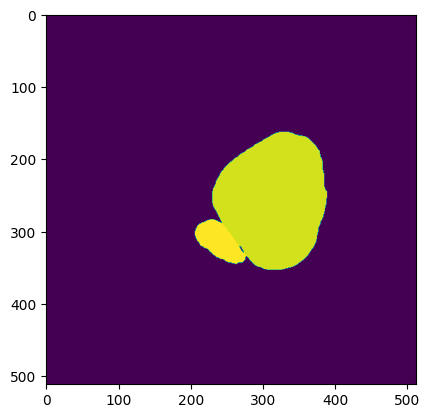

Slice number:  64


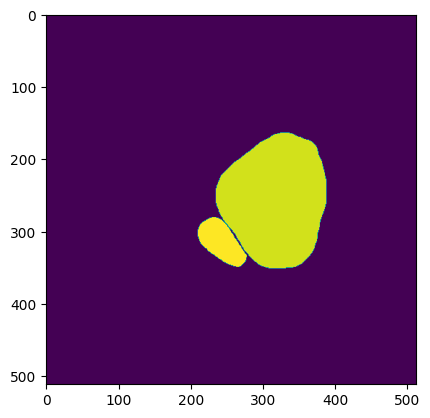

Slice number:  65


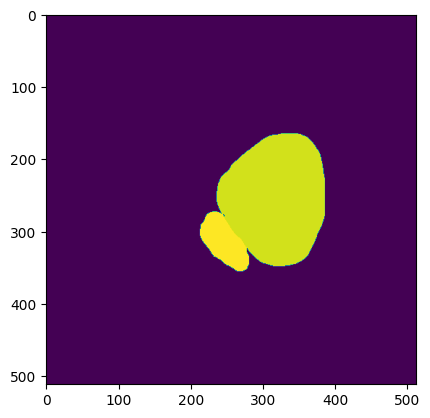

Slice number:  66


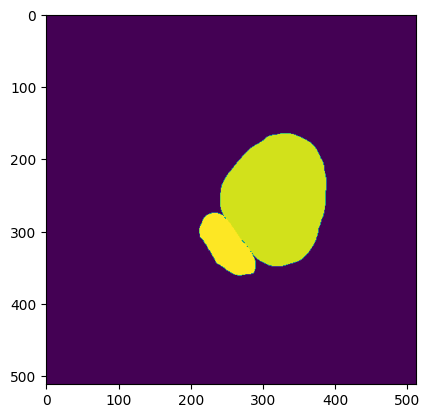

Slice number:  67


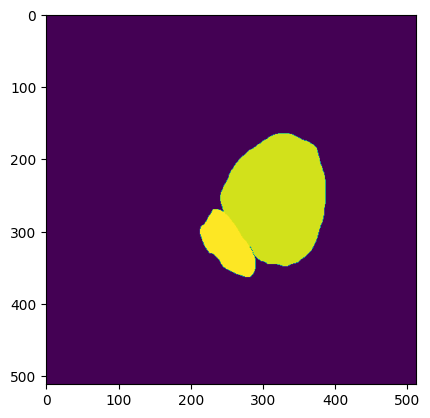

Slice number:  68


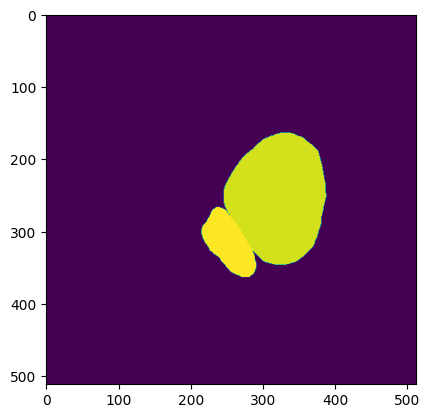

Slice number:  69


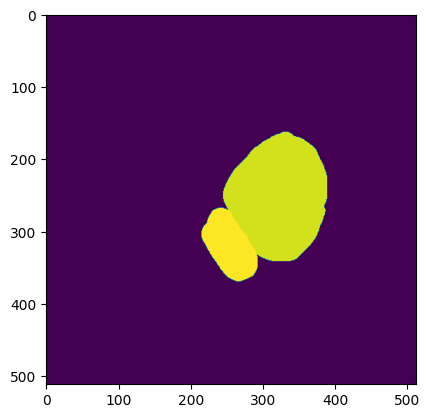

Slice number:  70


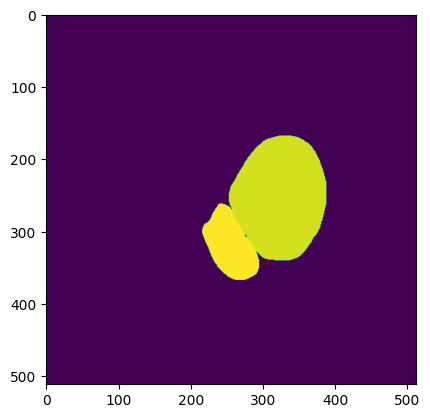

Slice number:  71


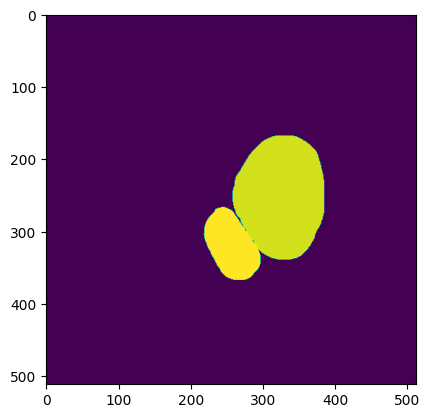

Slice number:  72


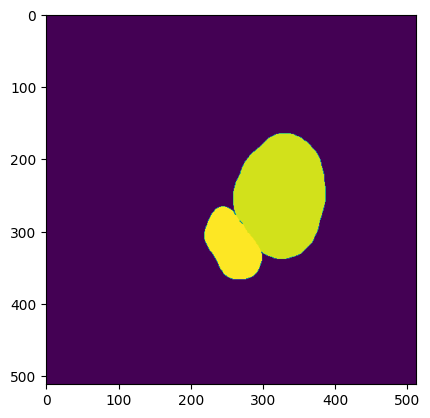

Slice number:  73


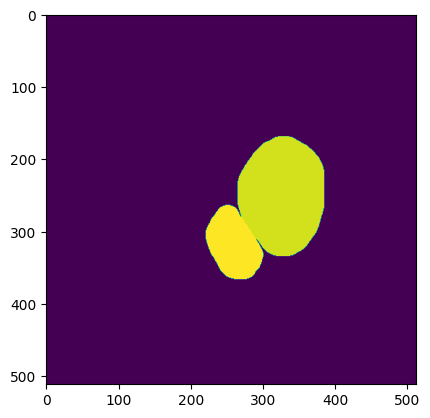

Slice number:  74


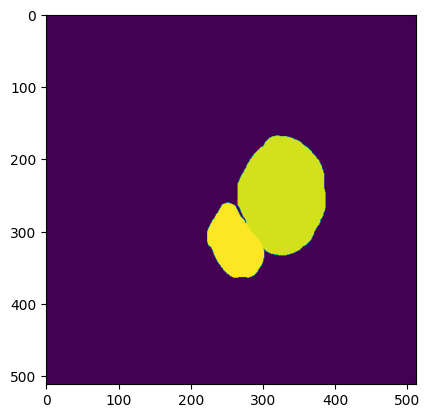

Slice number:  75


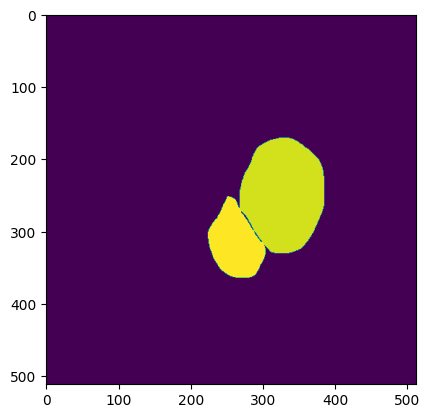

Slice number:  76


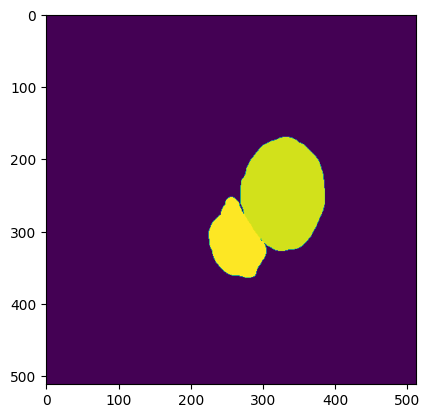

Slice number:  77


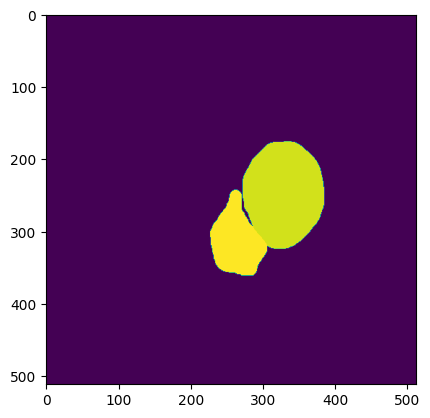

Slice number:  78


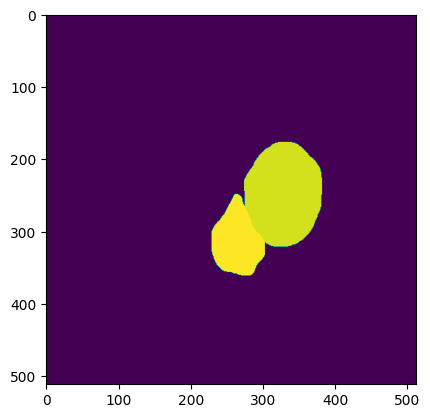

Slice number:  79


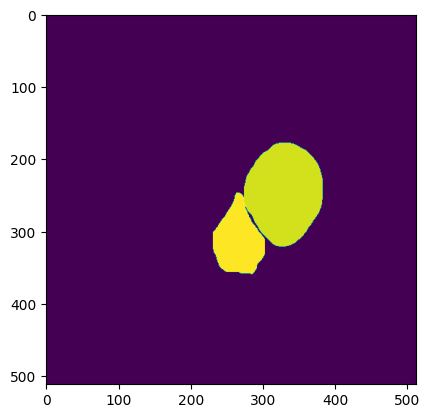

Slice number:  80


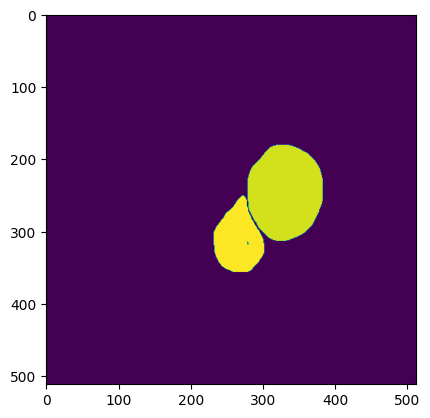

Slice number:  81


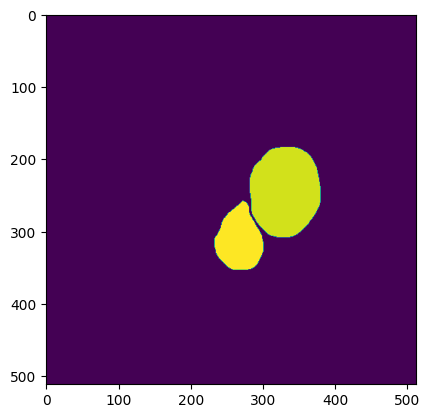

Slice number:  82


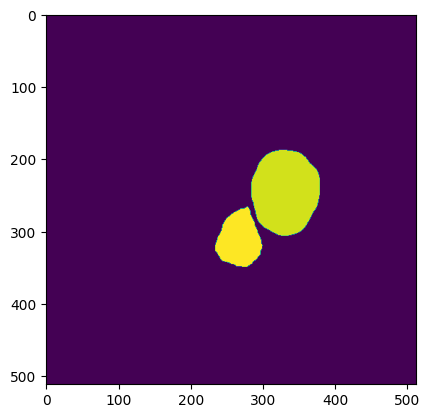

Slice number:  83


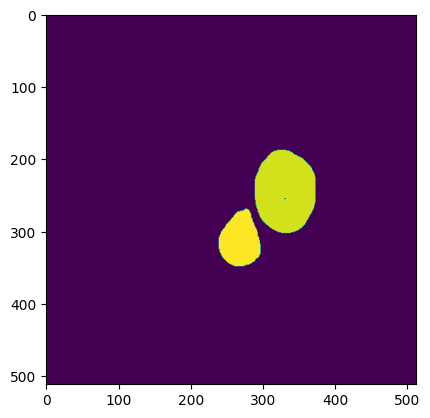

Slice number:  84


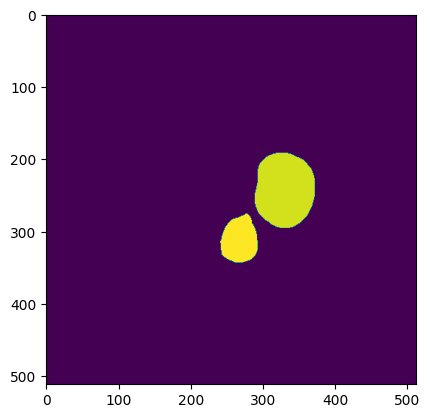

Slice number:  85


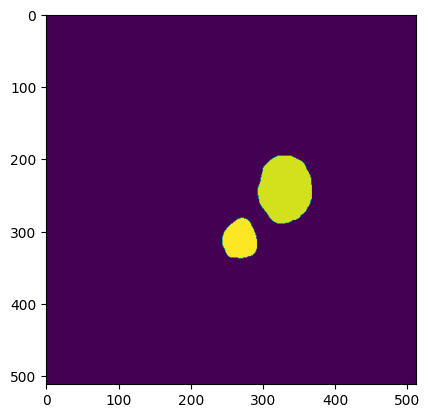

Slice number:  86


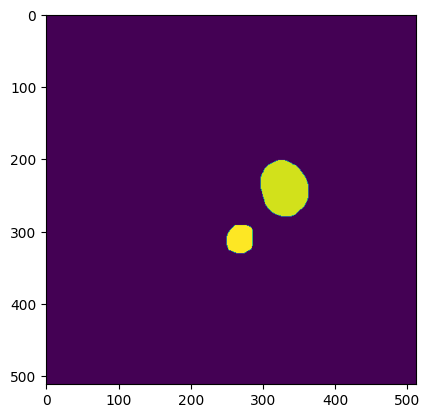

Slice number:  87


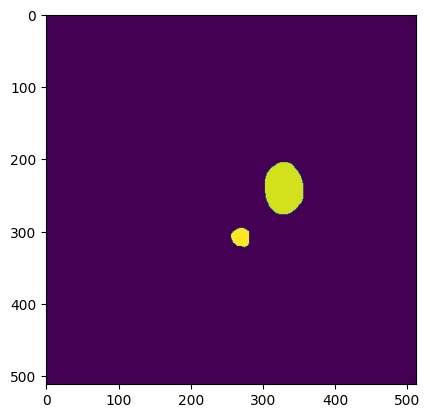

Slice number:  88


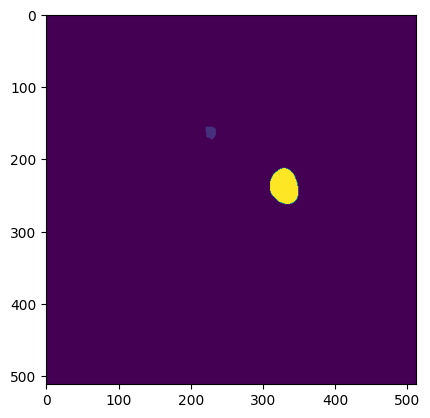

Slice number:  89


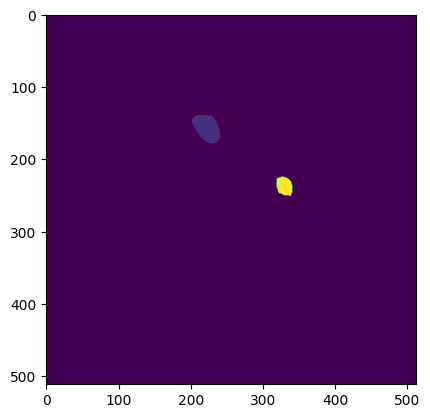

Slice number:  90


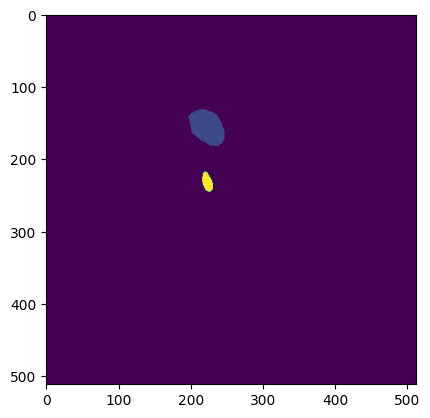

Slice number:  91


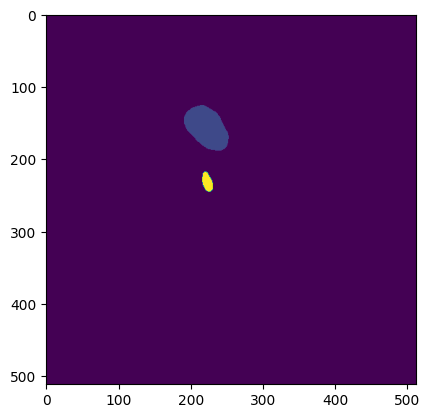

Slice number:  92


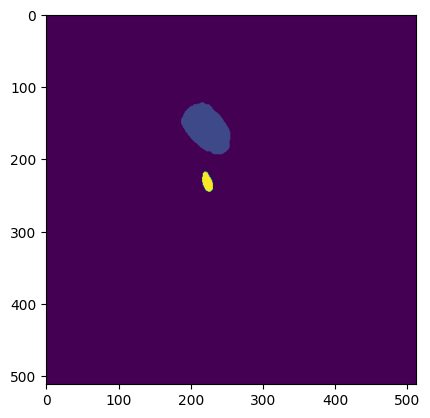

Slice number:  93


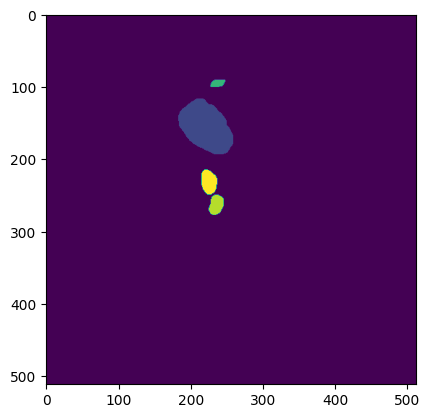

Slice number:  94


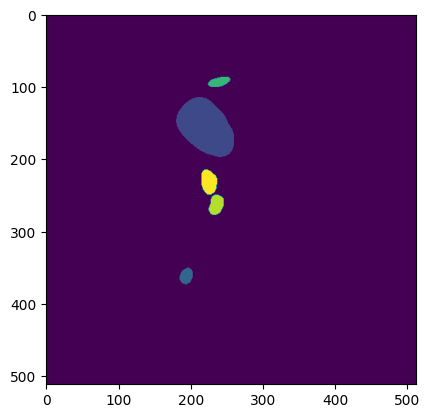

Slice number:  95


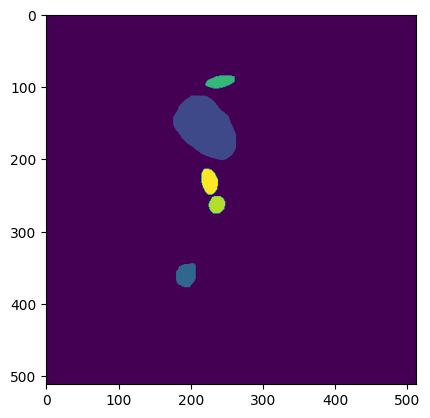

Slice number:  96


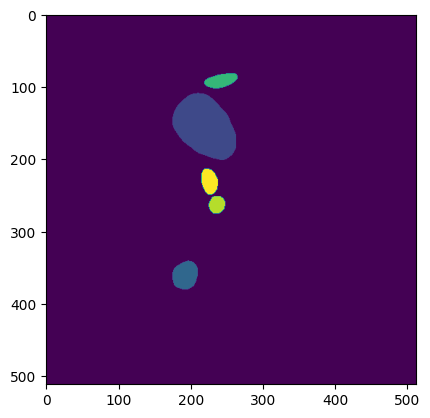

Slice number:  97


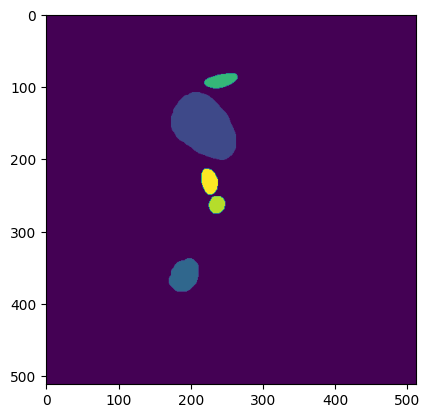

Slice number:  98


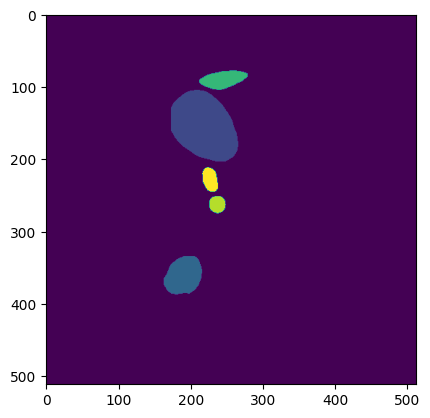

Slice number:  99


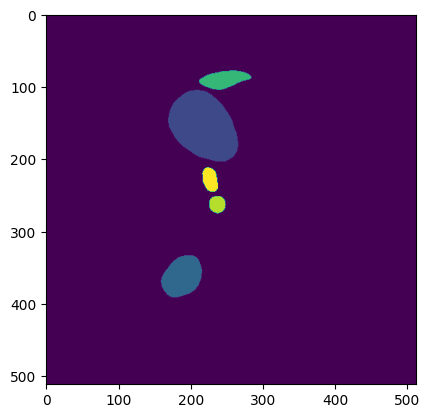

Slice number:  100


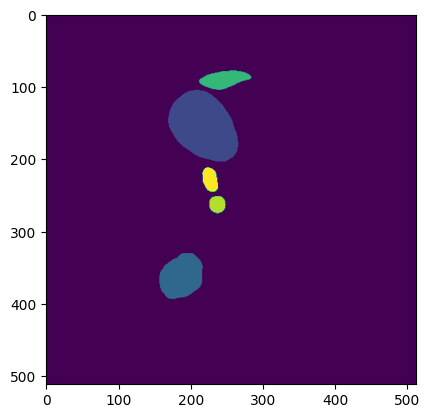

Slice number:  101


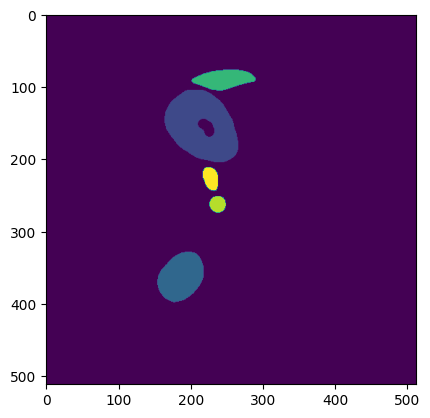

Slice number:  102


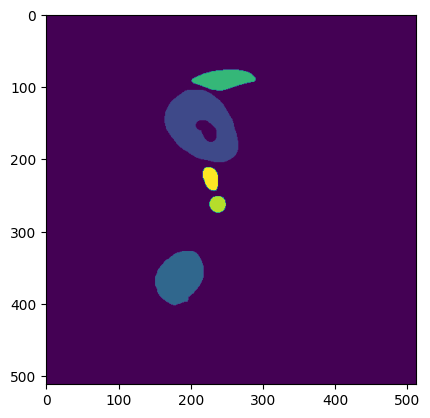

Slice number:  103


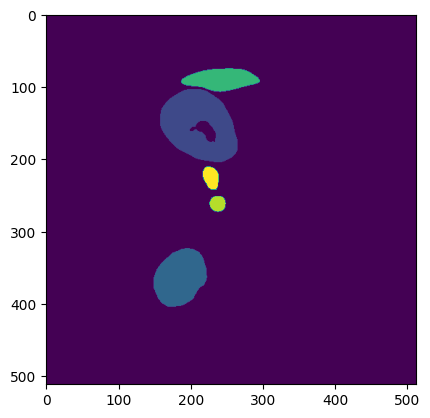

Slice number:  104


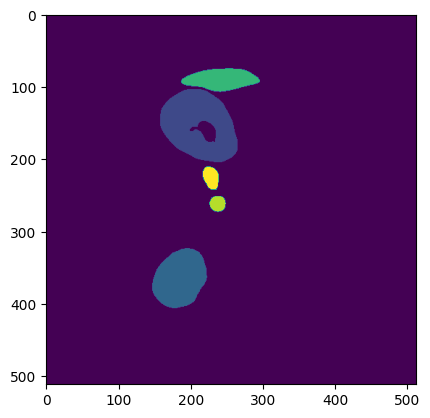

Slice number:  105


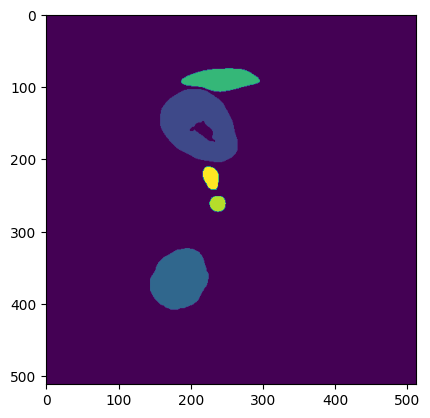

Slice number:  106


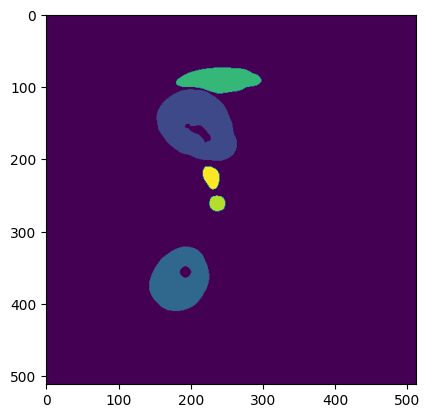

Slice number:  107


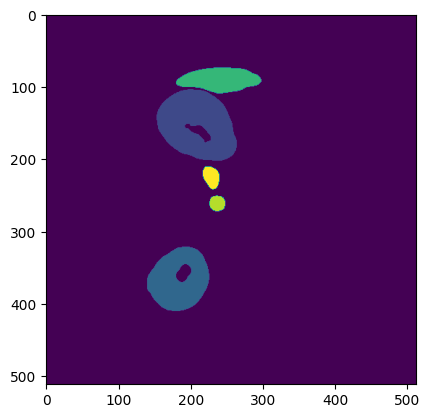

Slice number:  108


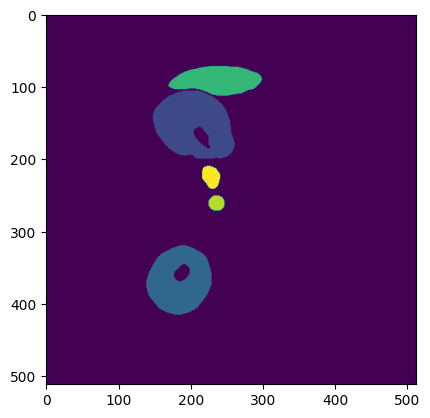

Slice number:  109


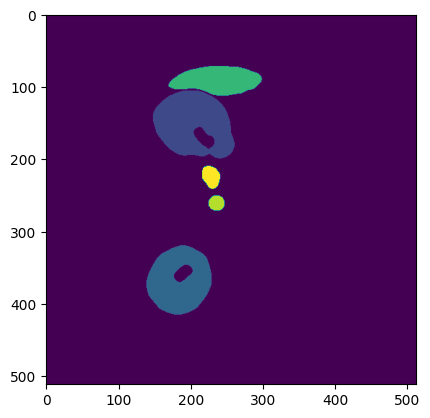

Slice number:  110


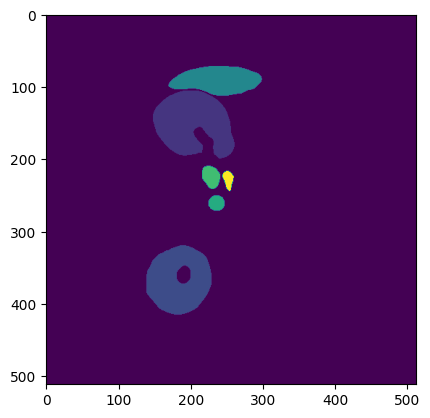

Slice number:  111


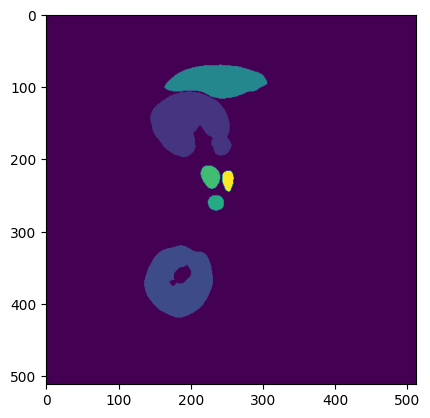

Slice number:  112


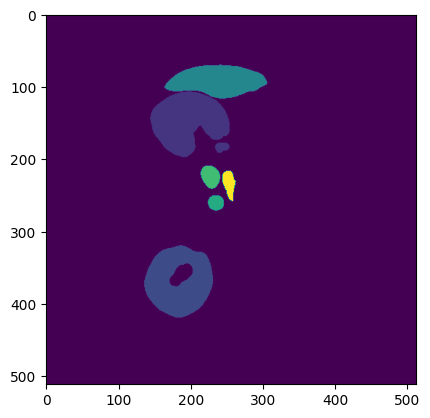

Slice number:  113


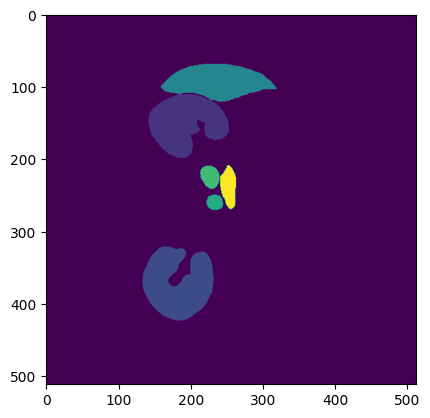

Slice number:  114


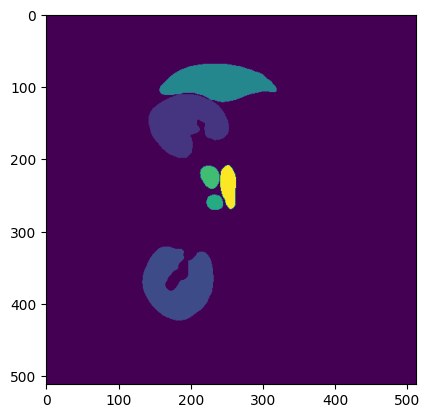

Slice number:  115


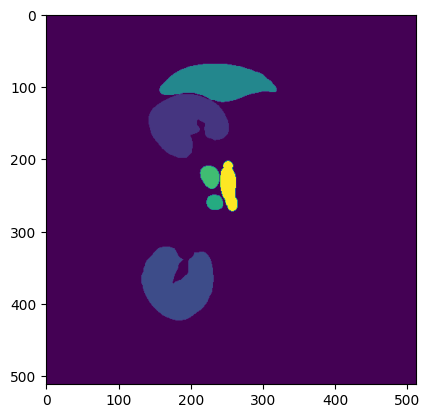

Slice number:  116


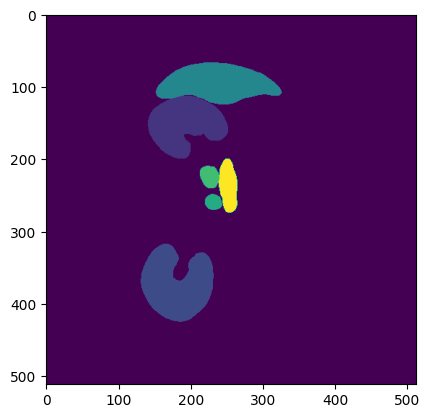

Slice number:  117


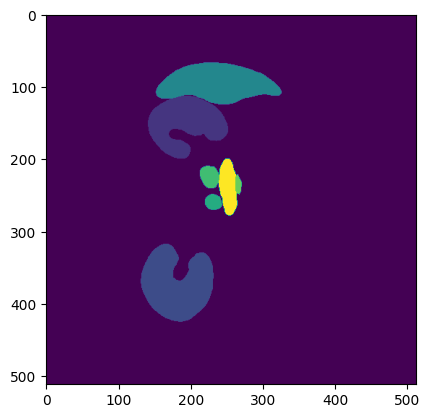

Slice number:  118


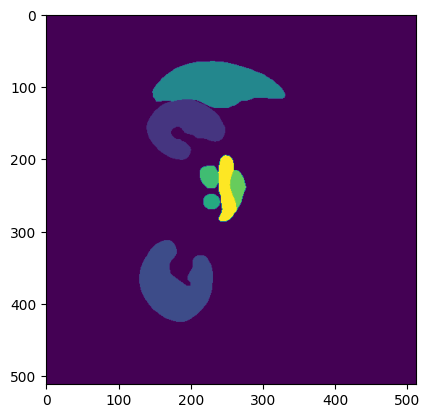

Slice number:  119


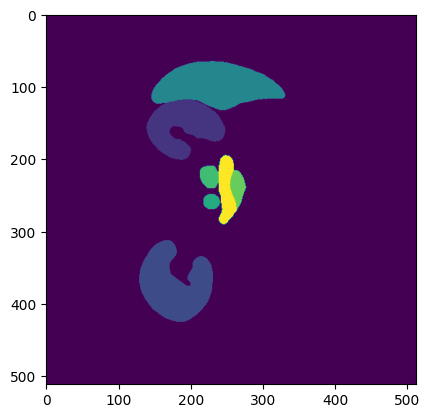

Slice number:  120


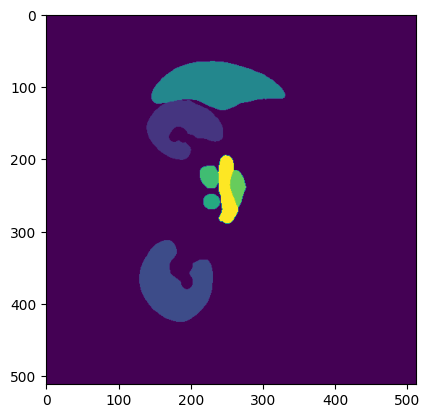

Slice number:  121


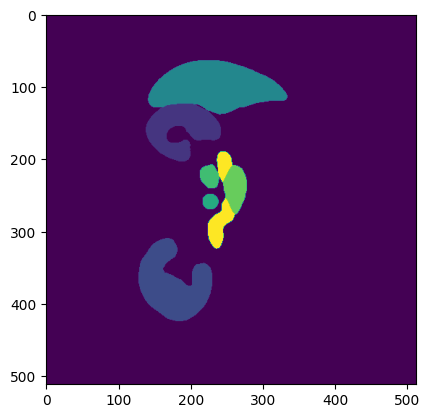

Slice number:  122


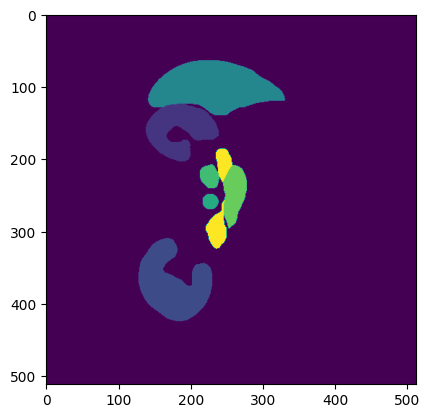

Slice number:  123


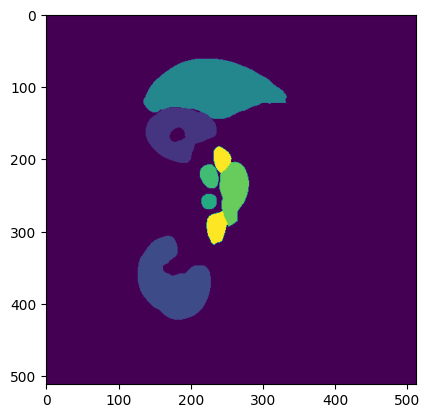

Slice number:  124


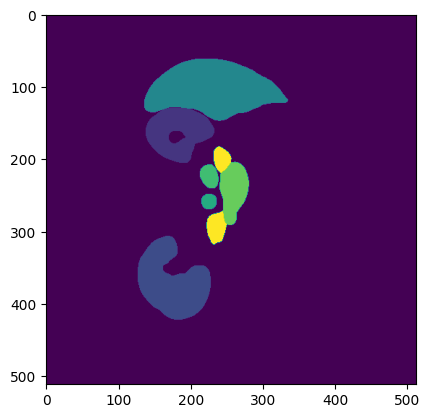

Slice number:  125


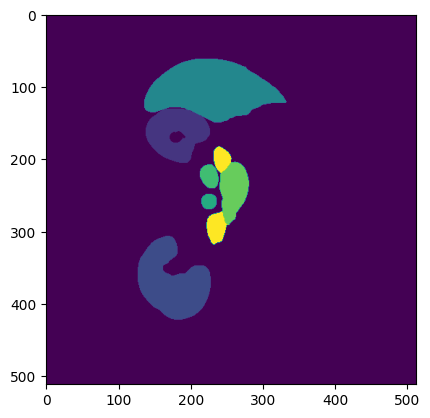

Slice number:  126


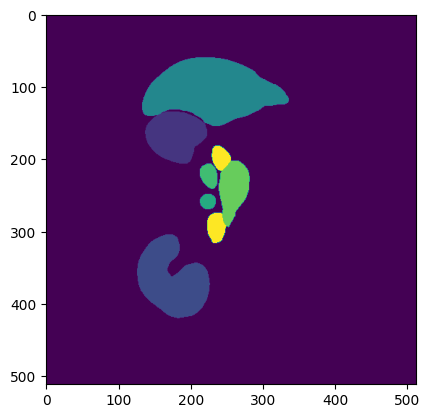

Slice number:  127


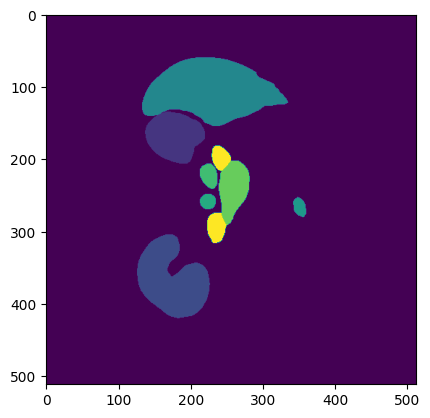

Slice number:  128


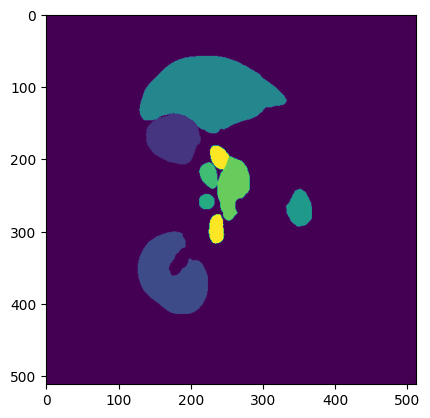

Slice number:  129


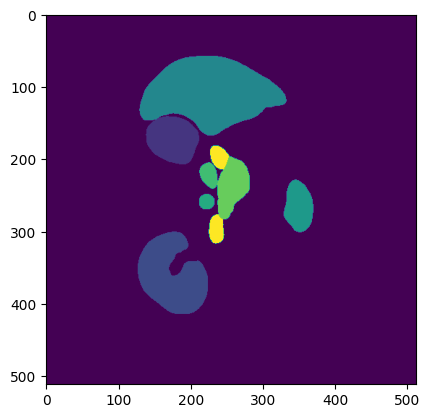

Slice number:  130


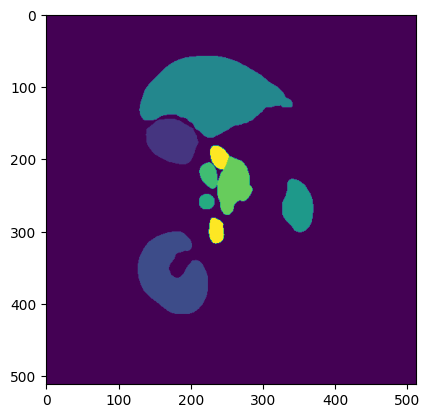

Slice number:  131


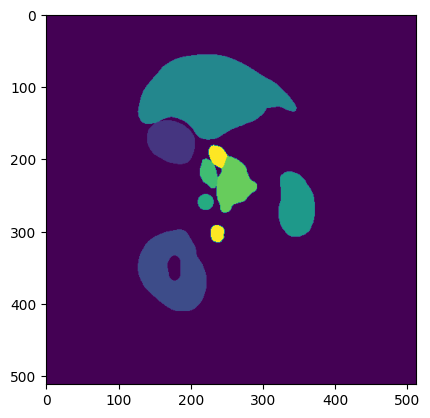

Slice number:  132


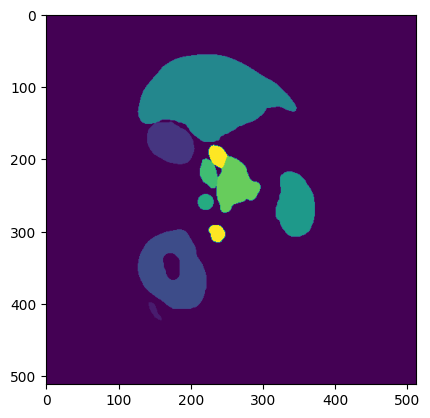

Slice number:  133


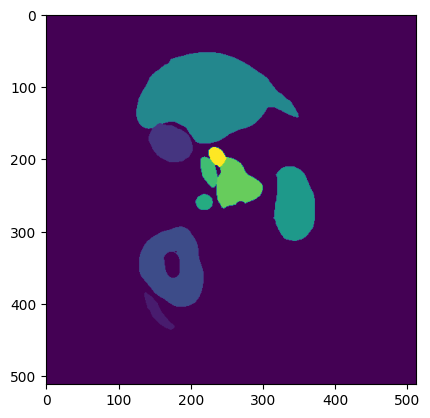

Slice number:  134


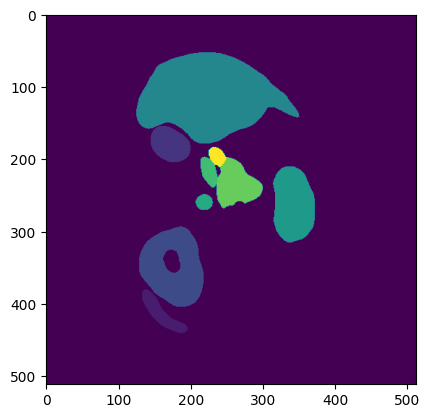

Slice number:  135


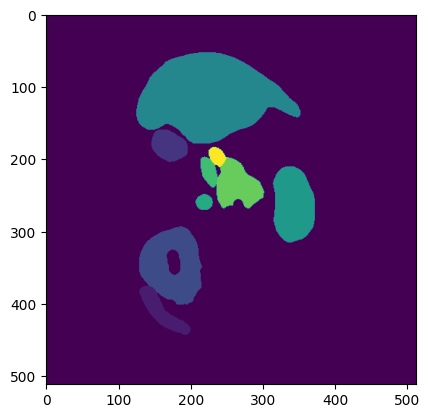

Slice number:  136


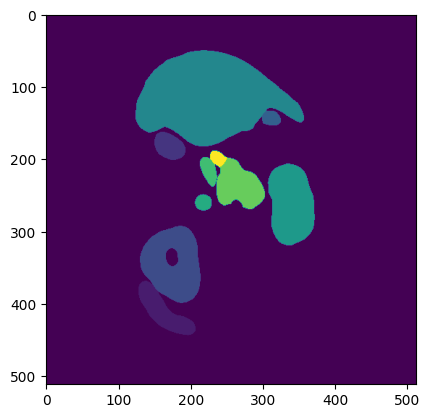

Slice number:  137


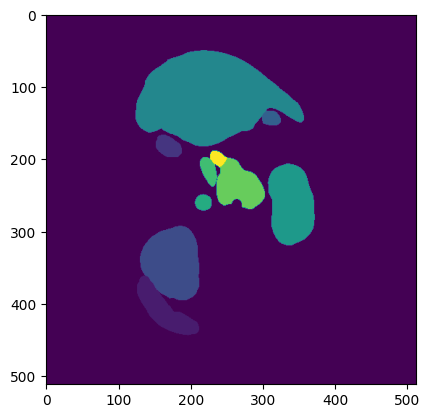

Slice number:  138


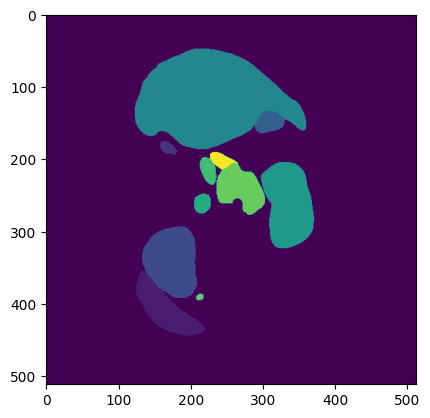

Slice number:  139


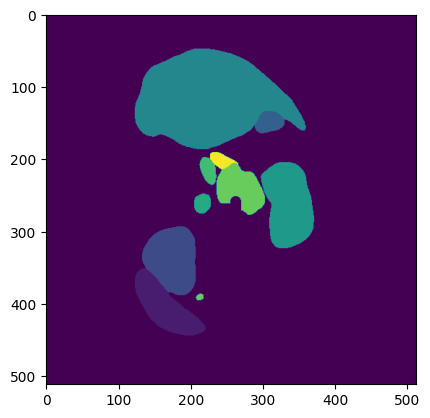

Slice number:  140


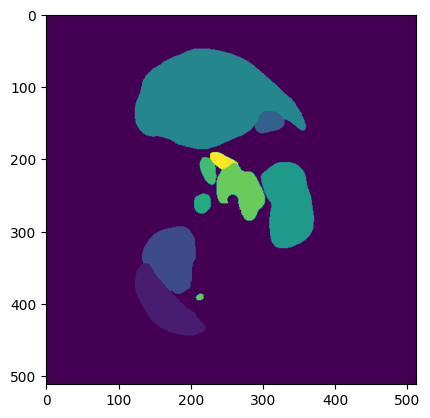

Slice number:  141


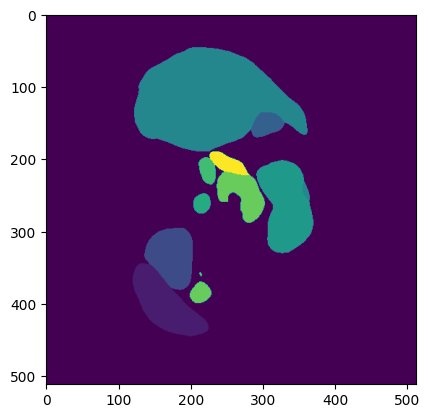

Slice number:  142


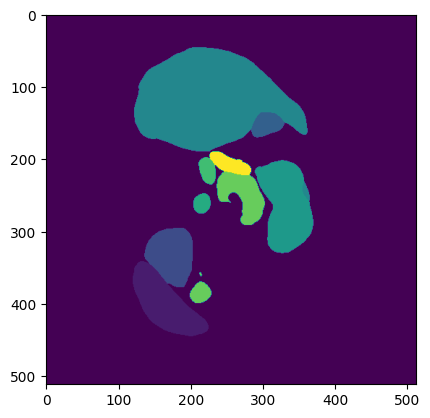

Slice number:  143


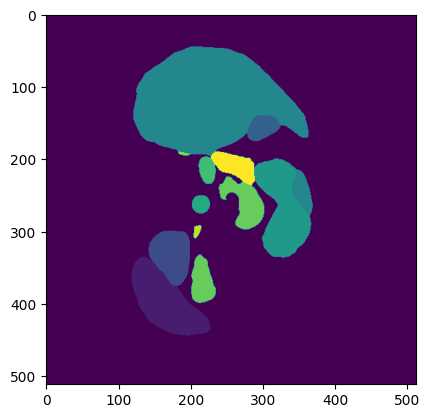

Slice number:  144


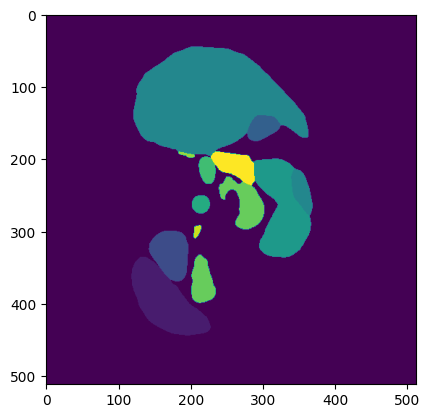

Slice number:  145


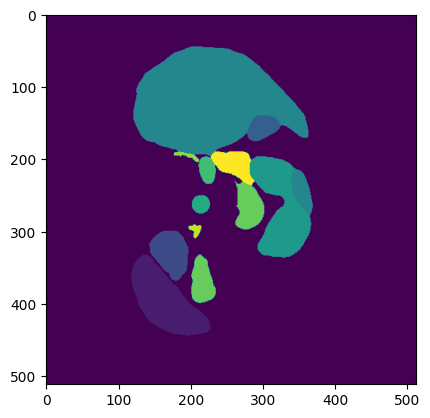

Slice number:  146


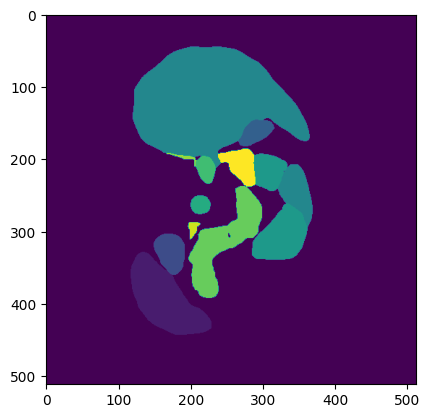

Slice number:  147


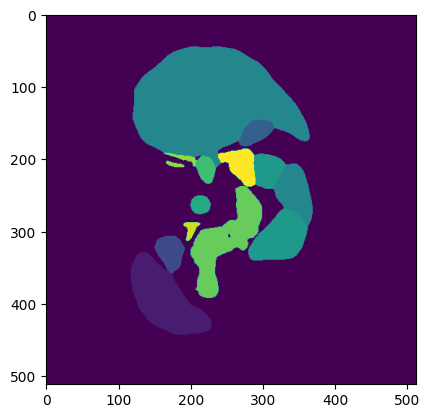

Slice number:  148


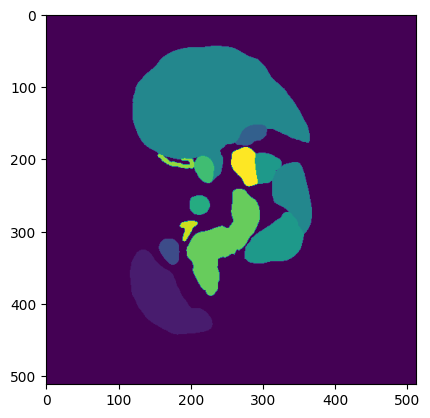

Slice number:  149


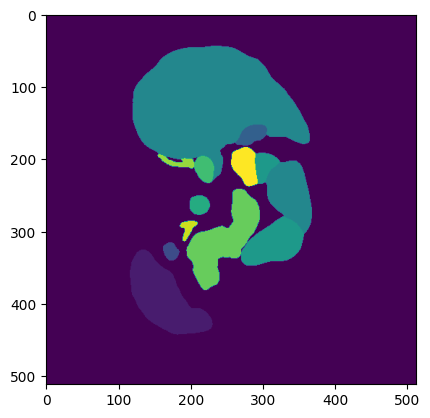

Slice number:  150


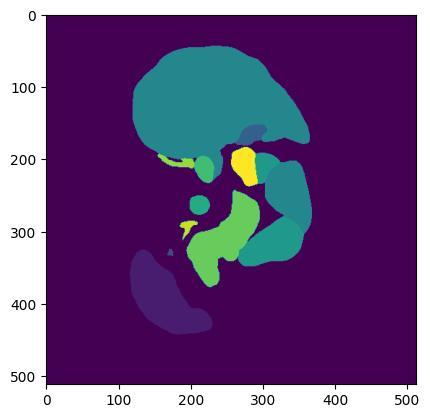

Slice number:  151


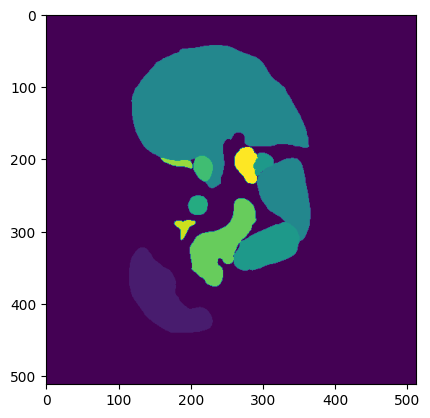

Slice number:  152


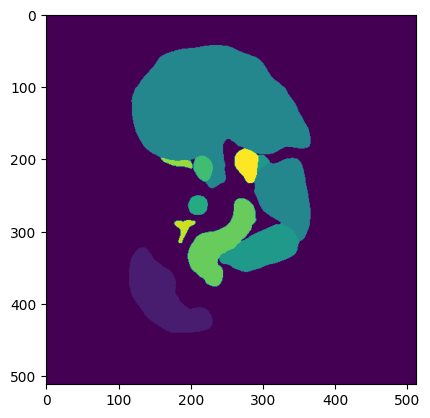

Slice number:  153


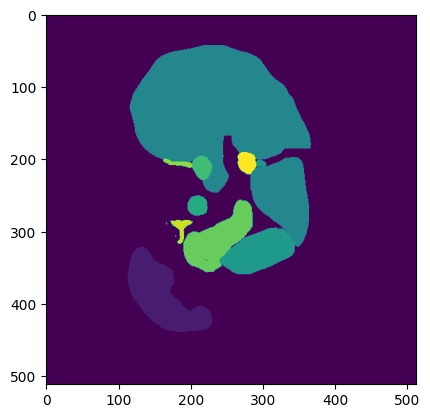

Slice number:  154


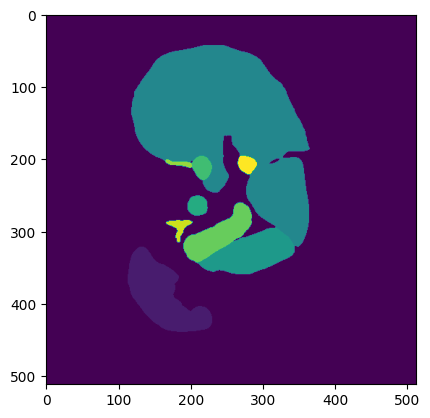

Slice number:  155


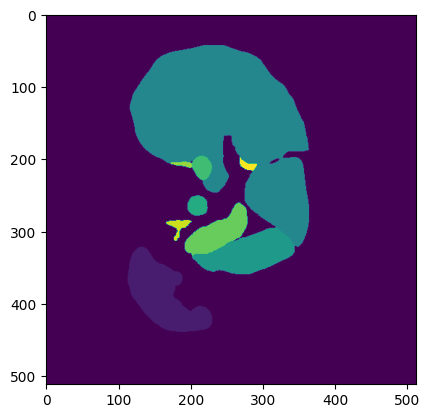

Slice number:  156


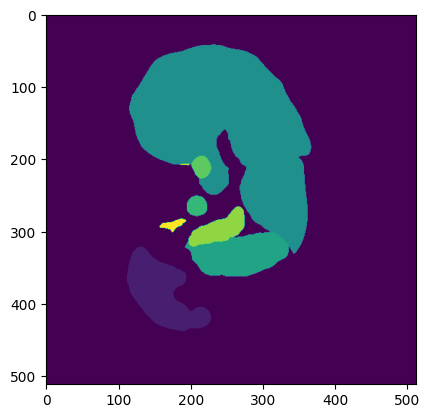

Slice number:  157


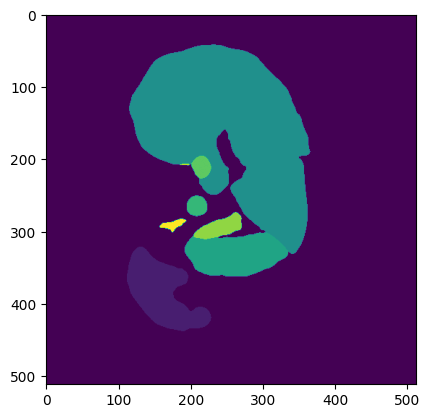

Slice number:  158


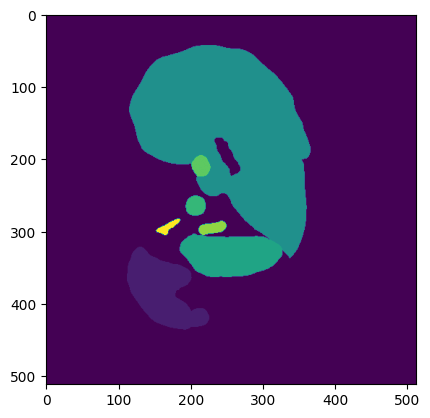

Slice number:  159


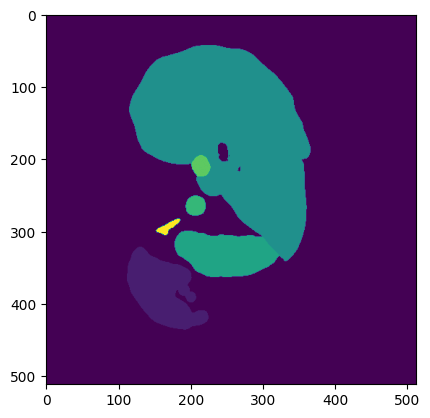

Slice number:  160


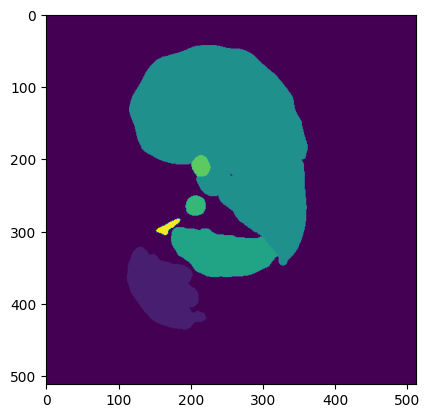

Slice number:  161


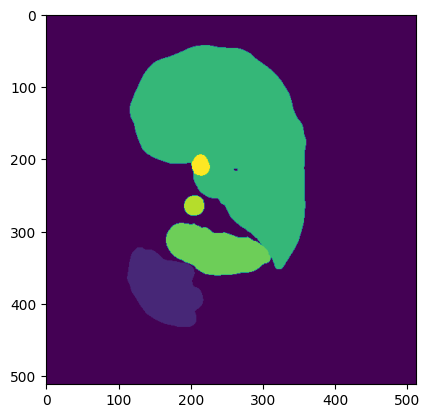

Slice number:  162


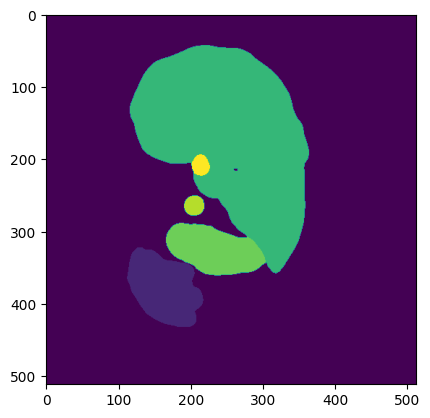

Slice number:  163


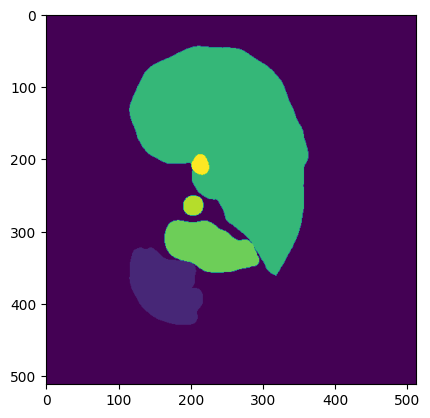

Slice number:  164


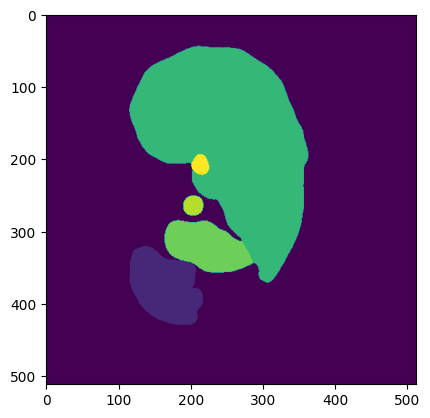

Slice number:  165


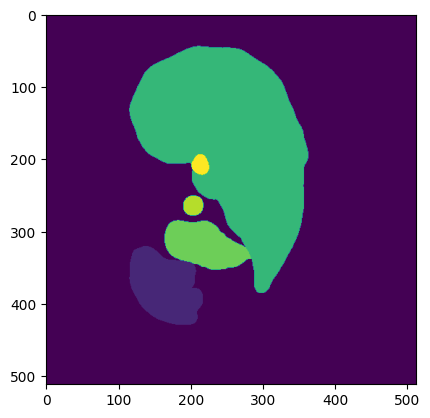

Slice number:  166


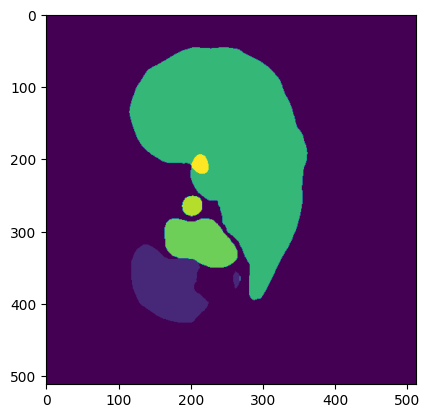

Slice number:  167


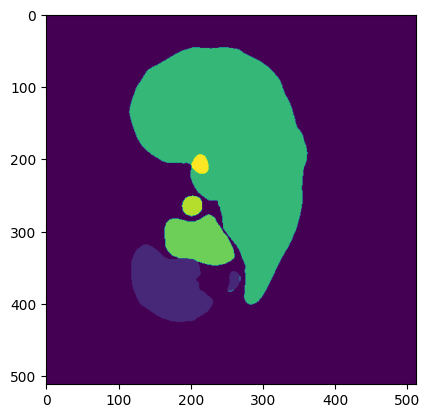

Slice number:  168


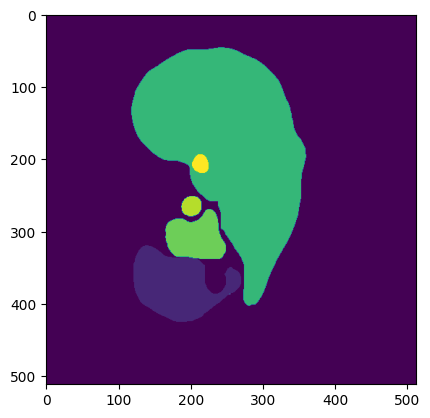

Slice number:  169


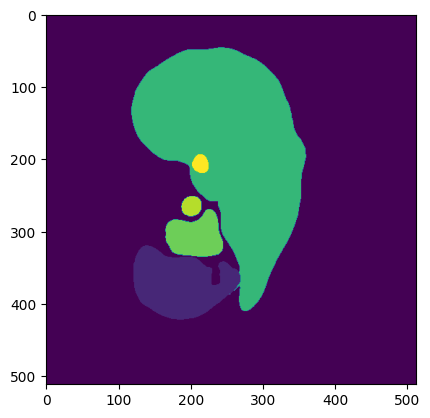

Slice number:  170


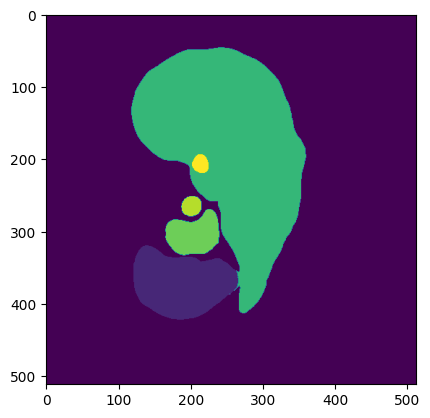

Slice number:  171


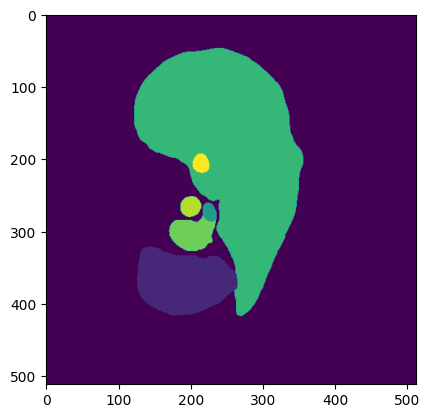

Slice number:  172


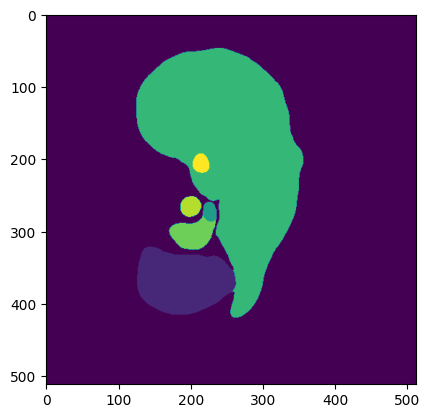

Slice number:  173


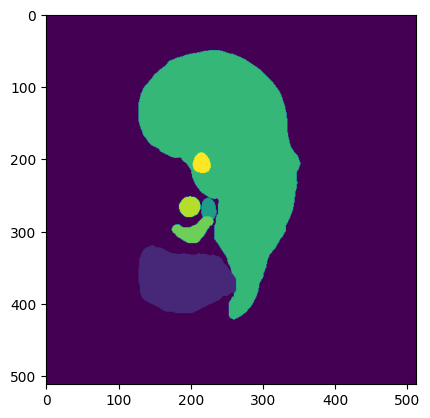

Slice number:  174


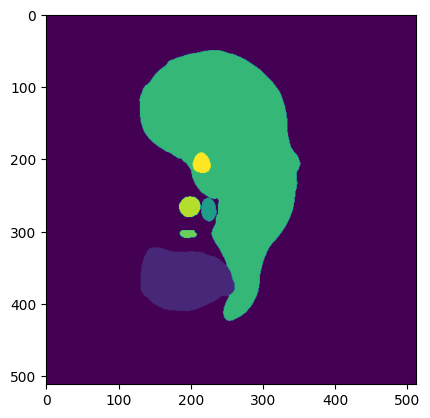

Slice number:  175


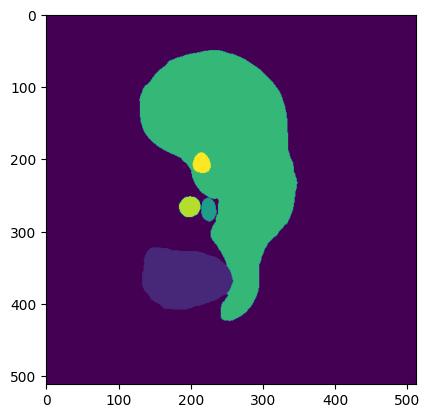

Slice number:  176


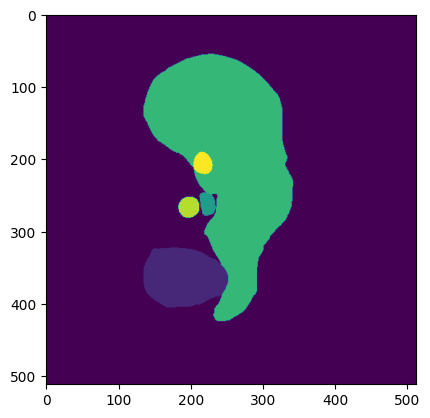

Slice number:  177


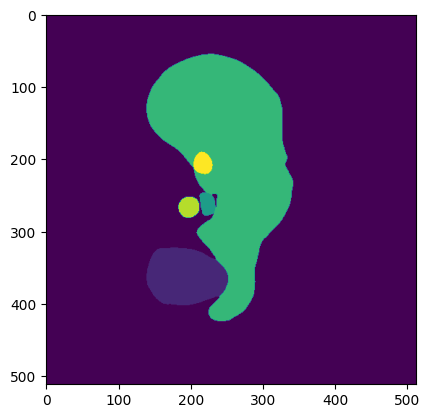

Slice number:  178


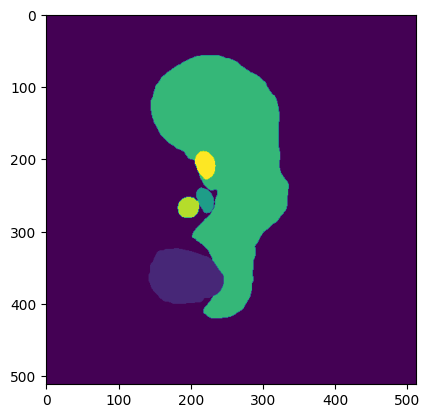

Slice number:  179


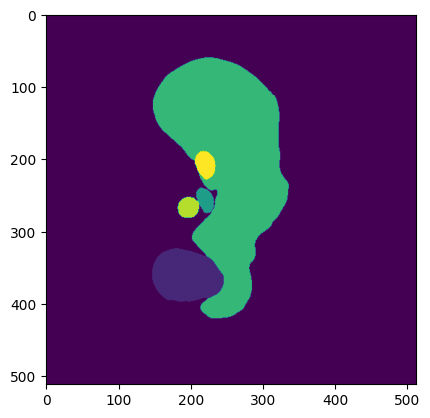

Slice number:  180


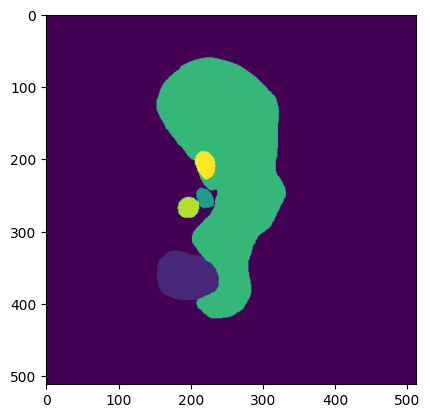

Slice number:  181


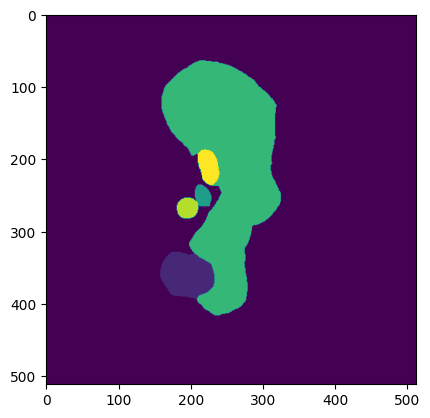

Slice number:  182


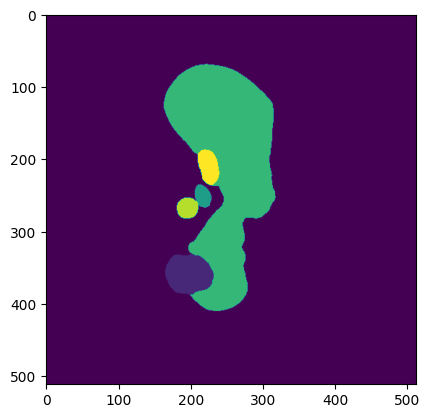

Slice number:  183


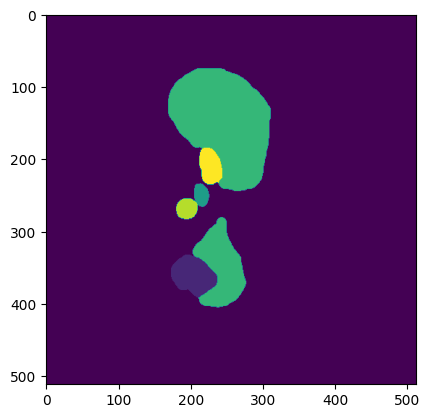

Slice number:  184


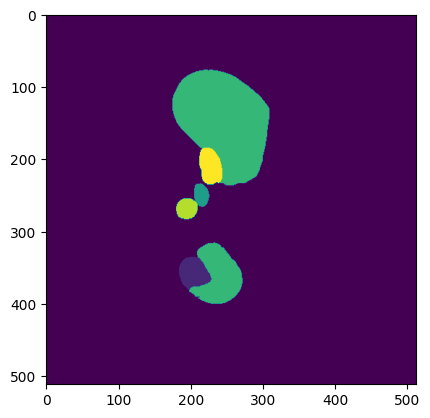

Slice number:  185


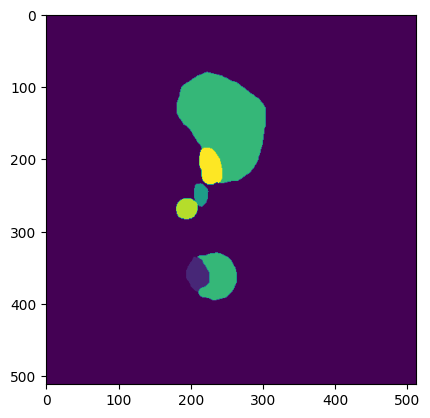

Slice number:  186


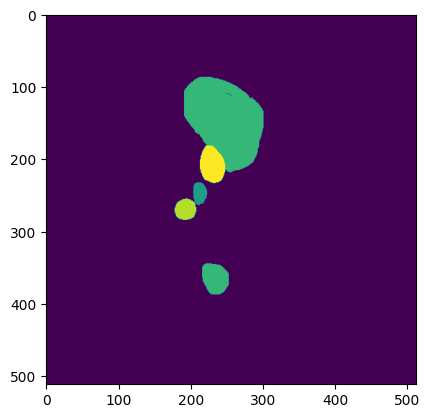

Slice number:  187


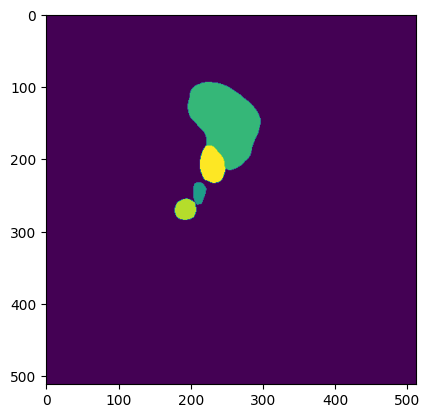

Slice number:  188


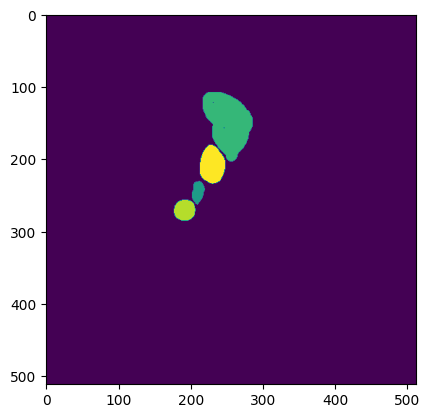

Slice number:  189


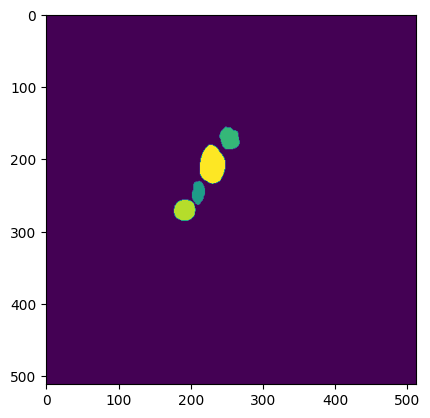

Slice number:  190


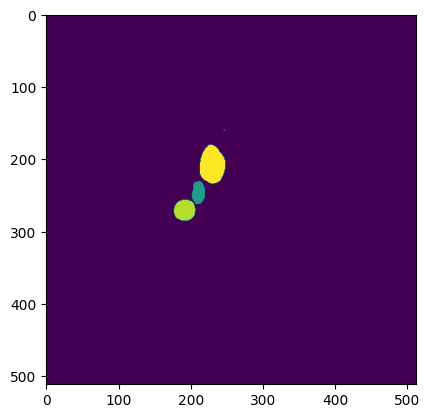

In [21]:
img268, ndt268 = getScan('labelsTr/amos_0268.nii.gz')
printSlice(ndt268)

#### WE WILL OP TO RESIZE ALL Processed IMAGES 
to shape `(512, 512, z)`, z will be some suitable thickness we decide later. We will need to see the average thickness of the organ we want to extract, in this case gallbladder (4)

### Also we will continue to rest of the project on LABELED DATA ONLY

### ~~1.14 Check if there are images with no label 4~~
~~they will be null after trimming, we will need to check before slicing these images~~ \
there will be files with very small gallbladder, we will have to get rid of them to ensure data integrity

In [26]:
# img0015, ndt0015 = getScan('labelsTr/amos_0015.nii.gz')
# img268, ndt268 = getScan('labelsTr/amos_0268.nii.gz')

# print(np.unique(ndt0015))

In [27]:
# print(ndt0001l.shape)
# print(ndt0009l.shape)
# print(ndt268.shape)

### there are different dimensions in different scans!
We will need functions to *perform ***sanity check*** before slicing (do not include image with no label 4 after slicing) as well as **resize*** them after slicing \
for now we will opt to resize all images to the shape of (512, 512, 10)

## 1.2 Compare label number & identify gallbladder

For this study, the focus is on the **gallbladder** (for now). From the documentation of the amos dataset (available [here](https://proceedings.neurips.cc/paper_files/paper/2022/file/ee604e1bedbd069d9fc9328b7b9584be-Paper-Datasets_and_Benchmarks.pdf)), the gallbladder should be labeled as **4**.

Lets try to plot a few slices with different group of organs, and check the labeling by printing them as numpy

labels in slice34:  [0.]
labels in slice50:  [0. 3. 8. 9.]
labels in slice69:  [ 0.  1.  2.  3.  4.  6.  7.  8.  9. 10. 12. 13.]
labels in slice80:  [0. 1. 5. 6. 7. 8. 9.]


<Figure size 640x480 with 0 Axes>

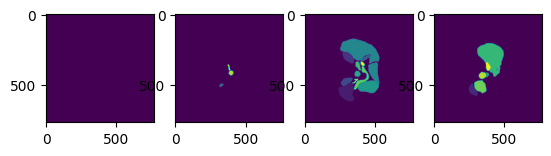

In [30]:
slice34 = ndt0001l[:,:,34]
slice50 = ndt0001l[:,:,50]
slice69 = ndt0001l[:,:,69]
slice80 = ndt0001l[:,:,80]
# print (slice68.shape)

#check for unique values
print ("labels in slice34: ", np.unique(slice34))
print ("labels in slice50: ", np.unique(slice50))
print ("labels in slice69: ", np.unique(slice69))
print ("labels in slice80: ", np.unique(slice80))
plt.figure()

#subplot(r,c) provide the no. of rows and columns
f, ax = plt.subplots(1,4)
# ax.set_axis_off()

# use the created array to output your multiple images. In this case I have stacked 4 images vertically
ax[0].imshow(slice34)
ax[1].imshow(slice50)
ax[2].imshow(slice69)
ax[3].imshow(slice80)

slice69 is around the area of liver, gallbladder etc. we will proceed with the assumption that label 4 is the correct label we want.

# 2. Data Preprocessing

### We will try to turn the gallbladder into 3D mesh objects

now that we know the gallbladder is labeled as 4 in the images, we can attempt to create an isolated 3D image of the prostate by:
1. extract slices from labeled scan that has a unique value of 4
2. remove other organs (value)
3. and stack them as a new nifti image
4. then we can turn the new nifti image into vtk mesh using the vtkMarchingCubes() from vtk library

~~p.s. might wanna use torch for faster processing~~

## 2.1 Gallbladder Extraction

### 2.1.1 Function to extract only selected organ & resize
**input**: niidata file and the value(organ) to keep \
**return**: the new array, new array thickness

[23/8/2023] update: 
added **filter to keep the trimmed nifti list under fixed size** ~~(15 for now, might wanna try 12)~~. This is to eliminate quite a lot of the image data where the segmentation is incorrect & labeled other organs together, making the trimmed nifti a lot larger (taller in height) than they should be.

### Function to resize
**input**: resize shape, niidata \
**return**: resized image

In [31]:
from vtk import vtkNIFTIImageReader, vtkMarchingCubes, vtkPolyData, vtkSmoothPolyDataFilter
from vtkmodules.vtkIOPLY import vtkPLYWriter
from skimage.transform import resize

In [32]:
def trimNifti(niidata, value2keep):#input niidata object & organ to keep (4 for gb)
    if(len(niidata.shape)==3):
        #list to keep track of the number of slices (final thiccness)
        sl_w_org = [] 
        for slice_Number in range(niidata.shape[2]):
            curr_slice = niidata[:,:,slice_Number ]
            if np.isin(value2keep, curr_slice) and len(sl_w_org)<20: #if 4 is in the slice and stack not too big
                sl_w_org.append(slice_Number) #take the slice
            
        #create a new array with original width & length, but new height (shortened)
        new_arr = np.empty((niidata.shape[0], niidata.shape[1], len(sl_w_org)))
        for slice_Number in range(len(sl_w_org)):
            curr_slice = niidata[:,:,sl_w_org[slice_Number]]
            new_arr[:,:,slice_Number] = curr_slice
    
        #create a boolean mask that only keeps 4 from the array
        mask = (new_arr == value2keep)
        #create a new array with the same size as teh 
        filtered_arr = np.zeros_like(new_arr)
        #assign the value to keep 4 to the corresponding positions in the final array
        filtered_arr[mask] = value2keep
        #to convert all 4 to 1.
        filtered_arr = np.where(filtered_arr==value2keep, 1., filtered_arr)
    return filtered_arr, len(sl_w_org)

# line to test this specific function
# new_arr, _ = trimNifti(ndt0001l, 15.)
# print(np.unique(new_arr))

def niftiResize(output_size, niidata):
    output_size = output_size
    resized_img = resize(niidata, output_size, preserve_range=True)
    
    return resized_img


### 2.12 Function to save new nifti
**input**: the new array, img of the original nifti, and path to output \
**return**: nothing

In [33]:
#function that saves the trimmed organ as nifti
def saveAsNifti(new_arr, img, output_path):
    #check if there the array is null
    if new_arr.shape[2] == 0 or new_arr.shape[0] == 0 or new_arr.shape[1] == 0:
        return None
    if new_arr.shape[2]>0:
        # Create a new image with the shorter dimensions
        new_img = nib.Nifti1Image(new_arr, img.affine, header=img.header)
        # Save the new image to a NIfTI file, need to dynamically name it tho
        nib.save(new_img, output_path)      

# out_path = "C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT\\prostate_tr\\new.nii.gz"

# line to test this specific function
# saveAsNifti(new_arr, img0001l, out_path)

### 2.13 Function to trim, resize & save
**input**: input path, output path, and organ value (to keep) \
**return**: new, clean nifti (to output path)

In [34]:
#another function
#this one takes input of path name to perform actions on, we want to loop this
def preprocess_slicing(input_path, output_path, value2keep, shape, b1, b2):
    #getScan to get niidata & img, using input_path
    img, ndt = getScan(input_path) #'labelsTr/amos_0001.nii.gz'
        
    #trimNifti
    new_arr, length = trimNifti(ndt, value2keep)
    
    #exclude outliers, and resize the rest before saving
    if length>b1 and length<=b2:
        new_arr = niftiResize(shape, new_arr)
    
        #saveAsNifti, using output_path
        saveAsNifti(new_arr, img, output_path)
    
# # line to test this specific function
# preprocess_slicing('labelsTr/amos_0001.nii.gz', 'prostate_tr/amos_0001.nii.gz', 15.)


### 2.14 Preprocessing training (& validation) data
we will reset the os path first, and set some needed variables (path & item namelist) \
in the end I have decided to keep new images that are of thickness between `(4, 18)`

In [35]:
#actually calling the function(s) over all label data

#set os path one more time to be sure
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")

#set folder name to input and output
in_folder = "labelsTr"
out_folder = "version1/gb_tr"
#get item list to call functions on
item_list = os.listdir(in_folder)

#set organ (value) to keep
v2k = 4.

#for all the item in input folder:
for i in range(len(item_list)):
    in_path = in_folder+"\\"+item_list[i]#set input path, start from folder
    out_path = os.getcwd()+"\\"+out_folder+"\\"+item_list[i]#set output path, full path
    print(item_list[i]+": ") #also to monitor the size of trimmed niftis
    
    preprocess_slicing(in_path, out_path, v2k, (520, 520, 10), 4, 18)#call slicing on each item


amos_0001.nii.gz: 
4
amos_0004.nii.gz: 
8
amos_0005.nii.gz: 
9
amos_0006.nii.gz: 
11
amos_0007.nii.gz: 
5
amos_0009.nii.gz: 
8
amos_0010.nii.gz: 
9
amos_0011.nii.gz: 
6
amos_0014.nii.gz: 
6
amos_0015.nii.gz: 
4
amos_0016.nii.gz: 
8
amos_0017.nii.gz: 
8
amos_0019.nii.gz: 
12
amos_0021.nii.gz: 
0
amos_0023.nii.gz: 
12
amos_0024.nii.gz: 
6
amos_0025.nii.gz: 
8
amos_0027.nii.gz: 
9
amos_0030.nii.gz: 
16
amos_0033.nii.gz: 
9
amos_0035.nii.gz: 
12
amos_0036.nii.gz: 
8
amos_0038.nii.gz: 
6
amos_0042.nii.gz: 
10
amos_0043.nii.gz: 
11
amos_0044.nii.gz: 
10
amos_0045.nii.gz: 
13
amos_0047.nii.gz: 
12
amos_0048.nii.gz: 
6
amos_0049.nii.gz: 
7
amos_0050.nii.gz: 
7
amos_0052.nii.gz: 
7
amos_0054.nii.gz: 
5
amos_0057.nii.gz: 
12
amos_0058.nii.gz: 
14
amos_0059.nii.gz: 
10
amos_0060.nii.gz: 
7
amos_0064.nii.gz: 
6
amos_0066.nii.gz: 
12
amos_0067.nii.gz: 
0
amos_0069.nii.gz: 
7
amos_0071.nii.gz: 
6
amos_0072.nii.gz: 
11
amos_0075.nii.gz: 
12
amos_0076.nii.gz: 
11
amos_0077.nii.gz: 
11
amos_0078.nii.gz

In [23]:
#actually calling the function(s) over all label data

#set os path one more time to be sure
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")

#set folder name to input and output
in_folder = "labelsVa"
out_folder = "version1/gb_va"
#get item list to call functions on
item_list = os.listdir(in_folder)

#set organ (value) to keep
v2k = 4.

#for all the item in input folder:
for i in range(len(item_list)):
    in_path = in_folder+"\\"+item_list[i]#set input path, start from folder
    out_path = os.getcwd()+"\\"+out_folder+"\\"+item_list[i]#set output path, full path
    print(item_list[i]+": ") #also to monitor the size of trimmed niftis
    preprocess_slicing(in_path, out_path, v2k, (520, 520, 10), 4, 18)#call slicing on each item


amos_0008.nii.gz: 
8
amos_0013.nii.gz: 
9
amos_0018.nii.gz: 
9
amos_0022.nii.gz: 
5
amos_0029.nii.gz: 
12
amos_0032.nii.gz: 
8
amos_0034.nii.gz: 
7
amos_0040.nii.gz: 
5
amos_0041.nii.gz: 
10
amos_0051.nii.gz: 
8
amos_0056.nii.gz: 
0
amos_0061.nii.gz: 
9
amos_0063.nii.gz: 
6
amos_0070.nii.gz: 
0
amos_0073.nii.gz: 
4
amos_0085.nii.gz: 
10
amos_0087.nii.gz: 
6
amos_0090.nii.gz: 
8
amos_0106.nii.gz: 
2
amos_0108.nii.gz: 
9
amos_0112.nii.gz: 
5
amos_0117.nii.gz: 
10
amos_0120.nii.gz: 
0
amos_0123.nii.gz: 
7
amos_0128.nii.gz: 
6
amos_0132.nii.gz: 
9
amos_0136.nii.gz: 
4
amos_0140.nii.gz: 
10
amos_0144.nii.gz: 
7
amos_0150.nii.gz: 
0
amos_0155.nii.gz: 
12
amos_0157.nii.gz: 
6
amos_0167.nii.gz: 
6
amos_0174.nii.gz: 
13
amos_0176.nii.gz: 
8
amos_0189.nii.gz: 
7
amos_0191.nii.gz: 
0
amos_0194.nii.gz: 
12
amos_0200.nii.gz: 
7
amos_0202.nii.gz: 
6
amos_0203.nii.gz: 
20
amos_0204.nii.gz: 
20
amos_0206.nii.gz: 
20
amos_0207.nii.gz: 
20
amos_0208.nii.gz: 
17
amos_0216.nii.gz: 
17
amos_0218.nii.gz: 
1

p.s. we ***might*** wanna run the preprocess on **validation data** (half the size of training) as well \
not test data cuz they have no labels

### 2.15 Checking if the output from above functions work
we will read the produced scan, and show the new nifti images \
first, we check the resize function...

In [36]:
path = 'version1/gb_tr'
item_list =  os.listdir(path)
    
for item in item_list:
    img_n1, ndt_new1 = getScan(path+"/"+item)
    print(item, ndt_new1.shape)

amos_0004.nii.gz (520, 520, 10)
amos_0005.nii.gz (520, 520, 10)
amos_0006.nii.gz (520, 520, 10)
amos_0007.nii.gz (520, 520, 10)
amos_0009.nii.gz (520, 520, 10)
amos_0010.nii.gz (520, 520, 10)
amos_0011.nii.gz (520, 520, 10)
amos_0014.nii.gz (520, 520, 10)
amos_0016.nii.gz (520, 520, 10)
amos_0017.nii.gz (520, 520, 10)
amos_0019.nii.gz (520, 520, 10)
amos_0023.nii.gz (520, 520, 10)
amos_0024.nii.gz (520, 520, 10)
amos_0025.nii.gz (520, 520, 10)
amos_0027.nii.gz (520, 520, 10)
amos_0030.nii.gz (520, 520, 10)
amos_0033.nii.gz (520, 520, 10)
amos_0035.nii.gz (520, 520, 10)
amos_0036.nii.gz (520, 520, 10)
amos_0038.nii.gz (520, 520, 10)
amos_0042.nii.gz (520, 520, 10)
amos_0043.nii.gz (520, 520, 10)
amos_0044.nii.gz (520, 520, 10)
amos_0045.nii.gz (520, 520, 10)
amos_0047.nii.gz (520, 520, 10)
amos_0048.nii.gz (520, 520, 10)
amos_0049.nii.gz (520, 520, 10)
amos_0050.nii.gz (520, 520, 10)
amos_0052.nii.gz (520, 520, 10)
amos_0054.nii.gz (520, 520, 10)
amos_0057.nii.gz (520, 520, 10)
amos_005

In [37]:
path = 'version1/gb_va'

item_list =  os.listdir(path)
    
for item in item_list:
    img_n1, ndt_new1 = getScan(path+"/"+item)
    print(item, ndt_new1.shape)

amos_0008.nii.gz (520, 520, 10)
amos_0013.nii.gz (520, 520, 10)
amos_0018.nii.gz (520, 520, 10)
amos_0022.nii.gz (520, 520, 10)
amos_0029.nii.gz (520, 520, 10)
amos_0032.nii.gz (520, 520, 10)
amos_0034.nii.gz (520, 520, 10)
amos_0040.nii.gz (520, 520, 10)
amos_0041.nii.gz (520, 520, 10)
amos_0051.nii.gz (520, 520, 10)
amos_0061.nii.gz (520, 520, 10)
amos_0063.nii.gz (520, 520, 10)
amos_0085.nii.gz (520, 520, 10)
amos_0087.nii.gz (520, 520, 10)
amos_0090.nii.gz (520, 520, 10)
amos_0108.nii.gz (520, 520, 10)
amos_0112.nii.gz (520, 520, 10)
amos_0117.nii.gz (520, 520, 10)
amos_0123.nii.gz (520, 520, 10)
amos_0128.nii.gz (520, 520, 10)
amos_0132.nii.gz (520, 520, 10)
amos_0140.nii.gz (520, 520, 10)
amos_0144.nii.gz (520, 520, 10)
amos_0155.nii.gz (520, 520, 10)
amos_0157.nii.gz (520, 520, 10)
amos_0167.nii.gz (520, 520, 10)
amos_0174.nii.gz (520, 520, 10)
amos_0176.nii.gz (520, 520, 10)
amos_0189.nii.gz (520, 520, 10)
amos_0194.nii.gz (520, 520, 10)
amos_0200.nii.gz (520, 520, 10)
amos_020

In [39]:
#checking if the trimmed niftis are in the correct shapes
img_n1, ndt_new1 = getScan('version1/gb_tr\\amos_0014.nii.gz')
print(ndt_new1.shape)
img_n2, ndt_new2 = getScan('version1/gb_va\\amos_0013.nii.gz')
print(ndt_new2.shape)

(520, 520, 10)
(520, 520, 10)


Slice number:  0


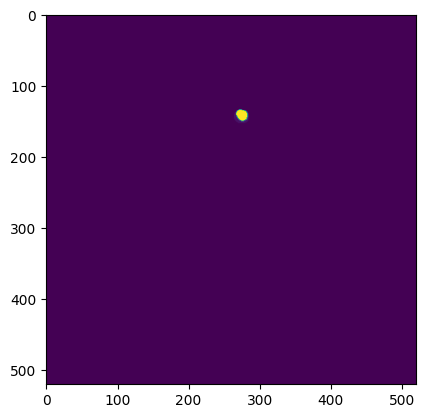

Slice number:  1


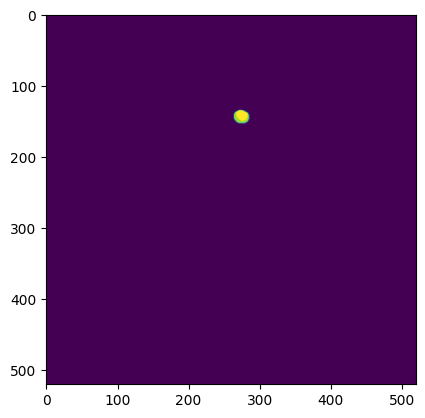

Slice number:  2


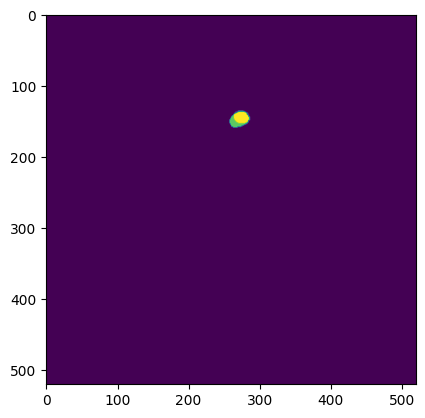

Slice number:  3


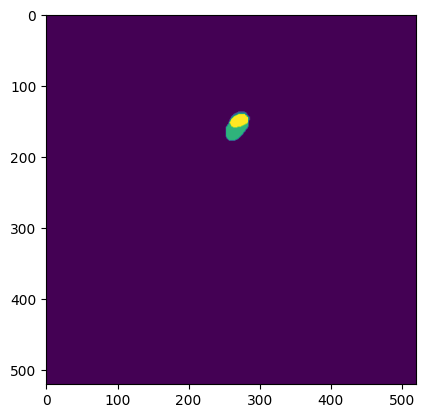

Slice number:  4


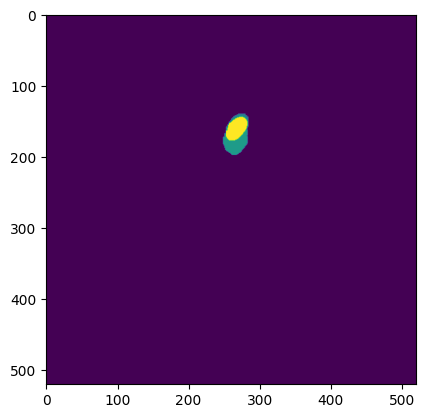

Slice number:  5


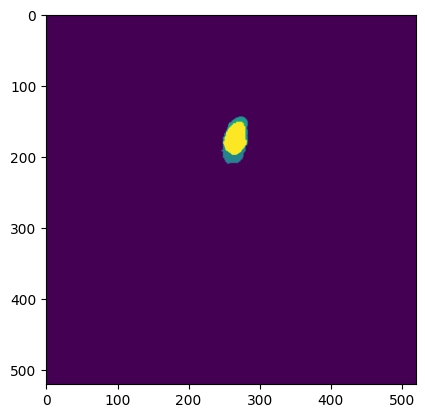

Slice number:  6


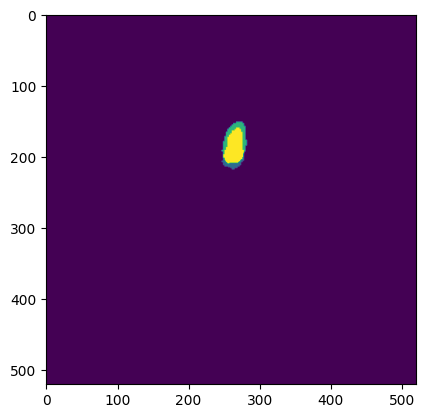

Slice number:  7


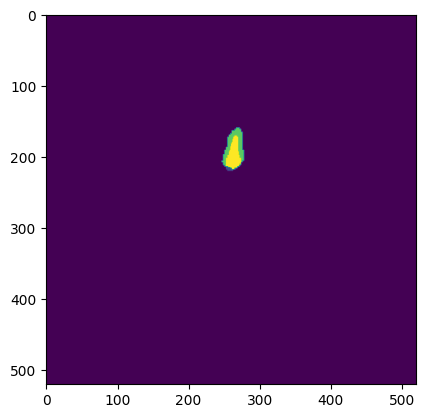

Slice number:  8


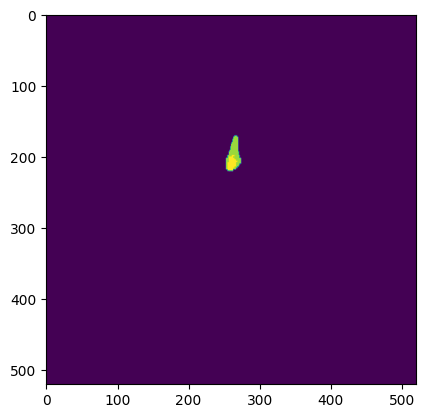

Slice number:  9


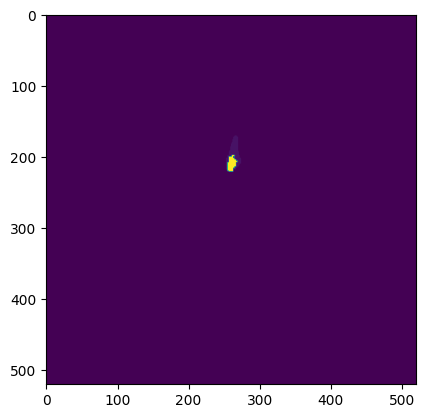

In [40]:
printSlice(ndt_new2)

## 2.2 Convert the processed images to mesh

### 2.2.1 Convert nifti files into vtk mesh
We make use of the `vtkMarchingCubes()` algorithm to generate the surface, and also other vtk modules to perform smoothing, close the openings and convert the surface to polydata.

In [41]:
import vtk

def nifti2vtk(nifti_file_input, mesh_output):
    """Converts a NIfTI image to VTK polydata.

    Args:
        nifti_file_input: The path to the NIfTI image file.
        mesh_output: The path to output the vtk mesh.

    Returns:
        output a vtk mesh to the output path
    """
    reader = vtk.vtkNIFTIImageReader()
    reader.SetFileName(nifti_file_input)
    reader.Update()

    # Create a marching cubes filter to extract the isosurface.
    contour = vtk.vtkMarchingCubes()
    contour.SetInputData(reader.GetOutput())
    contour.SetValue(0, 0.5)
    contour.Update()
    
    # close the openings before smoothing
    fill_holes = vtk.vtkFillHolesFilter()
    fill_holes.SetInputConnection(contour.GetOutputPort())
    fill_holes.SetHoleSize(5000)  # Adjust the hole size as needed
    fill_holes.Update()
    
    # Apply Laplacian smoothing to the polydata
    smoother = vtk.vtkSmoothPolyDataFilter()
    smoother.SetInputConnection(fill_holes.GetOutputPort())
    smoother.SetNumberOfIterations(100) 
    smoother.SetRelaxationFactor(0.2) 
    smoother.BoundarySmoothingOn()
    smoother.Update()
    
    # Convert the marching cubes output to polydata.
    polydata = vtk.vtkPolyData()
    polydata.DeepCopy(smoother.GetOutput())
    
    #saving the vtk file to output path
#     writer = vtkPLYWriter()
    writer = vtk.vtkPolyDataWriter()
    writer.SetFileName(mesh_output)
    writer.SetInputData(polydata)
    writer.SetFileTypeToBinary() #smaller file compared to ASCII
    writer.Write()

# #testing the function above
# input_path = "prostate_tr/amos_0001.nii.gz"
# output_path = "mesh_tr/mesh0001.vtk"

# nifti2vtk(input_path, output_path)


### 2.2.2 Perform the conversion

on training data:

In [42]:
#calling the converting to vtk over all prostate nifti

#set os path one more time to be sure
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")

#set folder name to input and output
in_folder = "version1/gb_tr"
out_folder = "version1/gb_vtk_tr"
#get item list to call functions on
item_list = os.listdir(in_folder)

#for all the item in input folder:
for i in range(len(item_list)):
    in_path = in_folder+"\\"+item_list[i]#set input path, start from folder
    out_path = os.getcwd()+"\\"+out_folder+"\\"+item_list[i][:-6]+"vtk"#set output path, full path
    nifti2vtk(in_path, out_path) #converting each nifti to mesh


on validation data:

In [43]:
#calling the converting to vtk over all prostate nifti

#set os path one more time to be sure
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")

#set folder name to input and output
in_folder = "version1/gb_va"
out_folder = "version1/gb_vtk_va"
#get item list to call functions on
item_list = os.listdir(in_folder)

#for all the item in input folder:
for i in range(len(item_list)):
    in_path = in_folder+"\\"+item_list[i]#set input path, start from folder
    out_path = os.getcwd()+"\\"+out_folder+"\\"+item_list[i][:-6]+"vtk"#set output path, full path
    nifti2vtk(in_path, out_path) #converting each nifti to mesh


a screenshot of the vtk mesh viewed in Paraview 5.11.1:

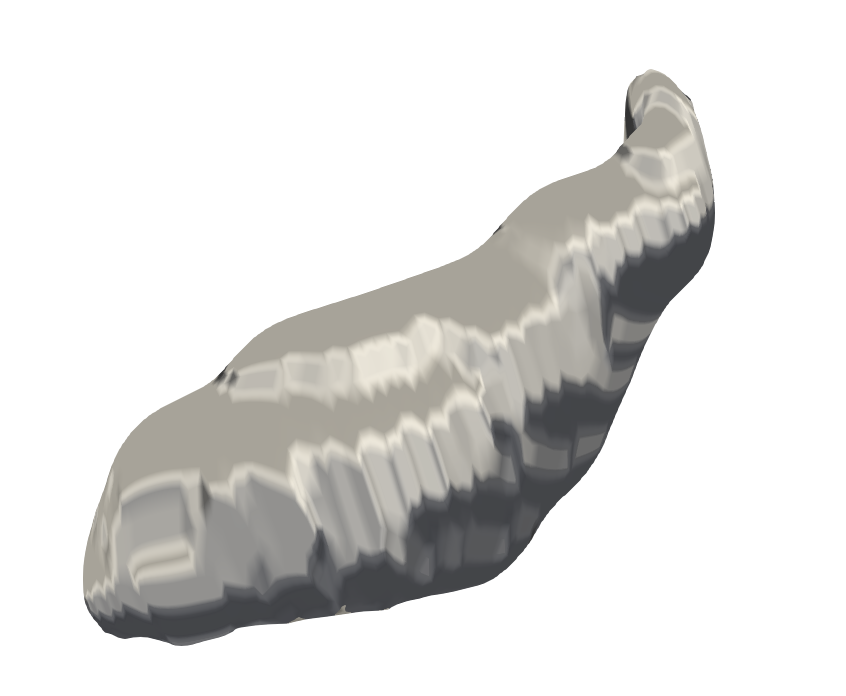

from the looks of it, vtkFillHolesFilter is doing the job, albeit the filled holes (top & bottom) does not look as nice as the other surfaces. \
One way for **future enhancement** is to create new slices on the top and bottom to close down the hole before filling it...

### 2.2.3 Convert *.vtk* mesh to *(.stl)* trimesh
this is because the `torch_geometric` we are using later have direct support for trimesh conversion to `torch_geometric` `data` object (but no such support for vtk mesh)

In [44]:
#trying the vedo library
import vedo

def vtk2stl(vtk_file, stl_file):
    #Load the VTK polygonal mesh using vedo.load()
    mesh = vedo.load(vtk_file)

    #Save the mesh as an STL file using the write() method
    mesh.write(stl_file)

# # testing the function
# vtk_file = "mesh_tr/amos_0001.vtk"
# stl_file = "trimesh_tr/amos_0001.stl"

# read_vtk_and_save_as_stl(vtk_file, stl_file)



iterating the function over all of vtk meshes to produce all trimesh meshes

In [45]:
#training labels
#calling the converting to vtk over all vtk mesh

#set os path one more time to be sure
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")

#set folder name to input and output
in_folder = "version1/gb_vtk_tr"
out_folder = "version1/gb_stl_tr"
#get item list to call functions on
item_list = os.listdir(in_folder)

#for all the item in input folder:
for i in range(len(item_list)):
    in_path = in_folder+"\\"+item_list[i]#set input path, start from folder
    out_path = os.getcwd()+"\\"+out_folder+"\\"+item_list[i][:-3]+"stl"#set output path, full path
    vtk2stl(in_path, out_path) #converting each nifti to mesh


In [46]:
#validation labels
#calling the converting to vtk over all vtk mesh

#set os path one more time to be sure
os.chdir("C:\\Users\jsl3a\Desktop\MSc Project Dataset\\nnUNet_raw\\Dataset001_amosCT")

#set folder name to input and output
in_folder = "version1/gb_vtk_va"
out_folder = "version1/gb_stl_va"
#get item list to call functions on
item_list = os.listdir(in_folder)

#for all the item in input folder:
for i in range(len(item_list)):
    in_path = in_folder+"\\"+item_list[i]#set input path, start from folder
    out_path = os.getcwd()+"\\"+out_folder+"\\"+item_list[i][:-3]+"stl"#set output path, full path
    vtk2stl(in_path, out_path) #converting each nifti to mesh


a screenshot of the stl mesh viewed in Paraview 5.11.1:

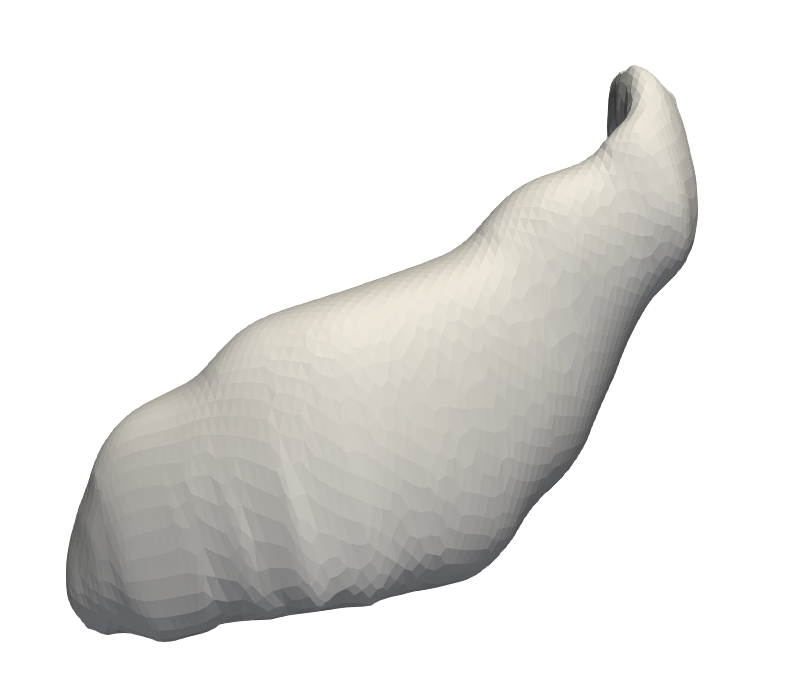

# Future Enchancement

1. ~~**[DONE]** For the resize strategy, we can opt for cropping for those prostate slices that are too tall (e.g. 15++). The cropping will (hopefully) remove the falsely segmented organs on top of prostate~~
2. To generate a smoother mesh, we can apply interpolation technique between slices. However interpolation requires continuous data, whereas the data we have is discrete, this poses a new problem
3. More regularised mesh, i.e. fixed number of nodes & edges 
4. BETTER SEGMENTATION

### Citation for FeaStNet

@inproceedings{verma2018feastnet,
  title={Feastnet: Feature-steered graph convolutions for 3d shape analysis},
  author={Verma, Nitika and Boyer, Edmond and Verbeek, Jakob},
  booktitle={Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition},
  pages={2598--2606},
  year={2018}
}

### Citation for AMOS dataset 2022

@article{ji2022amos,
  title={AMOS: A Large-Scale Abdominal Multi-Organ Benchmark for Versatile Medical Image Segmentation},
  author={Ji, Yuanfeng and Bai, Haotian and Yang, Jie and Ge, Chongjian and Zhu, Ye and Zhang, Ruimao and Li, Zhen and Zhang, Lingyan and Ma, Wanling and Wan, Xiang and others},
  journal={arXiv preprint arXiv:2206.08023},
  year={2022}
  }